In [1]:
import os
from os import listdir
from os.path import isfile, join

os.environ["CUDA_VISIBLE_DEVICES"]="4"
import pandas as pd
import torch
import torch.nn as nn
import torch.utils as utils
import torch.nn.init as init
from torch.autograd import Variable
import torchvision.utils as v_utils
import torchvision.datasets as dset
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.utils.data import Dataset
#from skimage import io
#import cv2
from PIL import Image
from collections import OrderedDict
from tqdm.notebook import tqdm as tqdm
import torchvision.utils as vutils

In [2]:
torch.cuda.get_device_name(0)

'Tesla V100-SXM2-32GB'

In [3]:
def image_check(gen_fake):
    img = gen_fake.data.numpy()
    for i in range(2):
        plt.imshow(img[i][0],cmap='gray')
        plt.show()

In [4]:
params = {
"bsize" : 256,# Batch size during training.
'imsize' : 128,# Spatial size of training images. All images will be resized to this size during preprocessing.
'nc' : 1,# Number of channles in the training images. For coloured images this is 3.
'nz' : 100,# Size of the Z latent vector (the input to the generator).
'ngf' : 256,# Size of feature maps in the generator. The depth will be multiples of this.
'ndf' : 32, # Size of features maps in the discriminator. The depth will be multiples of this.
'nepochs' : 51,# Number of training epochs.
'lr' : 0.0002,# Learning rate for optimizers
'beta1' : 0.5,# Beta1 hyperparam for Adam optimizer
'save_epoch' : 5}# Save step.

In [5]:



mean, std = [0.5], [0.5]
data_transforms = transforms.Compose([
    transforms.Resize(params['imsize']),
    transforms.CenterCrop(params['imsize']),
    transforms.Grayscale(num_output_channels=1),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

In [6]:
class gan_dataset(Dataset):
    def __init__(
            self,
            path_to_images,
            path_to_csv,
            normal = 'normal',
            transform=None,
            ):

        self.transform = transform
        self.path_to_images = path_to_images
        self.df = pd.read_csv(path_to_csv)

        if normal:
            self.df = self.df[self.df['Finding Labels'] == 'No Finding']
        else:
            self.df = self.df[self.df['Finding Labels'] != 'No Finding']
            
    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):

        image = Image.open(
            os.path.join(
                self.path_to_images,
                self.df.iloc[idx]["Image Index"]))

        
        if self.transform:
            image = self.transform(image)

        return image

In [7]:

path_to_images = "/raid/urinbayev/Chest_images/overall"
path_to_csv = "Data_Entry_2017.csv"

dataset = gan_dataset(path_to_images, path_to_csv,transform = data_transforms  )
dataloader = torch.utils.data.DataLoader(dataset,
        batch_size=params['bsize'],
        shuffle=True,
        num_workers=8)




# DCGAN

In [8]:
def weights_init(w):
    """
    Initializes the weights of the layer, w.
    """
    classname = w.__class__.__name__
    if classname.find('conv') != -1:
        nn.init.normal_(w.weight.data, 0.0, 0.02)
    elif classname.find('bn') != -1:
        nn.init.normal_(w.weight.data, 1.0, 0.02)
        nn.init.constant_(w.bias.data, 0)


class Generator(nn.Module):
    def __init__(self, params):
        super().__init__()


        self.tconv1 = nn.ConvTranspose2d(params['nz'], params['ngf']*16,
            kernel_size=4, stride=1, padding=0, bias=False)
        self.bn1 = nn.BatchNorm2d(params['ngf']*16)


        self.tconv2 = nn.ConvTranspose2d(params['ngf']*16, params['ngf']*8,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(params['ngf']*8)


        self.tconv3 = nn.ConvTranspose2d(params['ngf']*8, params['ngf']*4,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(params['ngf']*4)

   
        self.tconv4 = nn.ConvTranspose2d(params['ngf']*4, params['ngf']*2,
            4, 2, 1, bias=False)
        self.bn4 = nn.BatchNorm2d(params['ngf']*2)

        
        self.tconv5 = nn.ConvTranspose2d(params['ngf']*2, params['ngf'],
            4, 2, 1, bias=False)
        self.bn5 = nn.BatchNorm2d(params['ngf'])

        self.tconv6 = nn.ConvTranspose2d(params['ngf'], params['nc'],
            4, 2, 1, bias=False)


    def forward(self, x):
        x = F.relu(self.bn1(self.tconv1(x)))
        x = F.relu(self.bn2(self.tconv2(x)))
        x = F.relu(self.bn3(self.tconv3(x)))
        x = F.relu(self.bn4(self.tconv4(x)))
        x = F.relu(self.bn5(self.tconv5(x)))
        x = F.tanh(self.tconv6(x))

        return x

# Define the Discriminator Network
class Discriminator(nn.Module):
    def __init__(self, params):
        super().__init__()

      
        self.conv1 = nn.Conv2d(params['nc'], params['ndf'],
            4, 2, 1, bias=False)

    
        self.conv2 = nn.Conv2d(params['ndf'], params['ndf']*2,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(params['ndf']*2)

       
        self.conv3 = nn.Conv2d(params['ndf']*2, params['ndf']*4,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(params['ndf']*4)

    
        self.conv4 = nn.Conv2d(params['ndf']*4, params['ndf']*8,
            4, 2, 1, bias=False)
        self.bn4 = nn.BatchNorm2d(params['ndf']*8)

   
        self.conv5 = nn.Conv2d(params['ndf']*8,params['ndf']*16, 4, 2, 1,  bias=False)
        self.bn5 = nn.BatchNorm2d(params['ndf']*16)
        
        self.conv6 =  nn.Conv2d(params['ndf']*16, 1, 4, 1, 0, bias=False)
    def forward(self, x):
        x = F.leaky_relu(self.conv1(x), 0.2, True)
        x = F.leaky_relu(self.bn2(self.conv2(x)), 0.2, True)
        x = F.leaky_relu(self.bn3(self.conv3(x)), 0.2, True)
        x = F.leaky_relu(self.bn4(self.conv4(x)), 0.2, True)
        feature = F.leaky_relu(self.bn5(self.conv5(x)), 0.2, True)
        x = torch.sigmoid(self.conv6(feature))

        return x, feature

In [9]:
device = torch.device("cuda:0" if(torch.cuda.is_available()) else "cpu")
netG = Generator(params).to(device)
# Apply the weights_init() function to randomly initialize all
# weights to mean=0.0, stddev=0.2
netG.apply(weights_init)
print(netG)

netD = Discriminator(params).to(device)
# Apply the weights_init() function to randomly initialize all
# weights to mean=0.0, stddev=0.2
netD.apply(weights_init)
print(netD)

criterion = nn.BCELoss()

fixed_noise = torch.randn(64, params['nz'], 1, 1, device=device)

real_label = 1
fake_label = 0

optimizerD = torch.optim.Adam(netD.parameters(), lr=params['lr'], betas=(params['beta1'], 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=params['lr'], betas=(params['beta1'], 0.999))

img_list = []
G_losses = []
D_losses = []

iters = 0

Generator(
  (tconv1): ConvTranspose2d(100, 4096, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (bn1): BatchNorm2d(4096, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (tconv2): ConvTranspose2d(4096, 2048, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (tconv3): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn3): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (tconv4): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (tconv5): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (tconv6): ConvTranspose2d(256, 1, kerne

In [10]:

# load_model = torch.load('model/model.pth')
# netG.load_state_dict(load_model["generator"])
# netD.load_state_dict(load_model["discriminator"])
# optimizerG.load_state_dict(load_model["optimizerG"])
# optimizerD.load_state_dict(load_model["optimizerD"])

/home/urinbayev/.local/lib/python3.7/site-packages/torch/nn/functional.py:1340: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


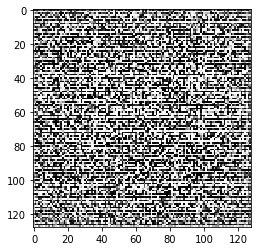

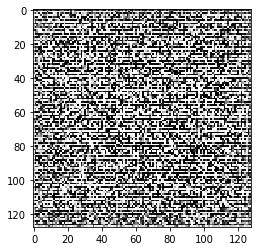

In [11]:
noise = torch.randn(7, params['nz'], 1, 1, device=device)
       
fake_data = netG(noise)
image_check(fake_data.cpu())

Starting Training Loop...
-------------------------


True


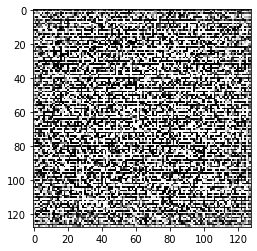

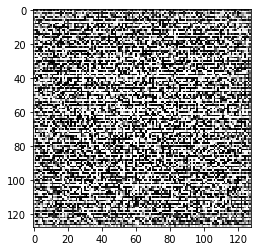

[0/51][0/236]	Loss_D: 1.3079	Loss_G: 1.7991	D(x): 0.5219	D(G(z)): 0.4666 / 0.1734
True


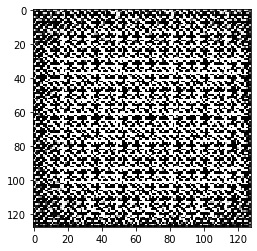

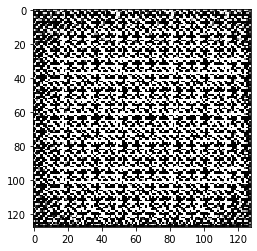

[0/51][20/236]	Loss_D: 0.0537	Loss_G: 6.1647	D(x): 0.9806	D(G(z)): 0.0196 / 0.0021
True


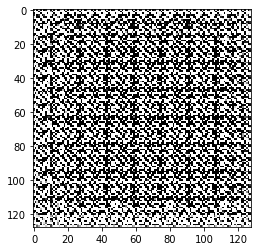

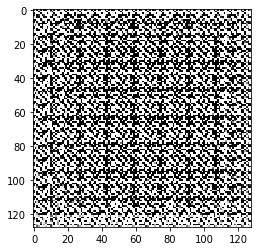

[0/51][40/236]	Loss_D: 0.0195	Loss_G: 7.0415	D(x): 0.9933	D(G(z)): 0.0123 / 0.0009
True


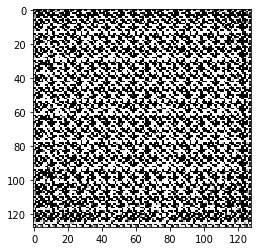

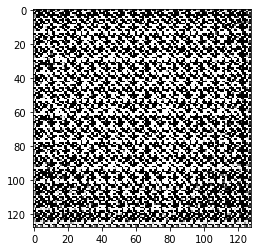

[0/51][60/236]	Loss_D: 0.0172	Loss_G: 7.1746	D(x): 0.9943	D(G(z)): 0.0111 / 0.0008
True


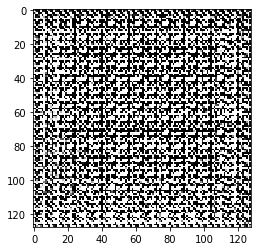

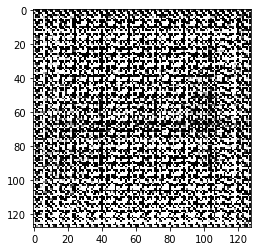

[0/51][80/236]	Loss_D: 0.0221	Loss_G: 7.9517	D(x): 0.9903	D(G(z)): 0.0118 / 0.0004
True


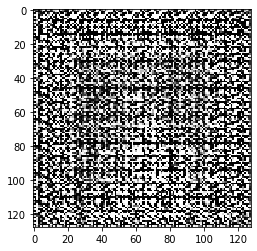

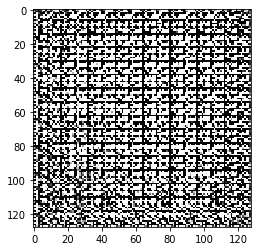

[0/51][100/236]	Loss_D: 0.0182	Loss_G: 7.3390	D(x): 0.9923	D(G(z)): 0.0100 / 0.0007
True


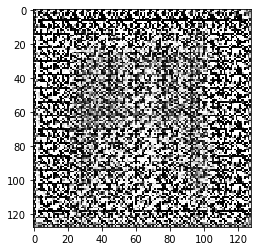

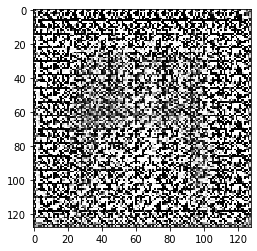

[0/51][120/236]	Loss_D: 0.0127	Loss_G: 8.4237	D(x): 0.9910	D(G(z)): 0.0027 / 0.0002
True


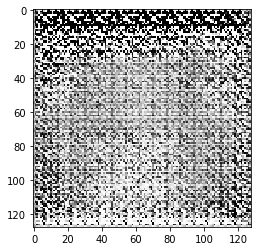

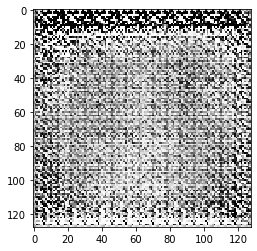

[0/51][140/236]	Loss_D: 0.0930	Loss_G: 15.9826	D(x): 0.9931	D(G(z)): 0.0781 / 0.0000
True


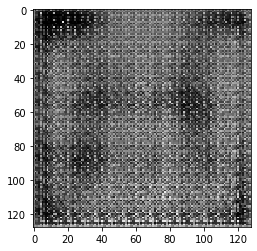

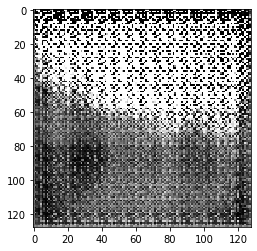

[0/51][160/236]	Loss_D: 0.0537	Loss_G: 5.1840	D(x): 0.9843	D(G(z)): 0.0213 / 0.0221
True


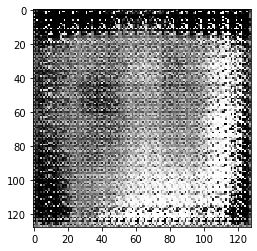

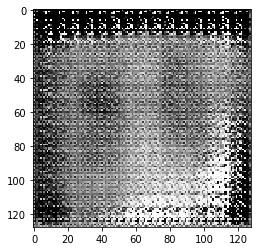

[0/51][180/236]	Loss_D: 2.6317	Loss_G: 2.1756	D(x): 0.2137	D(G(z)): 0.0079 / 0.1620
True


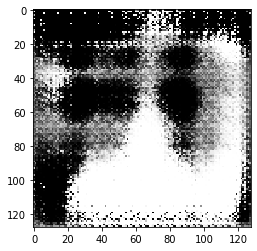

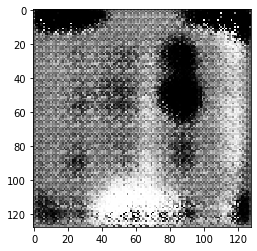

[0/51][200/236]	Loss_D: 1.6774	Loss_G: 3.7321	D(x): 0.5262	D(G(z)): 0.4406 / 0.0333
True


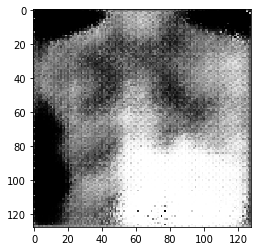

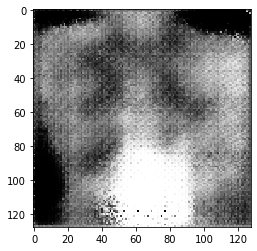

[0/51][220/236]	Loss_D: 1.7916	Loss_G: 1.0204	D(x): 0.3176	D(G(z)): 0.3493 / 0.3996



True


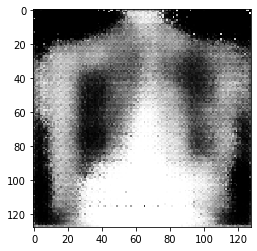

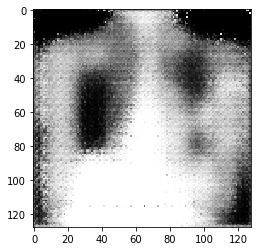

[1/51][0/236]	Loss_D: 1.4178	Loss_G: 1.5366	D(x): 0.5412	D(G(z)): 0.5140 / 0.2339
True


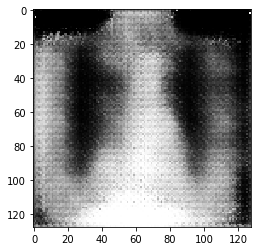

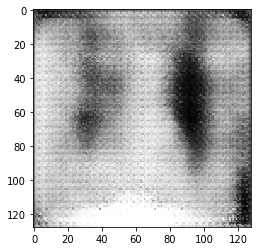

[1/51][20/236]	Loss_D: 1.2685	Loss_G: 1.2654	D(x): 0.5320	D(G(z)): 0.4452 / 0.3015
True


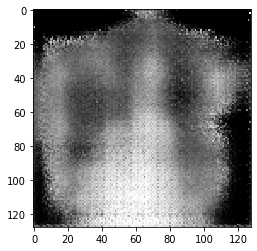

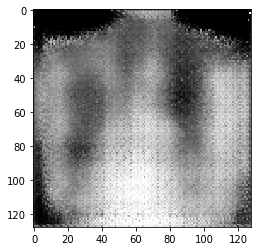

[1/51][40/236]	Loss_D: 1.4735	Loss_G: 0.9486	D(x): 0.5123	D(G(z)): 0.5189 / 0.4049
True


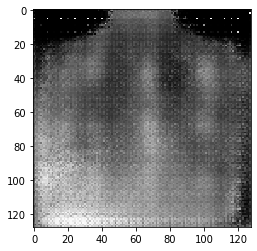

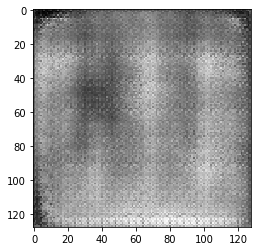

[1/51][60/236]	Loss_D: 1.4462	Loss_G: 0.9625	D(x): 0.5190	D(G(z)): 0.4810 / 0.4013
True


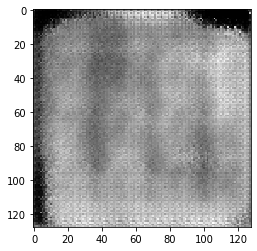

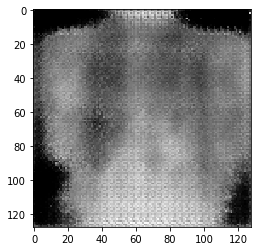

[1/51][80/236]	Loss_D: 1.3254	Loss_G: 1.0082	D(x): 0.5099	D(G(z)): 0.4485 / 0.3801
True


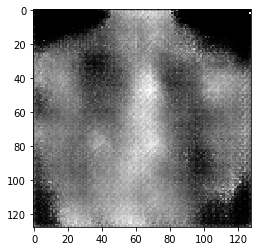

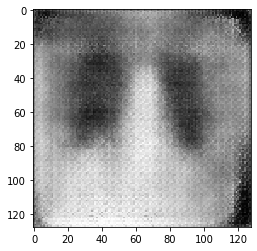

[1/51][100/236]	Loss_D: 1.1574	Loss_G: 1.4006	D(x): 0.5803	D(G(z)): 0.4178 / 0.2714
True


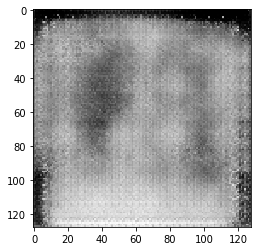

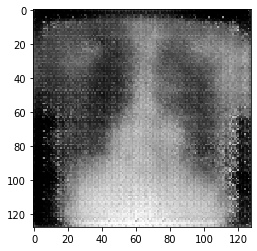

[1/51][120/236]	Loss_D: 1.1500	Loss_G: 1.2575	D(x): 0.5627	D(G(z)): 0.4107 / 0.2963
True


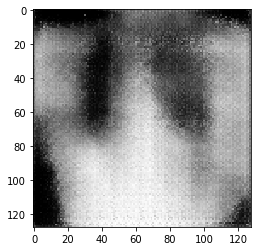

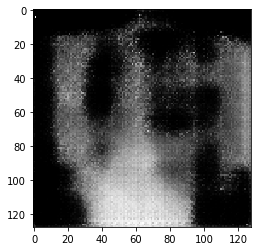

[1/51][140/236]	Loss_D: 1.4383	Loss_G: 1.0235	D(x): 0.5045	D(G(z)): 0.5041 / 0.3745
True


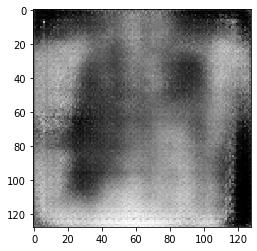

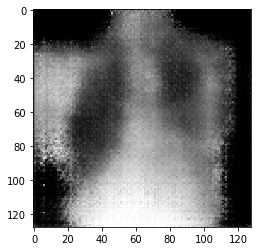

[1/51][160/236]	Loss_D: 1.3329	Loss_G: 1.0641	D(x): 0.5184	D(G(z)): 0.4608 / 0.3590
True


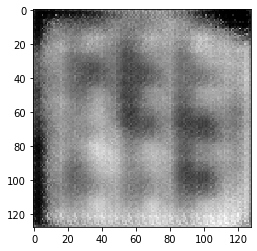

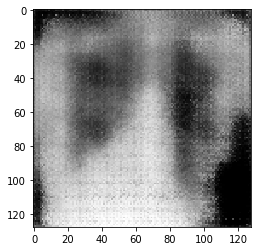

[1/51][180/236]	Loss_D: 1.4542	Loss_G: 1.1561	D(x): 0.5162	D(G(z)): 0.5166 / 0.3303
True


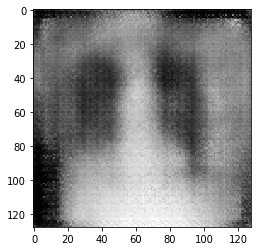

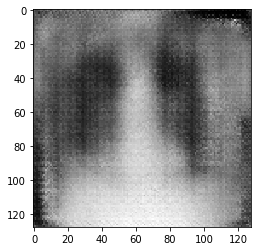

[1/51][200/236]	Loss_D: 1.1531	Loss_G: 1.0761	D(x): 0.5739	D(G(z)): 0.4287 / 0.3544
True


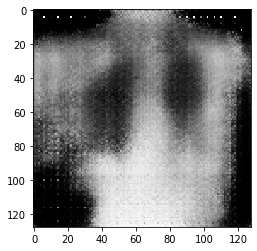

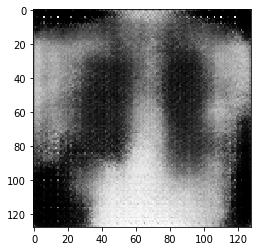

[1/51][220/236]	Loss_D: 1.3373	Loss_G: 1.1969	D(x): 0.5742	D(G(z)): 0.5258 / 0.3156



True


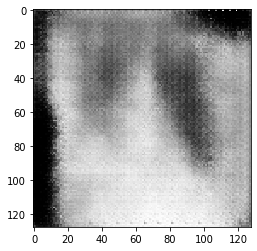

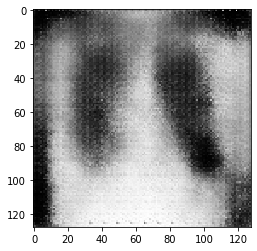

[2/51][0/236]	Loss_D: 1.2751	Loss_G: 1.0747	D(x): 0.5175	D(G(z)): 0.4311 / 0.3559
True


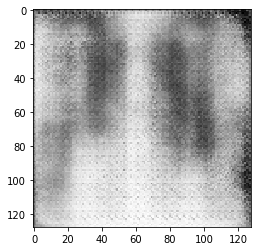

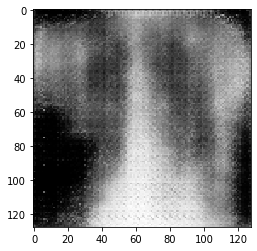

[2/51][20/236]	Loss_D: 1.2236	Loss_G: 1.4290	D(x): 0.5968	D(G(z)): 0.4700 / 0.2558
True


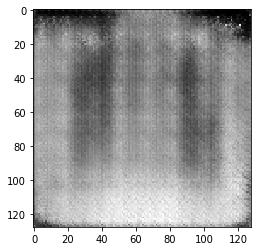

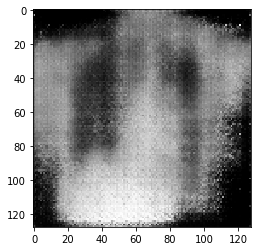

[2/51][40/236]	Loss_D: 1.1675	Loss_G: 1.2607	D(x): 0.5774	D(G(z)): 0.4220 / 0.3066
True


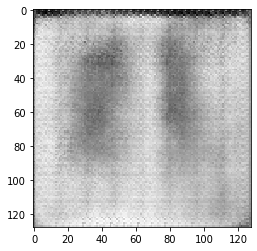

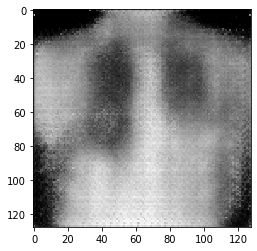

[2/51][60/236]	Loss_D: 1.2041	Loss_G: 0.9887	D(x): 0.5949	D(G(z)): 0.4639 / 0.3955
True


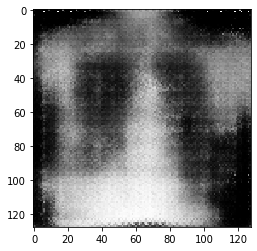

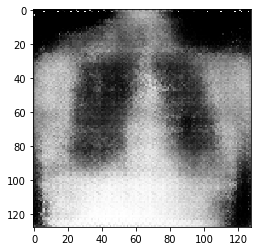

[2/51][80/236]	Loss_D: 1.5227	Loss_G: 0.7736	D(x): 0.4346	D(G(z)): 0.4478 / 0.4802
True


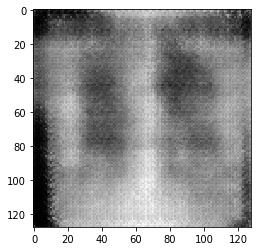

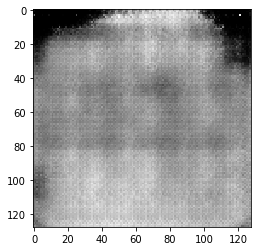

[2/51][100/236]	Loss_D: 1.3919	Loss_G: 0.8093	D(x): 0.3694	D(G(z)): 0.2547 / 0.4596
True


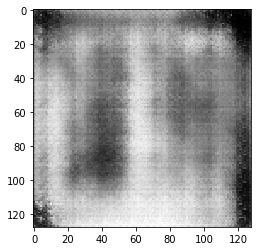

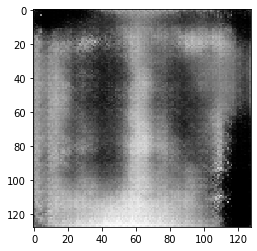

[2/51][120/236]	Loss_D: 1.1580	Loss_G: 1.7466	D(x): 0.5952	D(G(z)): 0.4331 / 0.1941
True


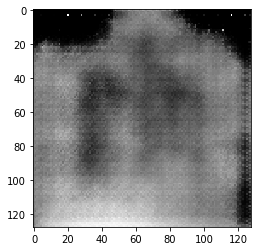

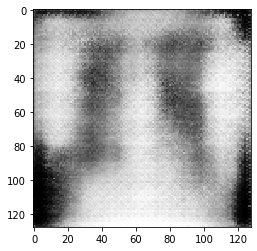

[2/51][140/236]	Loss_D: 1.2820	Loss_G: 1.1570	D(x): 0.5432	D(G(z)): 0.4609 / 0.3296
True


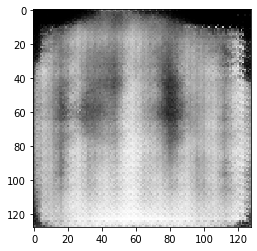

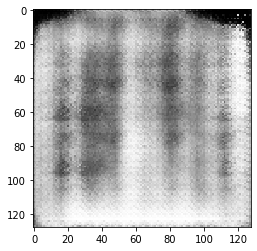

[2/51][160/236]	Loss_D: 1.1470	Loss_G: 1.3610	D(x): 0.5205	D(G(z)): 0.3420 / 0.2706
True


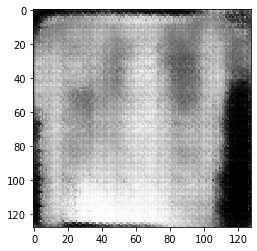

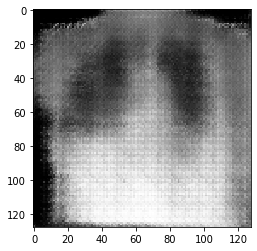

[2/51][180/236]	Loss_D: 1.4022	Loss_G: 1.0218	D(x): 0.4894	D(G(z)): 0.4623 / 0.3831
True


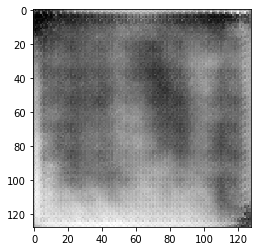

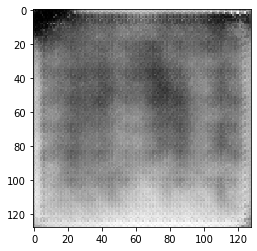

[2/51][200/236]	Loss_D: 1.5516	Loss_G: 1.8630	D(x): 0.6718	D(G(z)): 0.6642 / 0.1668
True


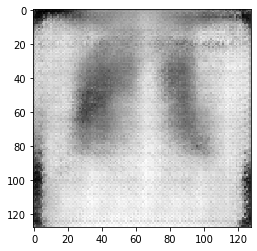

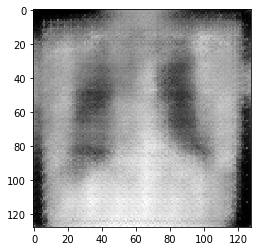

[2/51][220/236]	Loss_D: 1.1632	Loss_G: 1.1341	D(x): 0.5559	D(G(z)): 0.3968 / 0.3369



True


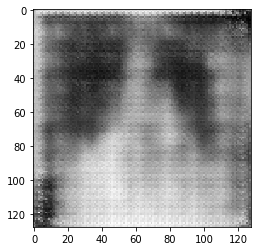

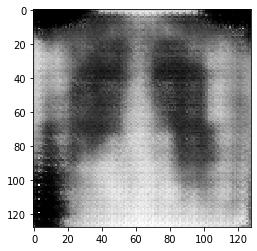

[3/51][0/236]	Loss_D: 1.4153	Loss_G: 1.2941	D(x): 0.3573	D(G(z)): 0.2571 / 0.2980
True


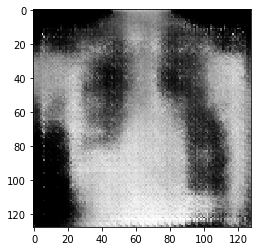

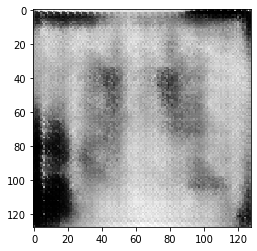

[3/51][20/236]	Loss_D: 1.1438	Loss_G: 1.6375	D(x): 0.5994	D(G(z)): 0.4300 / 0.2185
True


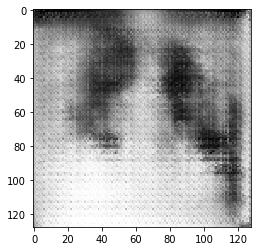

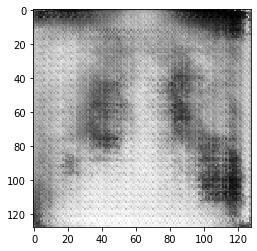

[3/51][40/236]	Loss_D: 1.2341	Loss_G: 1.1169	D(x): 0.4525	D(G(z)): 0.3160 / 0.3370
True


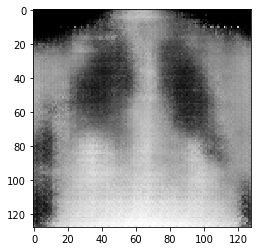

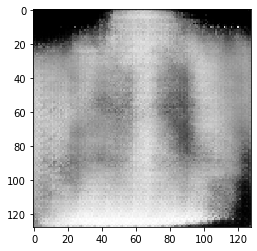

[3/51][60/236]	Loss_D: 1.0944	Loss_G: 1.3563	D(x): 0.5966	D(G(z)): 0.3997 / 0.2811
True


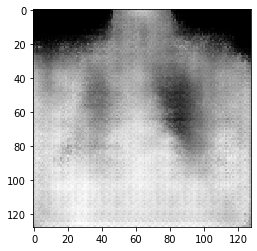

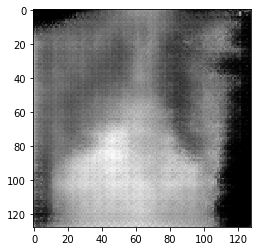

[3/51][80/236]	Loss_D: 1.1167	Loss_G: 1.4184	D(x): 0.6554	D(G(z)): 0.4810 / 0.2542
True


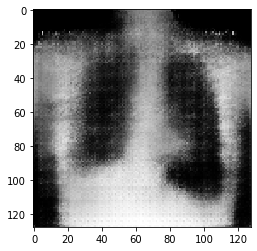

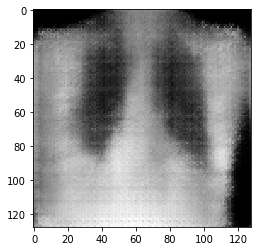

[3/51][100/236]	Loss_D: 1.1694	Loss_G: 1.3550	D(x): 0.6151	D(G(z)): 0.4732 / 0.2723
True


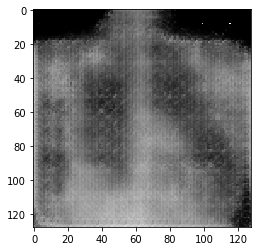

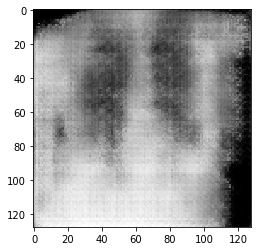

[3/51][120/236]	Loss_D: 1.2921	Loss_G: 1.4031	D(x): 0.5523	D(G(z)): 0.4672 / 0.2659
True


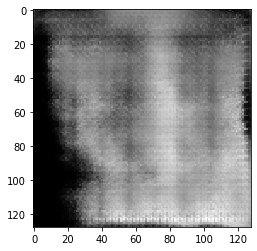

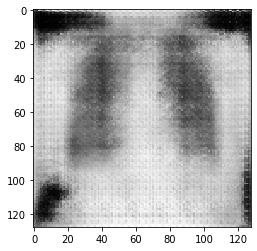

[3/51][140/236]	Loss_D: 1.4024	Loss_G: 0.8799	D(x): 0.4068	D(G(z)): 0.3566 / 0.4296
True


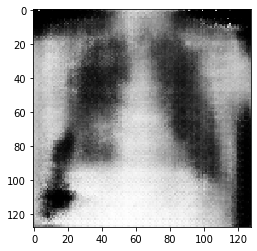

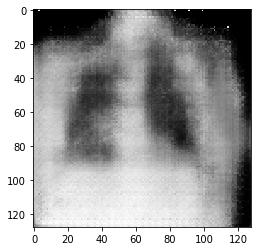

[3/51][160/236]	Loss_D: 1.3674	Loss_G: 1.0195	D(x): 0.5004	D(G(z)): 0.4520 / 0.3752
True


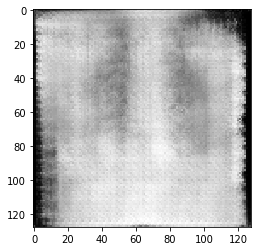

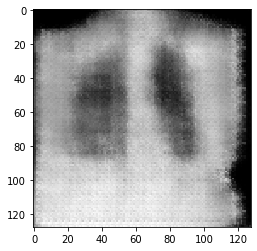

[3/51][180/236]	Loss_D: 1.3884	Loss_G: 1.4548	D(x): 0.6312	D(G(z)): 0.5672 / 0.2581
True


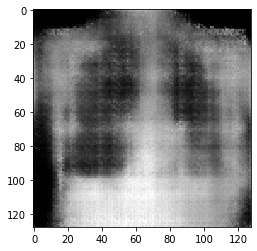

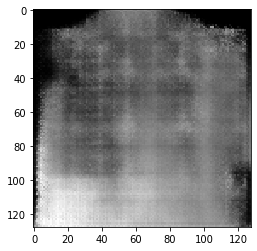

[3/51][200/236]	Loss_D: 1.2617	Loss_G: 1.0677	D(x): 0.5317	D(G(z)): 0.4398 / 0.3573
True


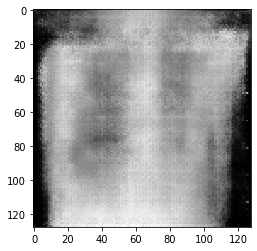

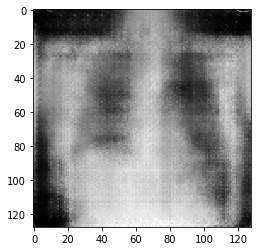

[3/51][220/236]	Loss_D: 1.3384	Loss_G: 1.1381	D(x): 0.4986	D(G(z)): 0.4479 / 0.3334



True


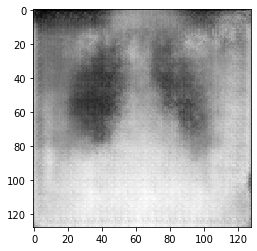

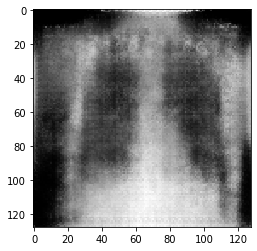

[4/51][0/236]	Loss_D: 1.3385	Loss_G: 0.9822	D(x): 0.5732	D(G(z)): 0.5239 / 0.3848
True


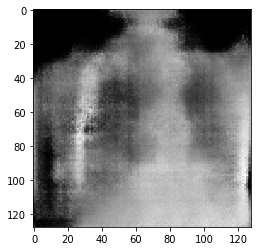

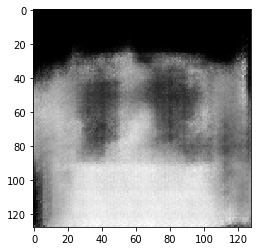

[4/51][20/236]	Loss_D: 1.4032	Loss_G: 1.0830	D(x): 0.5497	D(G(z)): 0.5319 / 0.3527
True


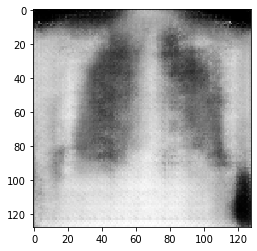

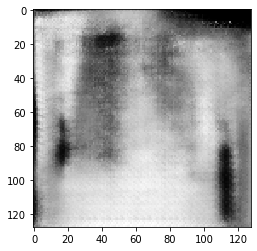

[4/51][40/236]	Loss_D: 1.4405	Loss_G: 0.7522	D(x): 0.4137	D(G(z)): 0.4019 / 0.4822
True


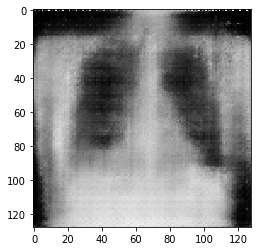

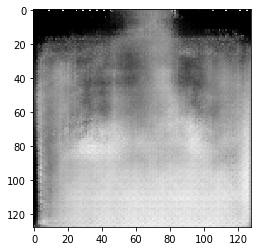

[4/51][60/236]	Loss_D: 1.3911	Loss_G: 1.1067	D(x): 0.5211	D(G(z)): 0.5086 / 0.3414
True


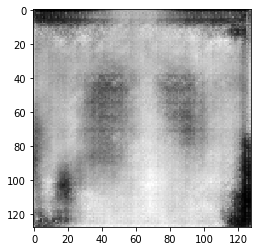

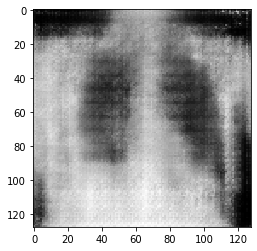

[4/51][80/236]	Loss_D: 1.2840	Loss_G: 1.0083	D(x): 0.5424	D(G(z)): 0.4709 / 0.3776
True


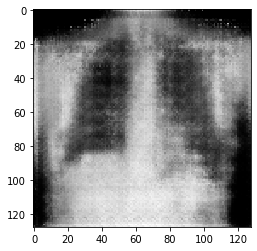

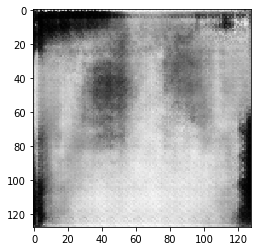

[4/51][100/236]	Loss_D: 1.2087	Loss_G: 1.2037	D(x): 0.5635	D(G(z)): 0.4505 / 0.3164
True


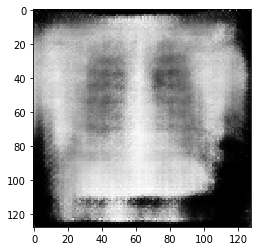

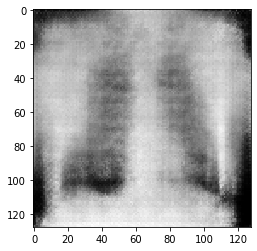

[4/51][120/236]	Loss_D: 1.2056	Loss_G: 1.0646	D(x): 0.5188	D(G(z)): 0.4030 / 0.3549
True


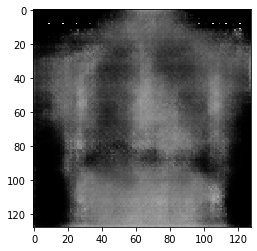

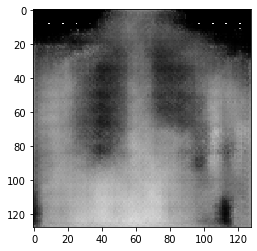

[4/51][140/236]	Loss_D: 1.2890	Loss_G: 1.0920	D(x): 0.4982	D(G(z)): 0.4315 / 0.3488
True


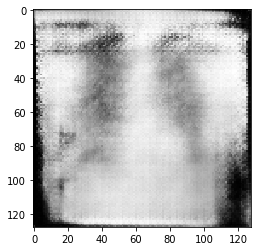

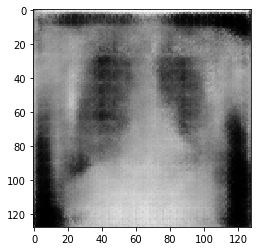

[4/51][160/236]	Loss_D: 1.3860	Loss_G: 1.4570	D(x): 0.6238	D(G(z)): 0.5838 / 0.2513
True


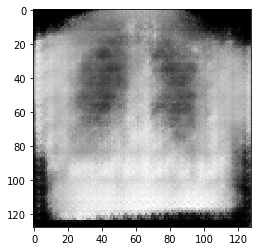

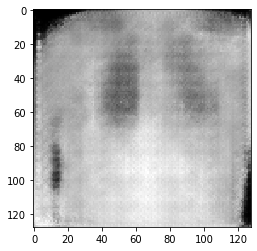

[4/51][180/236]	Loss_D: 1.2911	Loss_G: 0.9858	D(x): 0.4836	D(G(z)): 0.4090 / 0.3855
True


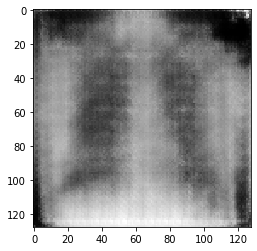

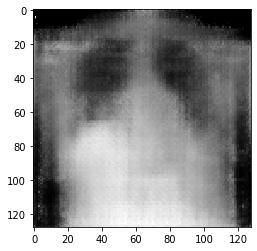

[4/51][200/236]	Loss_D: 1.3329	Loss_G: 0.8648	D(x): 0.4596	D(G(z)): 0.4084 / 0.4290
True


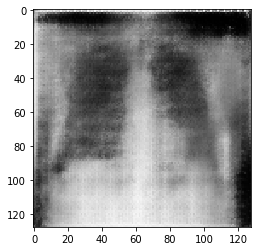

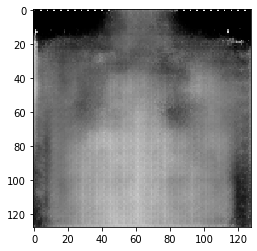

[4/51][220/236]	Loss_D: 1.4339	Loss_G: 1.0179	D(x): 0.4873	D(G(z)): 0.4889 / 0.3709



True


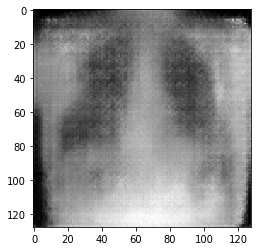

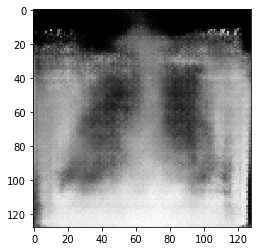

[5/51][0/236]	Loss_D: 1.3525	Loss_G: 1.1620	D(x): 0.6213	D(G(z)): 0.5677 / 0.3240
True


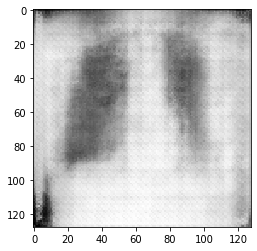

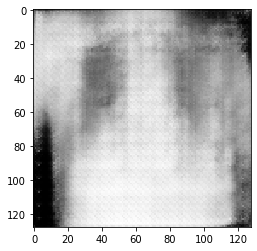

[5/51][20/236]	Loss_D: 1.3102	Loss_G: 1.0397	D(x): 0.6558	D(G(z)): 0.5732 / 0.3647
True


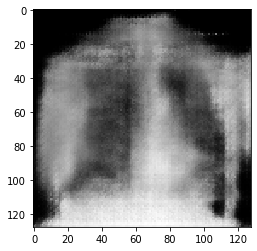

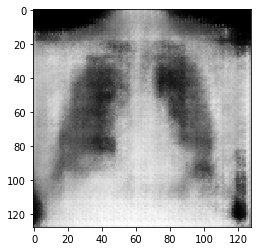

[5/51][40/236]	Loss_D: 1.3626	Loss_G: 0.7760	D(x): 0.4121	D(G(z)): 0.3510 / 0.4690
True


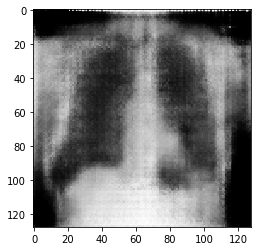

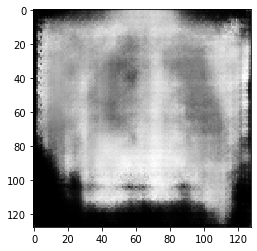

[5/51][60/236]	Loss_D: 1.2883	Loss_G: 1.0828	D(x): 0.5378	D(G(z)): 0.4664 / 0.3527
True


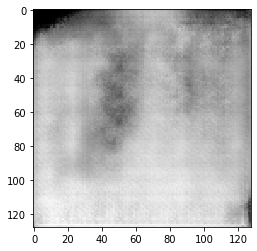

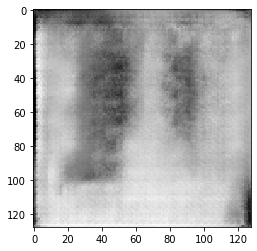

[5/51][80/236]	Loss_D: 1.2778	Loss_G: 1.0705	D(x): 0.5688	D(G(z)): 0.4945 / 0.3523
True


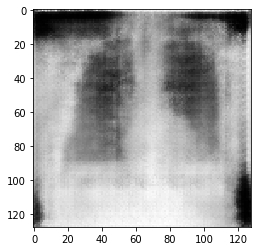

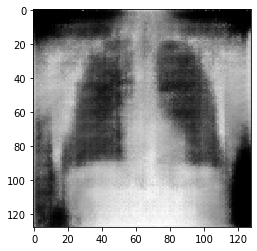

[5/51][100/236]	Loss_D: 1.3172	Loss_G: 1.1616	D(x): 0.5514	D(G(z)): 0.4990 / 0.3184
True


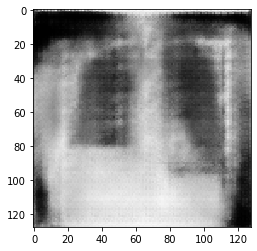

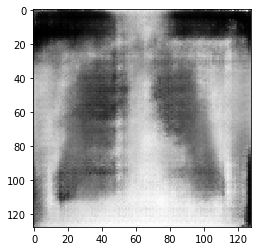

[5/51][120/236]	Loss_D: 1.3015	Loss_G: 1.1457	D(x): 0.5334	D(G(z)): 0.4762 / 0.3277
True


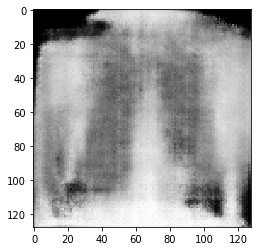

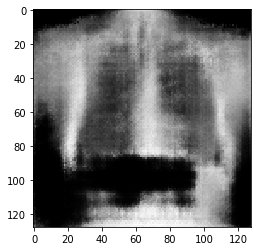

[5/51][140/236]	Loss_D: 1.3472	Loss_G: 0.9789	D(x): 0.5268	D(G(z)): 0.4914 / 0.3845
True


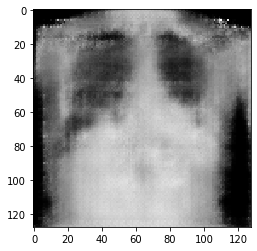

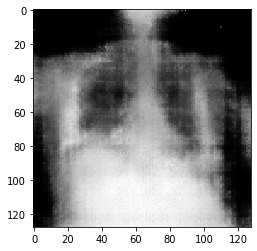

[5/51][160/236]	Loss_D: 1.2356	Loss_G: 1.2177	D(x): 0.6122	D(G(z)): 0.5089 / 0.3085
True


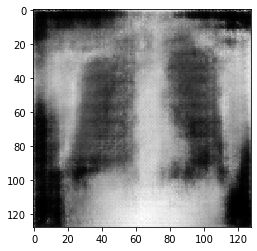

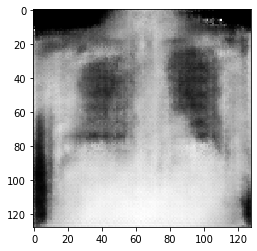

[5/51][180/236]	Loss_D: 1.3205	Loss_G: 0.9072	D(x): 0.4535	D(G(z)): 0.3881 / 0.4120
True


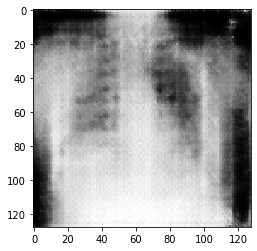

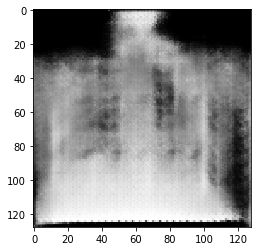

[5/51][200/236]	Loss_D: 1.3005	Loss_G: 0.9629	D(x): 0.5146	D(G(z)): 0.4557 / 0.3902
True


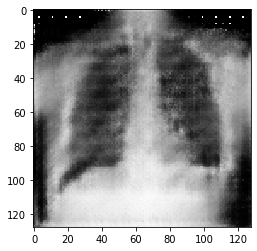

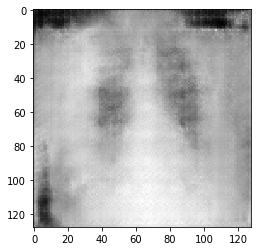

[5/51][220/236]	Loss_D: 1.3753	Loss_G: 1.1917	D(x): 0.5187	D(G(z)): 0.4937 / 0.3145



True


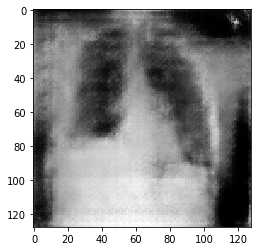

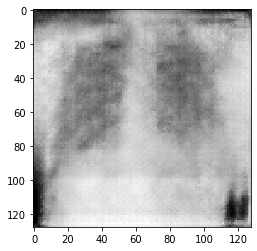

[6/51][0/236]	Loss_D: 1.3720	Loss_G: 0.8226	D(x): 0.4028	D(G(z)): 0.3465 / 0.4489
True


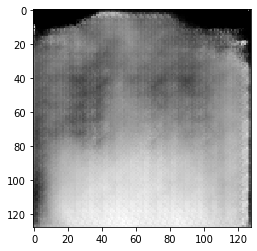

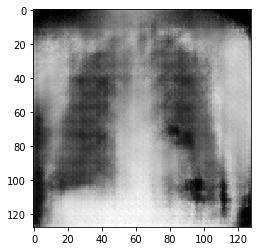

[6/51][20/236]	Loss_D: 1.1925	Loss_G: 1.0652	D(x): 0.5396	D(G(z)): 0.4247 / 0.3545
True


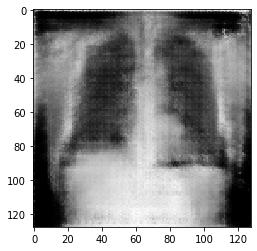

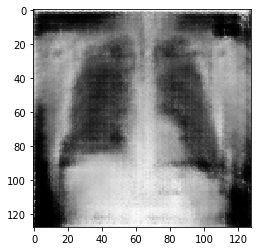

[6/51][40/236]	Loss_D: 1.4342	Loss_G: 1.3031	D(x): 0.5761	D(G(z)): 0.5667 / 0.2916
True


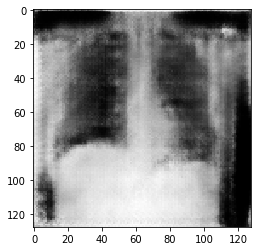

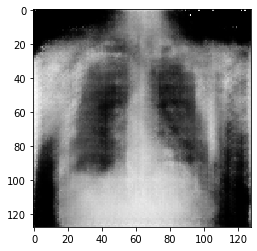

[6/51][60/236]	Loss_D: 1.2395	Loss_G: 1.2117	D(x): 0.5596	D(G(z)): 0.4675 / 0.3086
True


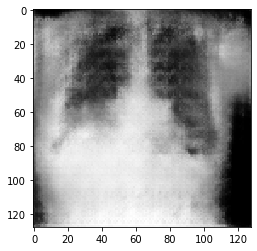

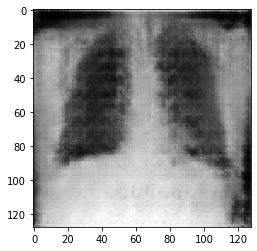

[6/51][80/236]	Loss_D: 1.2936	Loss_G: 0.9197	D(x): 0.5139	D(G(z)): 0.4477 / 0.4096
True


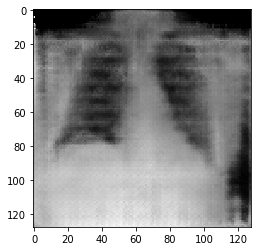

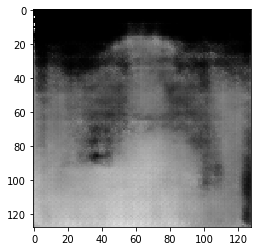

[6/51][100/236]	Loss_D: 1.2450	Loss_G: 1.0117	D(x): 0.5069	D(G(z)): 0.4172 / 0.3705
True


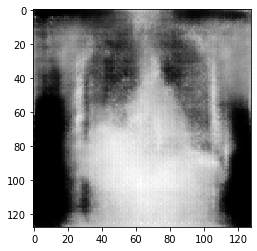

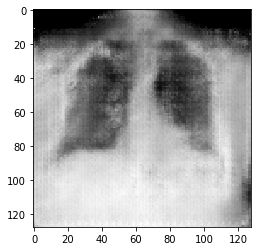

[6/51][120/236]	Loss_D: 1.3567	Loss_G: 1.2315	D(x): 0.6070	D(G(z)): 0.5609 / 0.3037
True


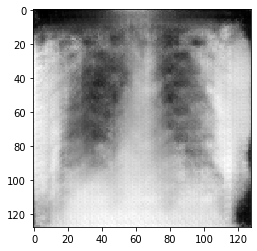

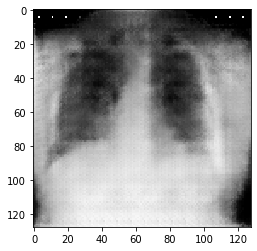

[6/51][140/236]	Loss_D: 1.3160	Loss_G: 1.0077	D(x): 0.5361	D(G(z)): 0.4845 / 0.3748
True


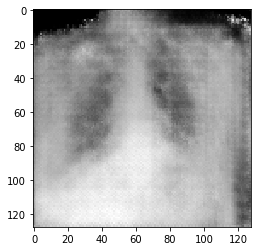

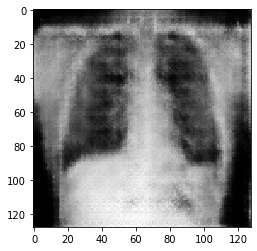

[6/51][160/236]	Loss_D: 1.3652	Loss_G: 0.9978	D(x): 0.5247	D(G(z)): 0.4975 / 0.3790
True


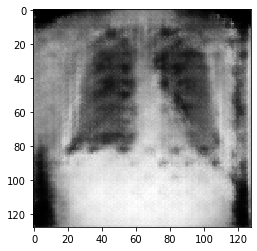

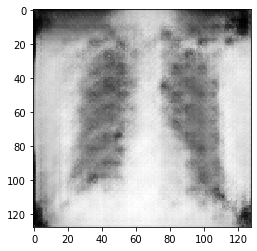

[6/51][180/236]	Loss_D: 1.3552	Loss_G: 1.2374	D(x): 0.5692	D(G(z)): 0.5277 / 0.3058
True


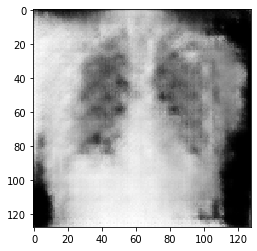

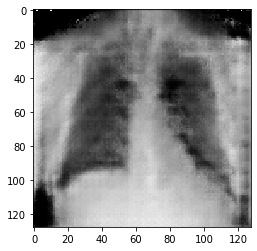

[6/51][200/236]	Loss_D: 1.3430	Loss_G: 1.3026	D(x): 0.5757	D(G(z)): 0.5278 / 0.2909
True


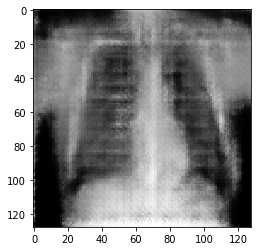

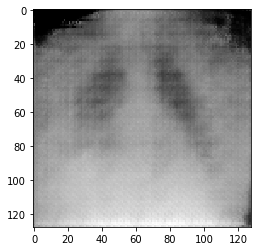

[6/51][220/236]	Loss_D: 1.4107	Loss_G: 0.8715	D(x): 0.4763	D(G(z)): 0.4669 / 0.4249



True


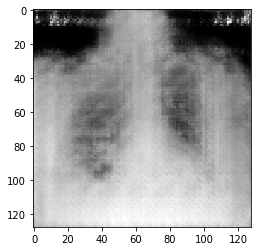

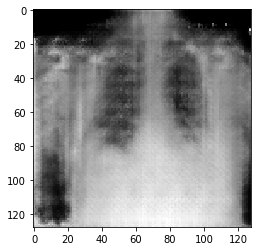

[7/51][0/236]	Loss_D: 1.3004	Loss_G: 0.9767	D(x): 0.5004	D(G(z)): 0.4415 / 0.3859
True


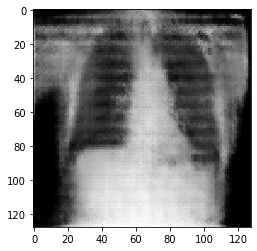

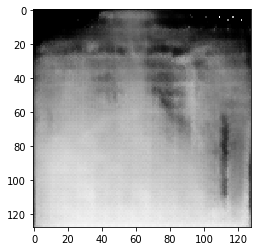

[7/51][20/236]	Loss_D: 1.2520	Loss_G: 1.0704	D(x): 0.5664	D(G(z)): 0.4833 / 0.3503
True


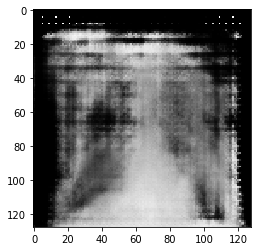

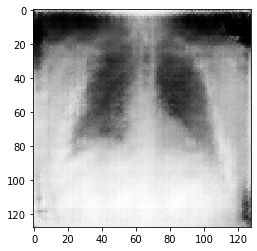

[7/51][40/236]	Loss_D: 1.3068	Loss_G: 0.9039	D(x): 0.4763	D(G(z)): 0.4124 / 0.4149
True


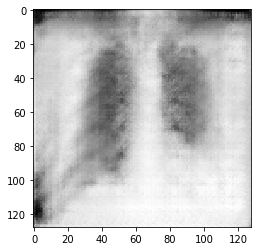

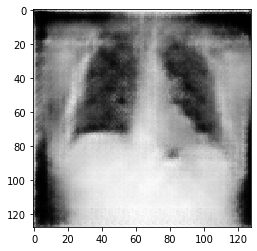

[7/51][60/236]	Loss_D: 1.3212	Loss_G: 0.9671	D(x): 0.5822	D(G(z)): 0.5276 / 0.3888
True


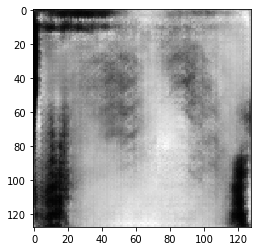

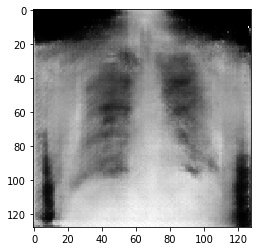

[7/51][80/236]	Loss_D: 1.4076	Loss_G: 0.7534	D(x): 0.3922	D(G(z)): 0.3530 / 0.4815
True


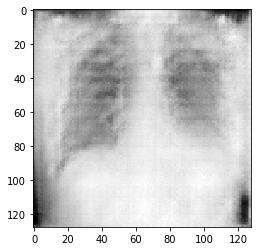

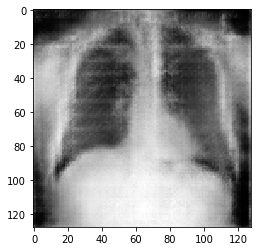

[7/51][100/236]	Loss_D: 1.3876	Loss_G: 0.7190	D(x): 0.4199	D(G(z)): 0.3875 / 0.4941
True


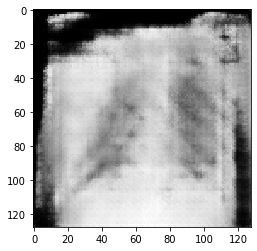

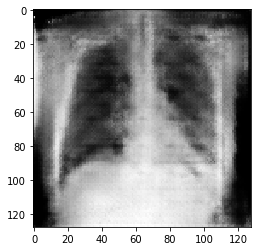

[7/51][120/236]	Loss_D: 1.3290	Loss_G: 1.0287	D(x): 0.5747	D(G(z)): 0.5279 / 0.3654
True


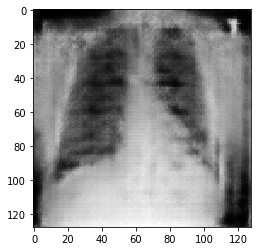

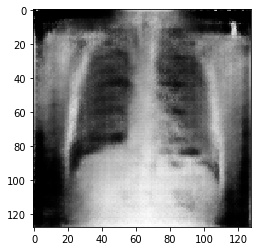

[7/51][140/236]	Loss_D: 1.3500	Loss_G: 0.9699	D(x): 0.5154	D(G(z)): 0.4838 / 0.3873
True


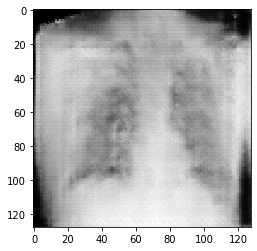

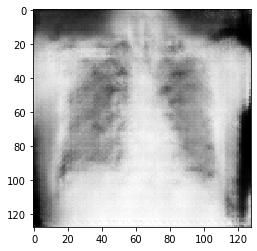

[7/51][160/236]	Loss_D: 1.2867	Loss_G: 0.9129	D(x): 0.5040	D(G(z)): 0.4300 / 0.4124
True


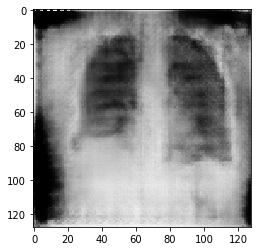

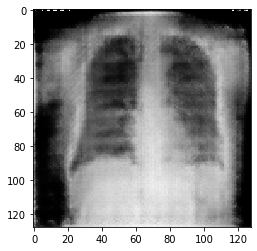

[7/51][180/236]	Loss_D: 1.3356	Loss_G: 0.9553	D(x): 0.4836	D(G(z)): 0.4424 / 0.3911
True


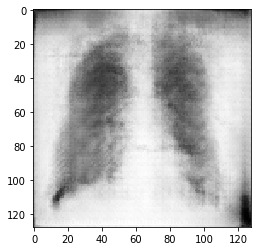

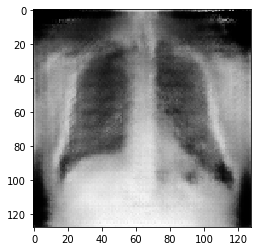

[7/51][200/236]	Loss_D: 1.2783	Loss_G: 0.8553	D(x): 0.5178	D(G(z)): 0.4480 / 0.4346
True


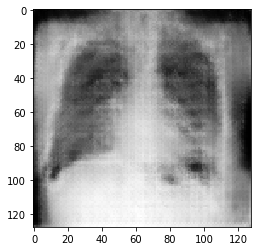

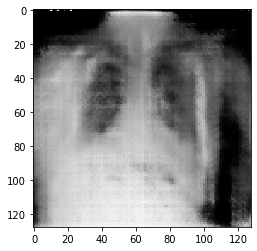

[7/51][220/236]	Loss_D: 1.3211	Loss_G: 1.0918	D(x): 0.5497	D(G(z)): 0.5024 / 0.3409



True


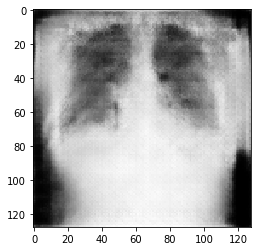

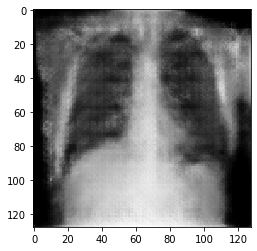

[8/51][0/236]	Loss_D: 1.2794	Loss_G: 0.9298	D(x): 0.4784	D(G(z)): 0.4001 / 0.4114
True


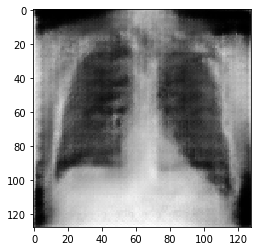

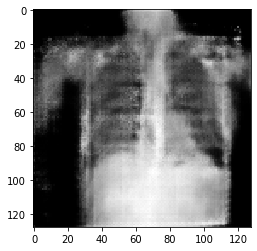

[8/51][20/236]	Loss_D: 1.3075	Loss_G: 1.0287	D(x): 0.5171	D(G(z)): 0.4544 / 0.3751
True


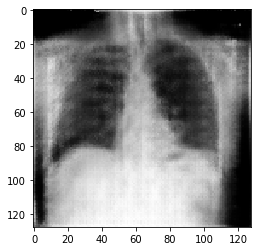

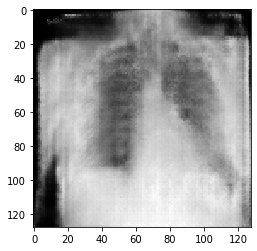

[8/51][40/236]	Loss_D: 1.2746	Loss_G: 1.2013	D(x): 0.5351	D(G(z)): 0.4596 / 0.3142
True


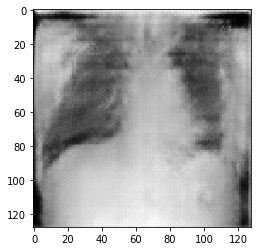

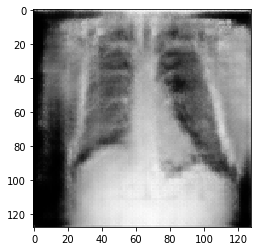

[8/51][60/236]	Loss_D: 1.3121	Loss_G: 0.7520	D(x): 0.4647	D(G(z)): 0.4008 / 0.4794
True


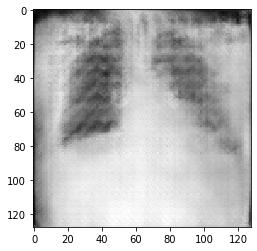

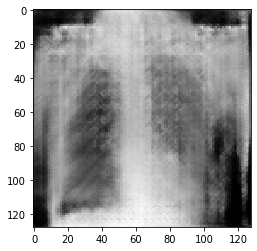

[8/51][80/236]	Loss_D: 1.3563	Loss_G: 0.8223	D(x): 0.4538	D(G(z)): 0.4199 / 0.4443
True


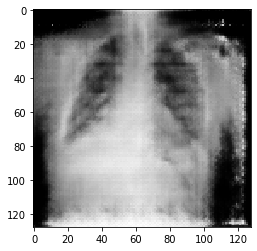

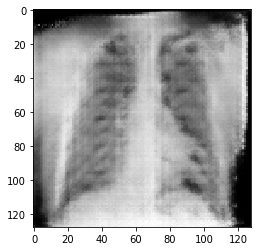

[8/51][100/236]	Loss_D: 1.3200	Loss_G: 1.2540	D(x): 0.6092	D(G(z)): 0.5477 / 0.2964
True


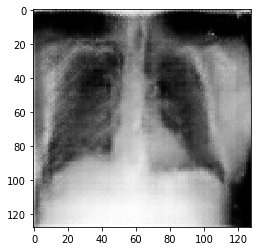

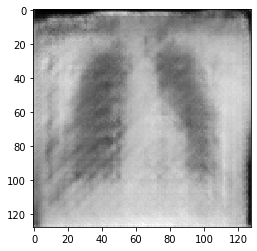

[8/51][120/236]	Loss_D: 1.3713	Loss_G: 1.0686	D(x): 0.5163	D(G(z)): 0.4955 / 0.3545
True


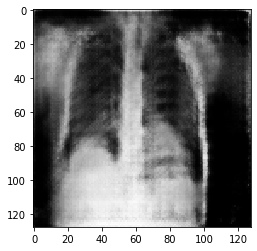

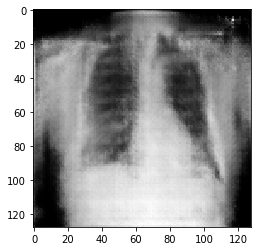

[8/51][140/236]	Loss_D: 1.3226	Loss_G: 0.8744	D(x): 0.4684	D(G(z)): 0.4140 / 0.4258
True


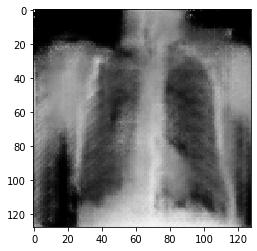

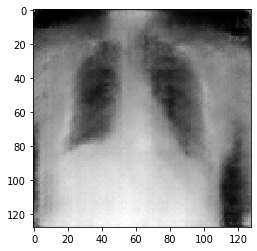

[8/51][160/236]	Loss_D: 1.3503	Loss_G: 0.8201	D(x): 0.4881	D(G(z)): 0.4560 / 0.4456
True


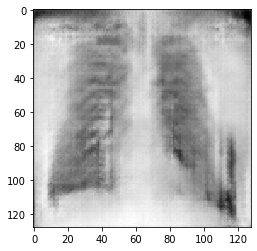

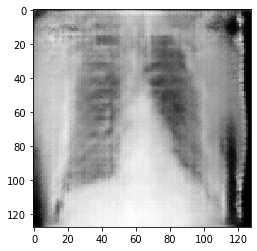

[8/51][180/236]	Loss_D: 1.4636	Loss_G: 0.9367	D(x): 0.4622	D(G(z)): 0.4833 / 0.4026
True


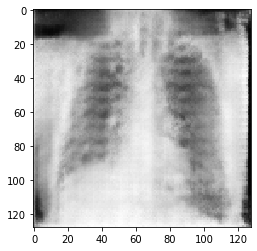

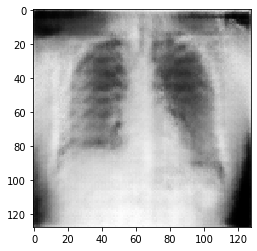

[8/51][200/236]	Loss_D: 1.3689	Loss_G: 1.0684	D(x): 0.5975	D(G(z)): 0.5599 / 0.3584
True


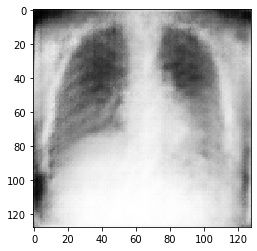

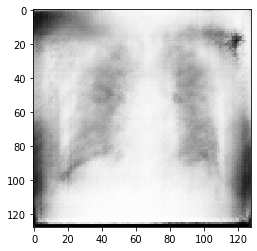

[8/51][220/236]	Loss_D: 1.3420	Loss_G: 0.7699	D(x): 0.4711	D(G(z)): 0.4280 / 0.4710



True


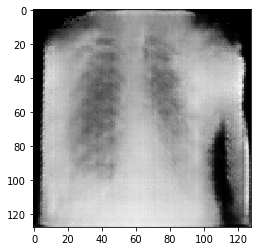

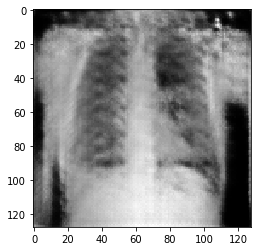

[9/51][0/236]	Loss_D: 1.4149	Loss_G: 0.7934	D(x): 0.3889	D(G(z)): 0.3556 / 0.4579
True


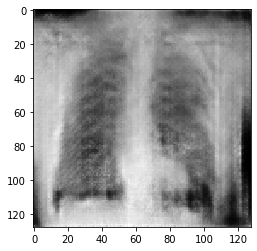

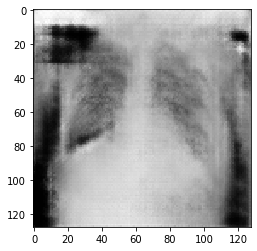

[9/51][20/236]	Loss_D: 1.3721	Loss_G: 1.0650	D(x): 0.5574	D(G(z)): 0.5199 / 0.3599
True


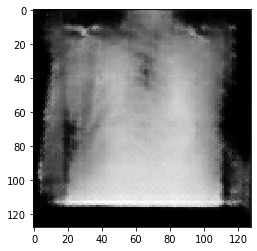

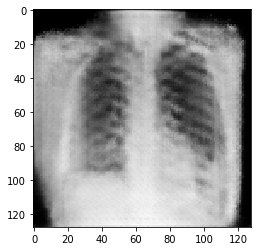

[9/51][40/236]	Loss_D: 1.3488	Loss_G: 1.2412	D(x): 0.5748	D(G(z)): 0.5338 / 0.2971
True


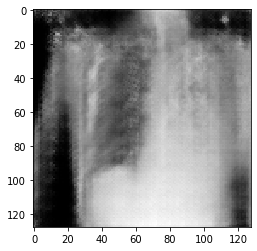

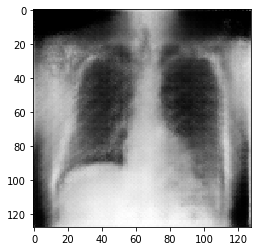

[9/51][60/236]	Loss_D: 1.3797	Loss_G: 1.5874	D(x): 0.6925	D(G(z)): 0.6252 / 0.2171
True


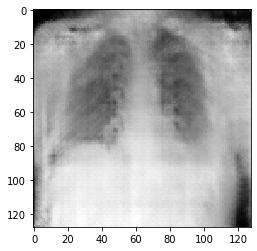

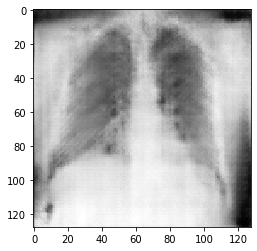

[9/51][80/236]	Loss_D: 1.3534	Loss_G: 0.7010	D(x): 0.4110	D(G(z)): 0.3484 / 0.5018
True


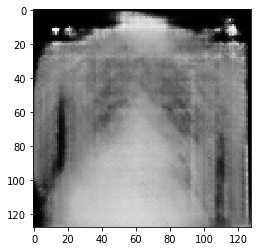

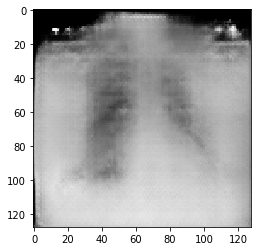

[9/51][100/236]	Loss_D: 1.3389	Loss_G: 0.9856	D(x): 0.4841	D(G(z)): 0.4434 / 0.3830
True


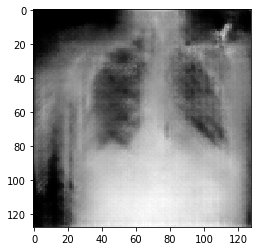

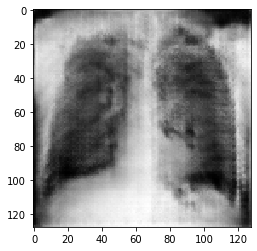

[9/51][120/236]	Loss_D: 1.3675	Loss_G: 0.9710	D(x): 0.5084	D(G(z)): 0.4866 / 0.3884
True


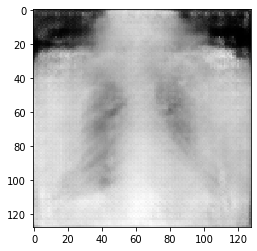

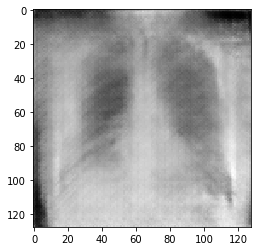

[9/51][140/236]	Loss_D: 1.4157	Loss_G: 0.6913	D(x): 0.3888	D(G(z)): 0.3417 / 0.5157
True


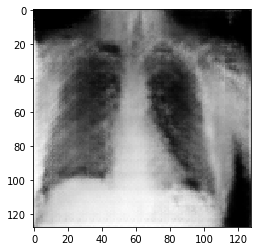

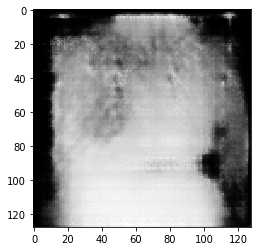

[9/51][160/236]	Loss_D: 1.3538	Loss_G: 0.9849	D(x): 0.5536	D(G(z)): 0.5218 / 0.3808
True


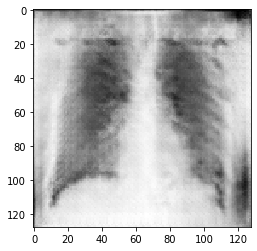

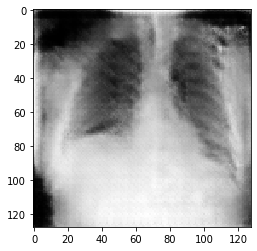

[9/51][180/236]	Loss_D: 1.3355	Loss_G: 0.9427	D(x): 0.4881	D(G(z)): 0.4449 / 0.4003
True


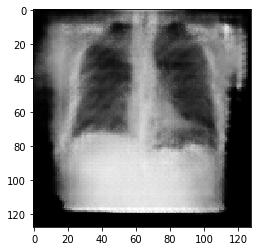

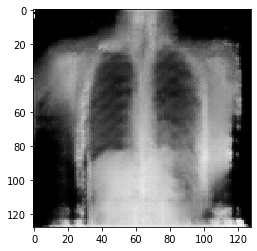

[9/51][200/236]	Loss_D: 1.2836	Loss_G: 1.0603	D(x): 0.5522	D(G(z)): 0.4866 / 0.3546
True


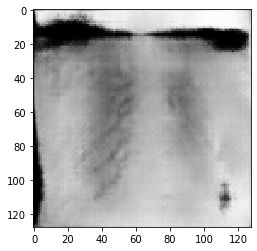

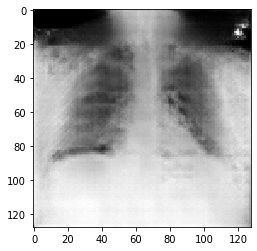

[9/51][220/236]	Loss_D: 1.3532	Loss_G: 0.8614	D(x): 0.5337	D(G(z)): 0.5024 / 0.4309



True


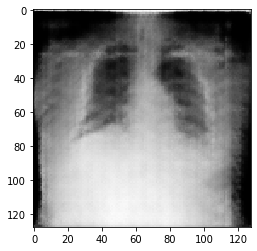

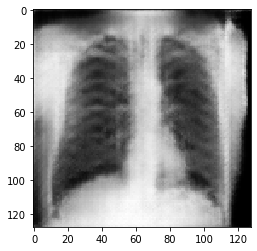

[10/51][0/236]	Loss_D: 1.3140	Loss_G: 1.0219	D(x): 0.4880	D(G(z)): 0.4363 / 0.3697
True


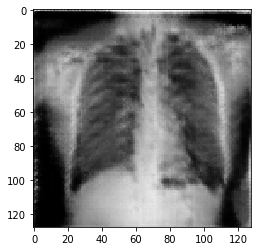

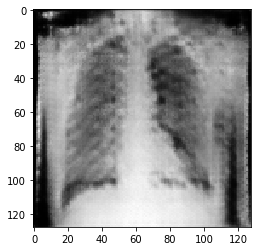

[10/51][20/236]	Loss_D: 1.3567	Loss_G: 0.9469	D(x): 0.5359	D(G(z)): 0.5058 / 0.3997
True


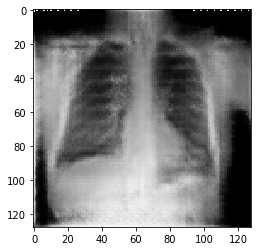

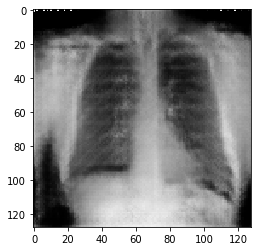

[10/51][40/236]	Loss_D: 1.3667	Loss_G: 0.9760	D(x): 0.4844	D(G(z)): 0.4583 / 0.3823
True


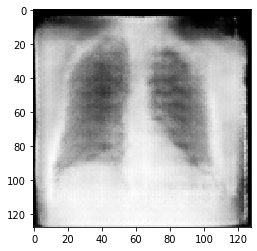

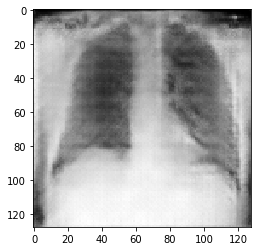

[10/51][60/236]	Loss_D: 1.4013	Loss_G: 1.0547	D(x): 0.5519	D(G(z)): 0.5427 / 0.3549
True


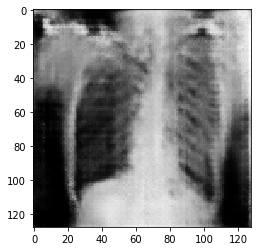

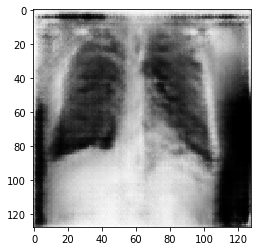

[10/51][80/236]	Loss_D: 1.2781	Loss_G: 1.1617	D(x): 0.5506	D(G(z)): 0.4815 / 0.3213
True


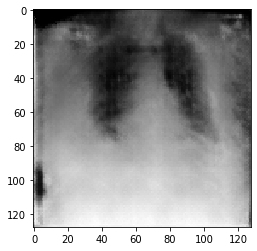

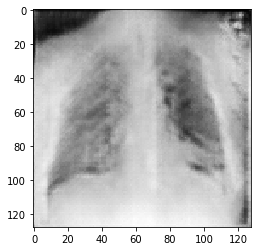

[10/51][100/236]	Loss_D: 1.2494	Loss_G: 1.2830	D(x): 0.5857	D(G(z)): 0.4983 / 0.2899
True


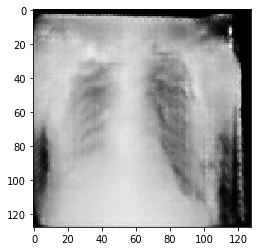

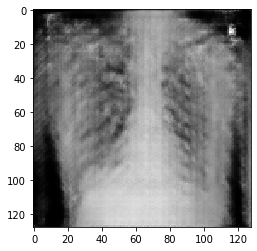

[10/51][120/236]	Loss_D: 1.2681	Loss_G: 0.9943	D(x): 0.5635	D(G(z)): 0.4904 / 0.3758
True


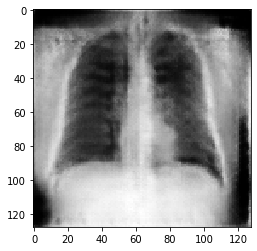

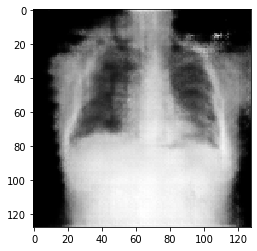

[10/51][140/236]	Loss_D: 1.4088	Loss_G: 1.0774	D(x): 0.5556	D(G(z)): 0.5439 / 0.3503
True


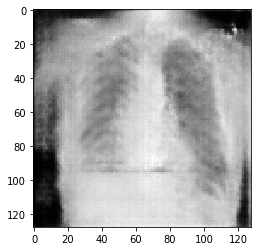

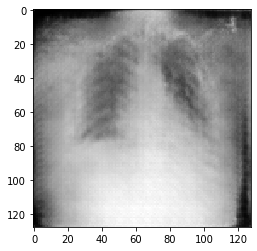

[10/51][160/236]	Loss_D: 1.3683	Loss_G: 0.9153	D(x): 0.4739	D(G(z)): 0.4472 / 0.4078
True


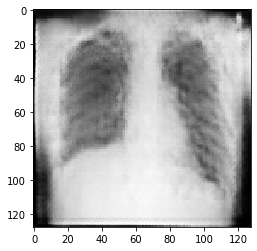

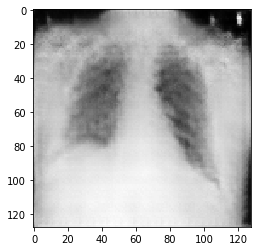

[10/51][180/236]	Loss_D: 1.3565	Loss_G: 0.8934	D(x): 0.5002	D(G(z)): 0.4729 / 0.4216
True


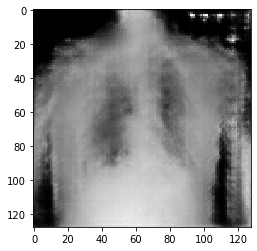

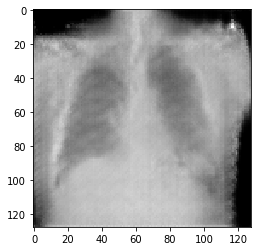

[10/51][200/236]	Loss_D: 1.3320	Loss_G: 1.1227	D(x): 0.5916	D(G(z)): 0.5432 / 0.3330
True


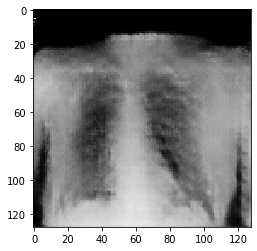

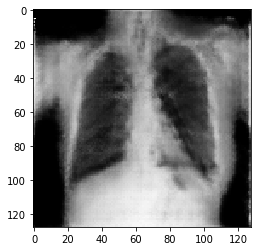

[10/51][220/236]	Loss_D: 1.4092	Loss_G: 0.8121	D(x): 0.4930	D(G(z)): 0.4934 / 0.4488



True


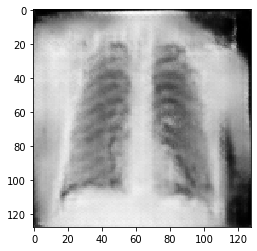

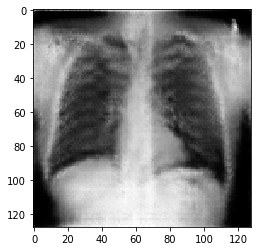

[11/51][0/236]	Loss_D: 1.2270	Loss_G: 1.0887	D(x): 0.5992	D(G(z)): 0.5027 / 0.3435
True


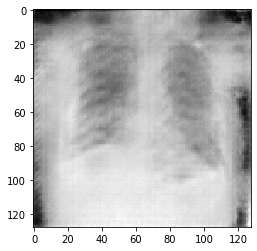

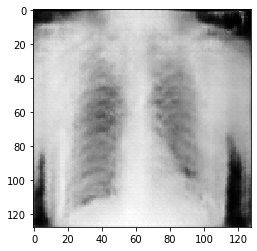

[11/51][20/236]	Loss_D: 1.2921	Loss_G: 0.9579	D(x): 0.5532	D(G(z)): 0.4921 / 0.3886
True


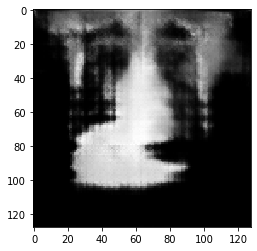

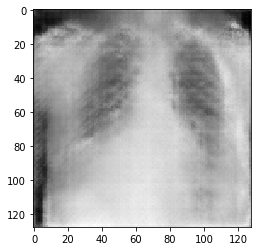

[11/51][40/236]	Loss_D: 1.2553	Loss_G: 1.2409	D(x): 0.6565	D(G(z)): 0.5517 / 0.3047
True


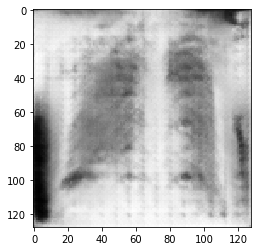

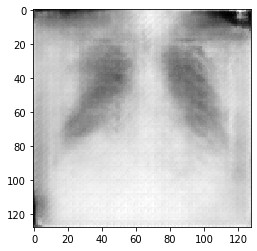

[11/51][60/236]	Loss_D: 1.3395	Loss_G: 0.9737	D(x): 0.5023	D(G(z)): 0.4674 / 0.3859
True


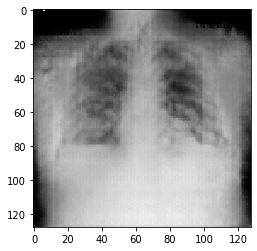

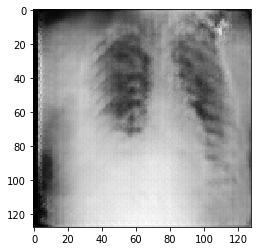

[11/51][80/236]	Loss_D: 1.2031	Loss_G: 0.9643	D(x): 0.4272	D(G(z)): 0.2826 / 0.3867
True


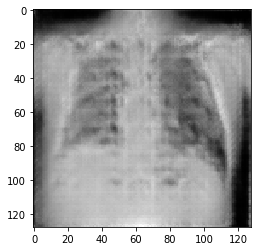

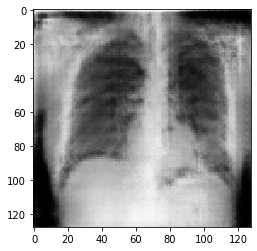

[11/51][100/236]	Loss_D: 1.2724	Loss_G: 1.1406	D(x): 0.5808	D(G(z)): 0.5018 / 0.3335
True


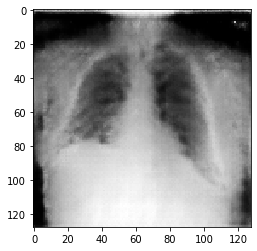

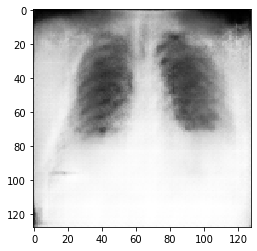

[11/51][120/236]	Loss_D: 1.2787	Loss_G: 1.0176	D(x): 0.5618	D(G(z)): 0.4940 / 0.3692
True


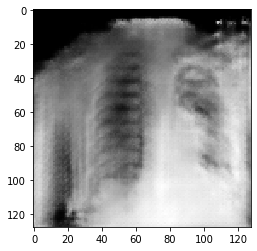

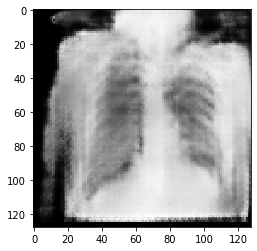

[11/51][140/236]	Loss_D: 1.3487	Loss_G: 0.8760	D(x): 0.5154	D(G(z)): 0.4839 / 0.4239
True


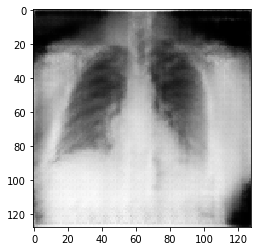

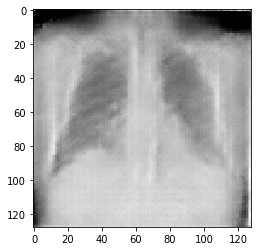

[11/51][160/236]	Loss_D: 1.4843	Loss_G: 0.9060	D(x): 0.4663	D(G(z)): 0.5014 / 0.4114
True


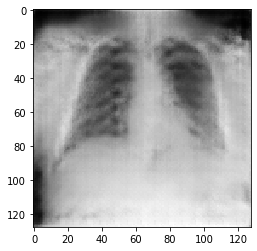

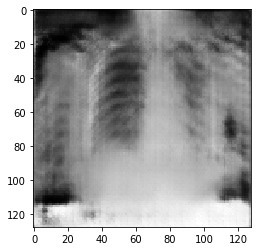

[11/51][180/236]	Loss_D: 1.1043	Loss_G: 1.2322	D(x): 0.6286	D(G(z)): 0.4603 / 0.2987
True


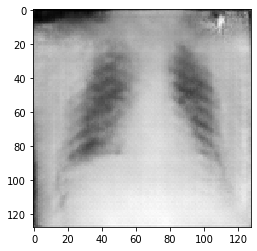

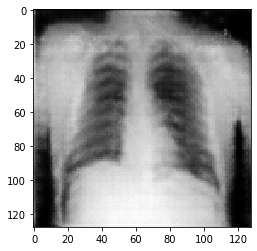

[11/51][200/236]	Loss_D: 1.1899	Loss_G: 1.0521	D(x): 0.5761	D(G(z)): 0.4537 / 0.3596
True


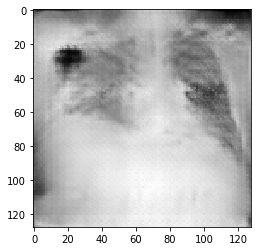

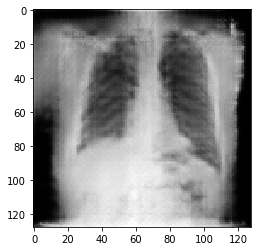

[11/51][220/236]	Loss_D: 1.1486	Loss_G: 1.1110	D(x): 0.5656	D(G(z)): 0.4261 / 0.3377



True


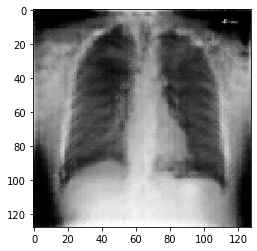

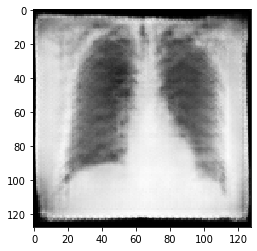

[12/51][0/236]	Loss_D: 1.2042	Loss_G: 1.1059	D(x): 0.5768	D(G(z)): 0.4682 / 0.3406
True


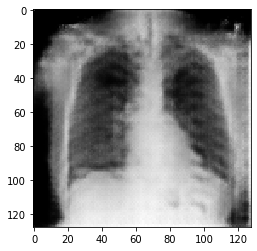

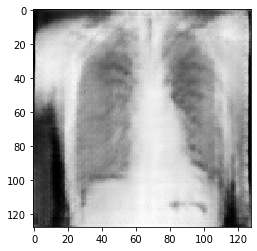

[12/51][20/236]	Loss_D: 1.2242	Loss_G: 1.0380	D(x): 0.5052	D(G(z)): 0.4058 / 0.3623
True


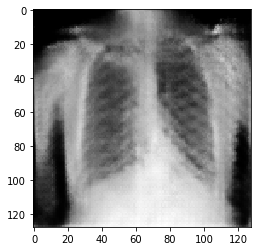

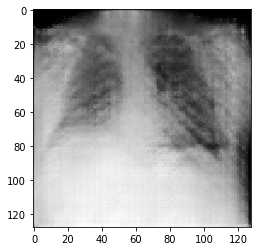

[12/51][40/236]	Loss_D: 1.3187	Loss_G: 0.7265	D(x): 0.4513	D(G(z)): 0.3932 / 0.4914
True


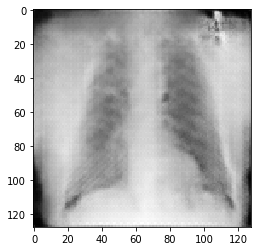

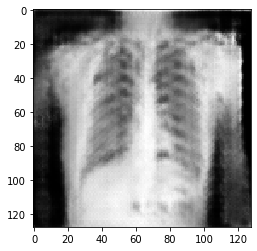

[12/51][60/236]	Loss_D: 1.2225	Loss_G: 0.9773	D(x): 0.5720	D(G(z)): 0.4736 / 0.3837
True


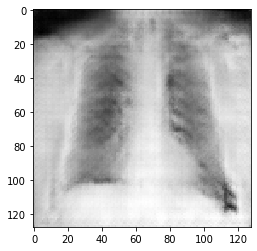

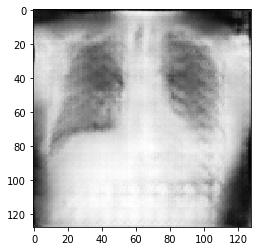

[12/51][80/236]	Loss_D: 1.2738	Loss_G: 0.8633	D(x): 0.5370	D(G(z)): 0.4662 / 0.4303
True


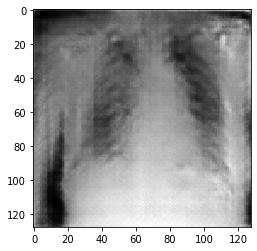

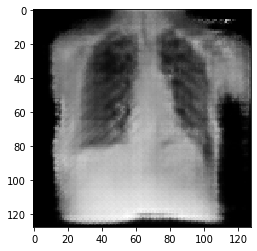

[12/51][100/236]	Loss_D: 1.3203	Loss_G: 0.9079	D(x): 0.4062	D(G(z)): 0.3134 / 0.4166
True


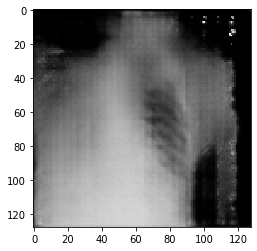

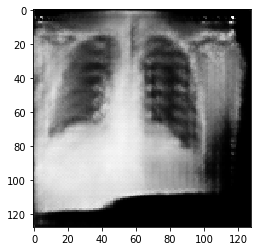

[12/51][120/236]	Loss_D: 1.2996	Loss_G: 1.3251	D(x): 0.5655	D(G(z)): 0.5054 / 0.2749
True


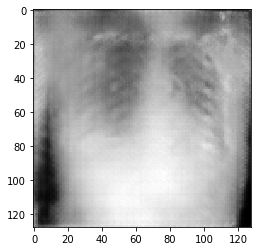

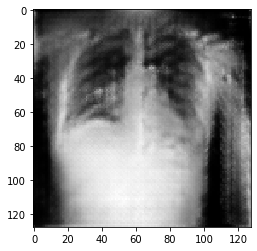

[12/51][140/236]	Loss_D: 1.3201	Loss_G: 0.7318	D(x): 0.4229	D(G(z)): 0.3487 / 0.4888
True


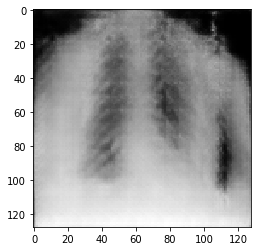

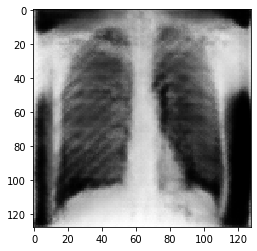

[12/51][160/236]	Loss_D: 1.3115	Loss_G: 1.0630	D(x): 0.5308	D(G(z)): 0.4807 / 0.3521
True


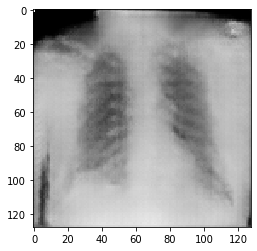

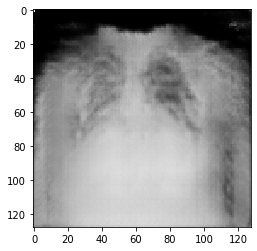

[12/51][180/236]	Loss_D: 1.2425	Loss_G: 1.2041	D(x): 0.5620	D(G(z)): 0.4748 / 0.3105
True


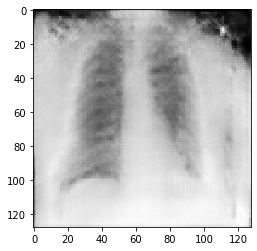

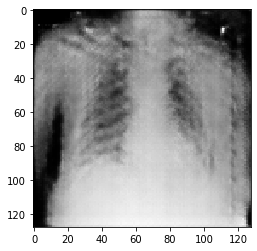

[12/51][200/236]	Loss_D: 1.4369	Loss_G: 0.9359	D(x): 0.5356	D(G(z)): 0.5458 / 0.3995
True


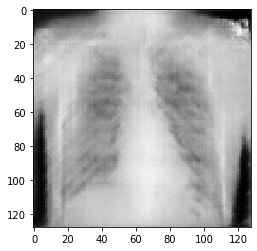

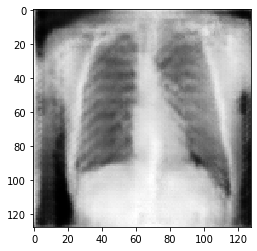

[12/51][220/236]	Loss_D: 1.2801	Loss_G: 0.9502	D(x): 0.5171	D(G(z)): 0.4485 / 0.3940



True


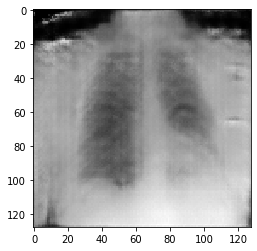

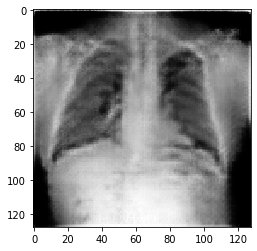

[13/51][0/236]	Loss_D: 1.1343	Loss_G: 1.1085	D(x): 0.5895	D(G(z)): 0.4464 / 0.3382
True


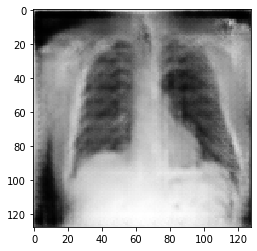

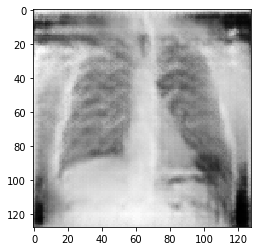

[13/51][20/236]	Loss_D: 1.3536	Loss_G: 0.7286	D(x): 0.5110	D(G(z)): 0.4787 / 0.4908
True


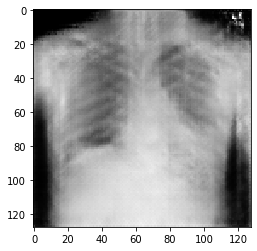

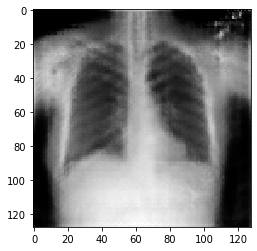

[13/51][40/236]	Loss_D: 1.3309	Loss_G: 1.0241	D(x): 0.5243	D(G(z)): 0.4790 / 0.3650
True


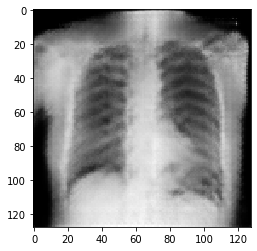

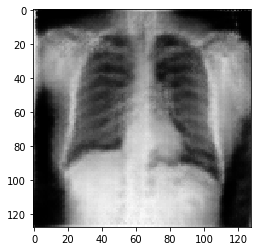

[13/51][60/236]	Loss_D: 1.3409	Loss_G: 0.8770	D(x): 0.4819	D(G(z)): 0.4330 / 0.4271
True


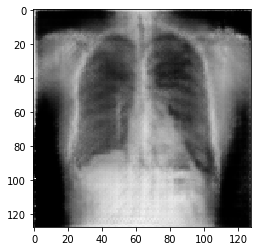

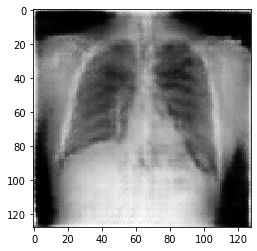

[13/51][80/236]	Loss_D: 1.2581	Loss_G: 1.1521	D(x): 0.5261	D(G(z)): 0.4393 / 0.3263
True


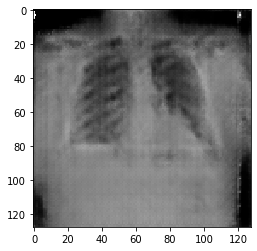

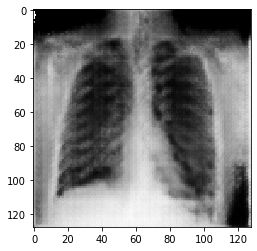

[13/51][100/236]	Loss_D: 1.2051	Loss_G: 1.1452	D(x): 0.5819	D(G(z)): 0.4690 / 0.3316
True


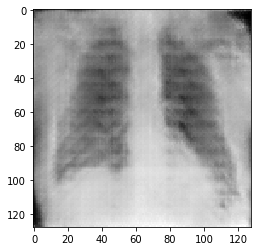

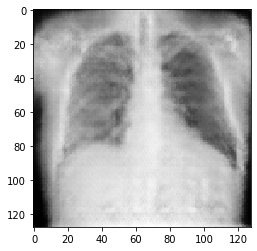

[13/51][120/236]	Loss_D: 1.2453	Loss_G: 1.1633	D(x): 0.5197	D(G(z)): 0.4356 / 0.3186
True


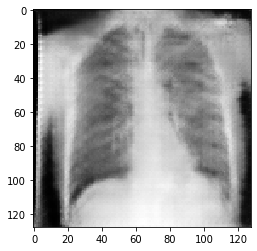

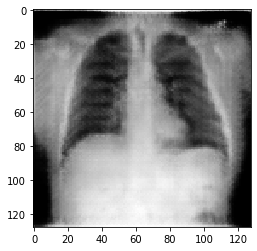

[13/51][140/236]	Loss_D: 1.1407	Loss_G: 0.9494	D(x): 0.5044	D(G(z)): 0.3468 / 0.3999
True


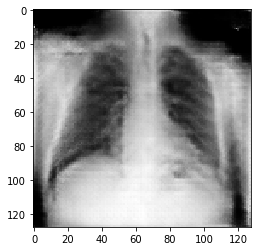

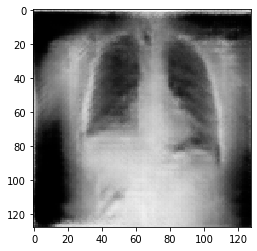

[13/51][160/236]	Loss_D: 1.2760	Loss_G: 1.2468	D(x): 0.6573	D(G(z)): 0.5634 / 0.2987
True


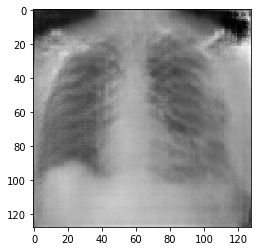

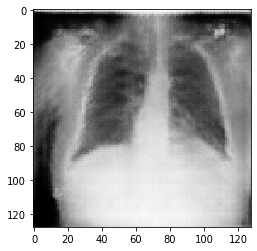

[13/51][180/236]	Loss_D: 1.2471	Loss_G: 0.8811	D(x): 0.4532	D(G(z)): 0.3480 / 0.4209
True


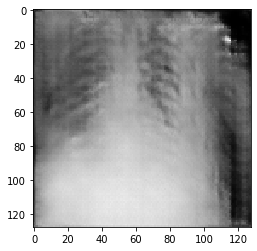

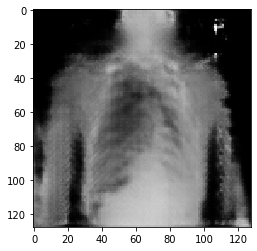

[13/51][200/236]	Loss_D: 1.3313	Loss_G: 1.4894	D(x): 0.7109	D(G(z)): 0.6139 / 0.2375
True


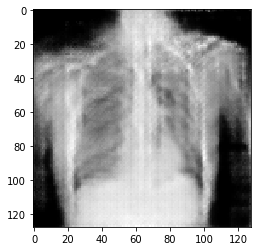

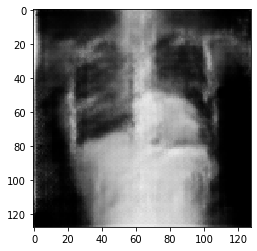

[13/51][220/236]	Loss_D: 1.3401	Loss_G: 1.0807	D(x): 0.5421	D(G(z)): 0.4896 / 0.3496



True


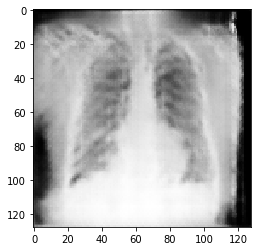

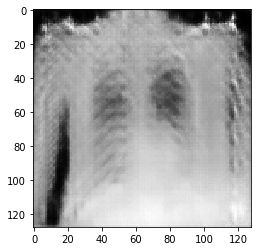

[14/51][0/236]	Loss_D: 1.3521	Loss_G: 1.6106	D(x): 0.6858	D(G(z)): 0.6039 / 0.2101
True


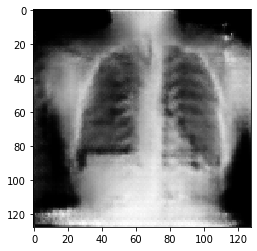

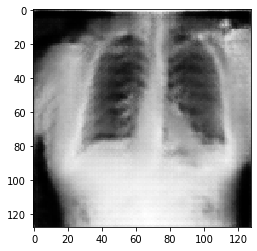

[14/51][20/236]	Loss_D: 1.3036	Loss_G: 1.1302	D(x): 0.5549	D(G(z)): 0.4962 / 0.3338
True


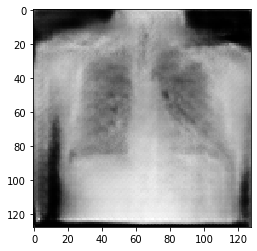

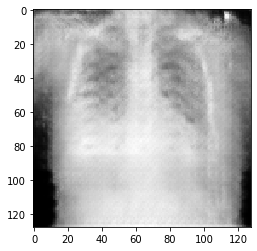

[14/51][40/236]	Loss_D: 1.2593	Loss_G: 0.8256	D(x): 0.4331	D(G(z)): 0.3193 / 0.4458
True


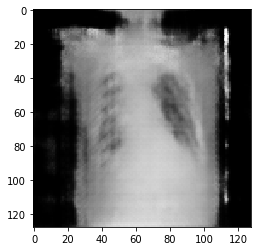

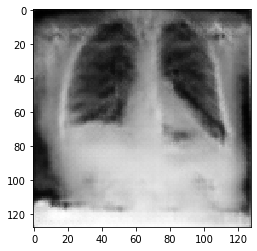

[14/51][60/236]	Loss_D: 1.3416	Loss_G: 1.3376	D(x): 0.5849	D(G(z)): 0.5369 / 0.2760
True


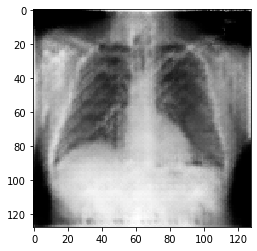

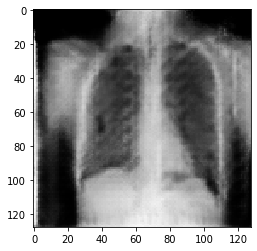

[14/51][80/236]	Loss_D: 1.1336	Loss_G: 1.6071	D(x): 0.6986	D(G(z)): 0.5287 / 0.2088
True


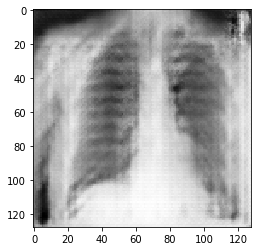

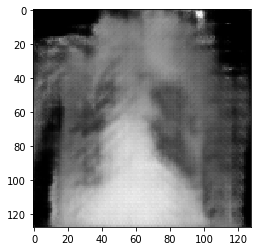

[14/51][100/236]	Loss_D: 1.3068	Loss_G: 1.0484	D(x): 0.5276	D(G(z)): 0.4665 / 0.3594
True


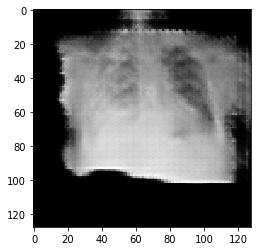

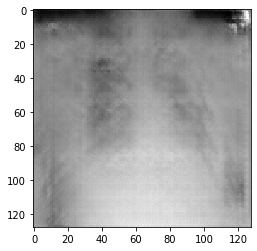

[14/51][120/236]	Loss_D: 1.2493	Loss_G: 0.9779	D(x): 0.5097	D(G(z)): 0.4123 / 0.3921
True


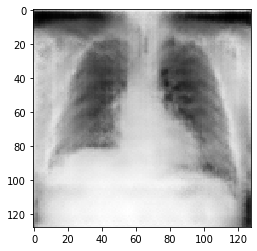

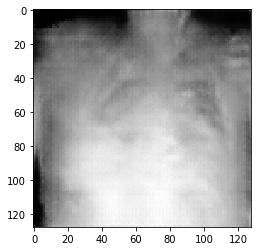

[14/51][140/236]	Loss_D: 1.2258	Loss_G: 0.9201	D(x): 0.4705	D(G(z)): 0.3523 / 0.4113
True


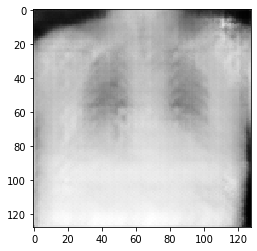

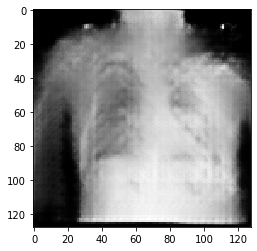

[14/51][160/236]	Loss_D: 1.1294	Loss_G: 1.4808	D(x): 0.6664	D(G(z)): 0.5035 / 0.2377
True


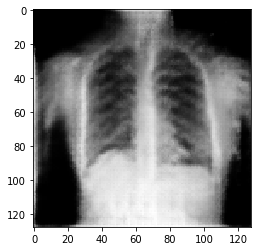

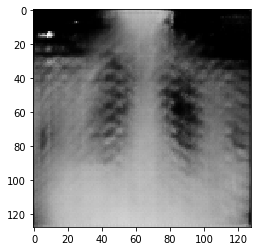

[14/51][180/236]	Loss_D: 1.3706	Loss_G: 0.9816	D(x): 0.6064	D(G(z)): 0.5635 / 0.3966
True


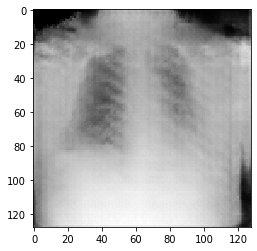

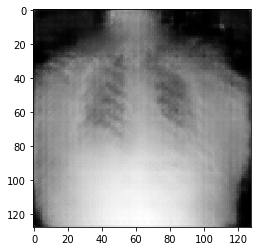

[14/51][200/236]	Loss_D: 1.2831	Loss_G: 1.2318	D(x): 0.4926	D(G(z)): 0.4160 / 0.3044
True


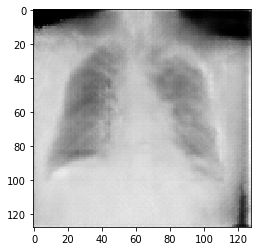

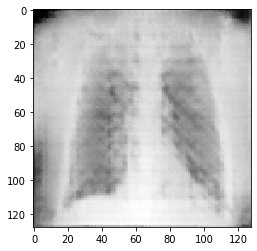

[14/51][220/236]	Loss_D: 1.2638	Loss_G: 0.8412	D(x): 0.4461	D(G(z)): 0.3446 / 0.4403



True


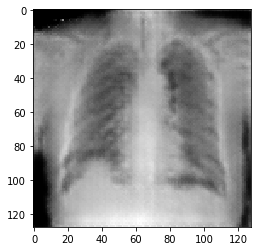

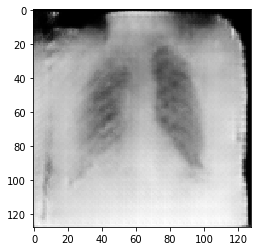

[15/51][0/236]	Loss_D: 1.2477	Loss_G: 1.1483	D(x): 0.5583	D(G(z)): 0.4718 / 0.3252
True


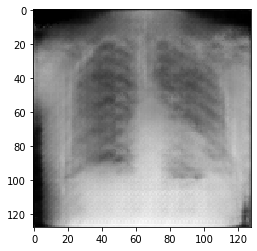

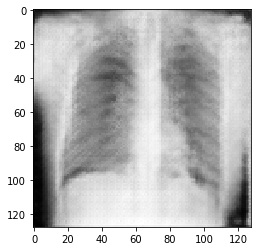

[15/51][20/236]	Loss_D: 1.1943	Loss_G: 1.1977	D(x): 0.5873	D(G(z)): 0.4729 / 0.3102
True


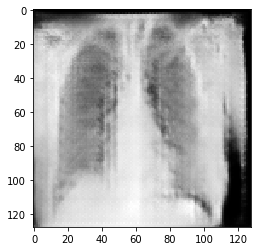

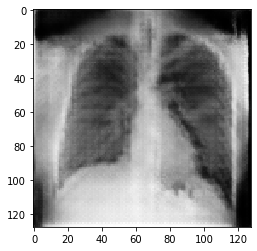

[15/51][40/236]	Loss_D: 1.2695	Loss_G: 1.0575	D(x): 0.6114	D(G(z)): 0.5219 / 0.3615
True


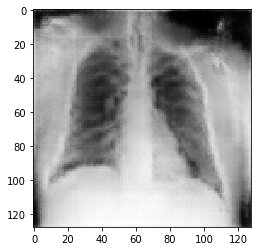

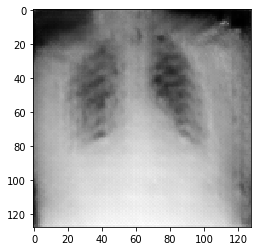

[15/51][60/236]	Loss_D: 1.1079	Loss_G: 1.3571	D(x): 0.5725	D(G(z)): 0.4030 / 0.2740
True


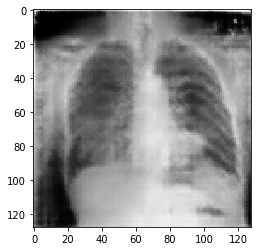

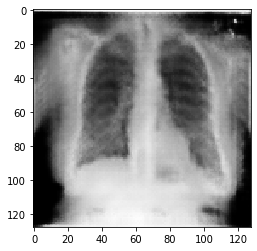

[15/51][80/236]	Loss_D: 1.2422	Loss_G: 1.3855	D(x): 0.6965	D(G(z)): 0.5702 / 0.2683
True


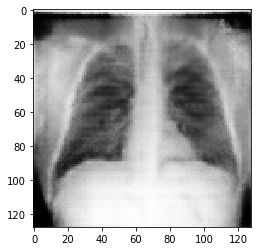

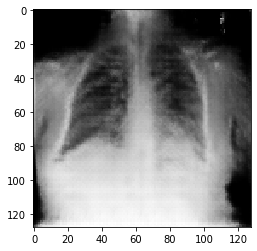

[15/51][100/236]	Loss_D: 1.2463	Loss_G: 1.1251	D(x): 0.5415	D(G(z)): 0.4544 / 0.3353
True


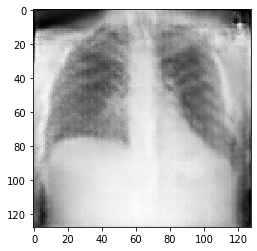

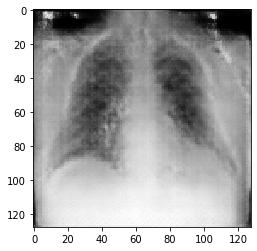

[15/51][120/236]	Loss_D: 1.2074	Loss_G: 1.0175	D(x): 0.6029	D(G(z)): 0.4914 / 0.3680
True


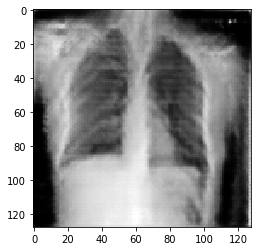

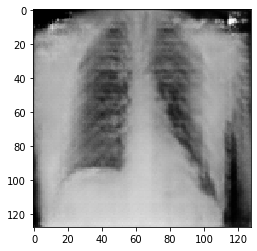

[15/51][140/236]	Loss_D: 1.4099	Loss_G: 1.1490	D(x): 0.6000	D(G(z)): 0.5776 / 0.3307
True


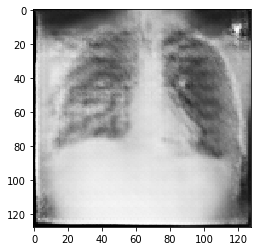

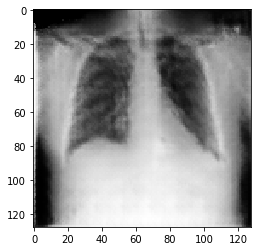

[15/51][160/236]	Loss_D: 1.3951	Loss_G: 1.0794	D(x): 0.6647	D(G(z)): 0.6150 / 0.3494
True


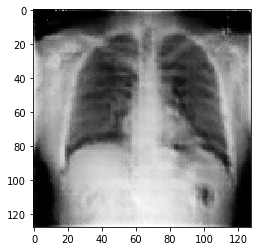

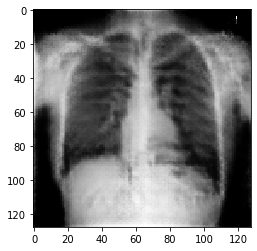

[15/51][180/236]	Loss_D: 1.2319	Loss_G: 1.3009	D(x): 0.5577	D(G(z)): 0.4558 / 0.2857
True


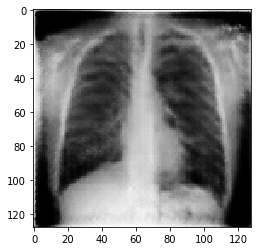

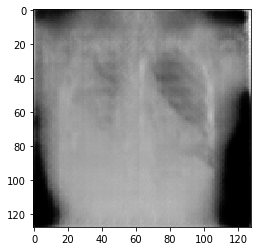

[15/51][200/236]	Loss_D: 1.0786	Loss_G: 1.3702	D(x): 0.7122	D(G(z)): 0.5127 / 0.2624
True


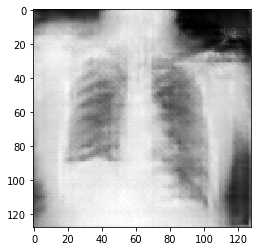

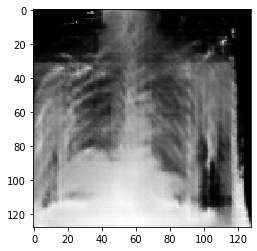

[15/51][220/236]	Loss_D: 1.2320	Loss_G: 1.1006	D(x): 0.5294	D(G(z)): 0.4328 / 0.3400



True


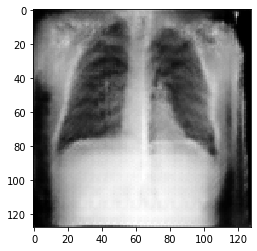

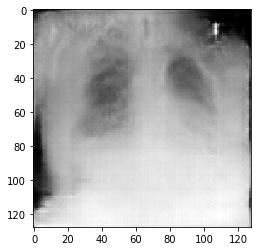

[16/51][0/236]	Loss_D: 1.3619	Loss_G: 1.0697	D(x): 0.5382	D(G(z)): 0.5081 / 0.3536
True


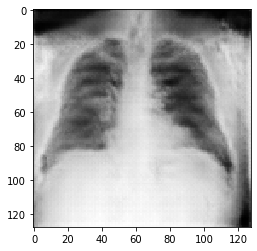

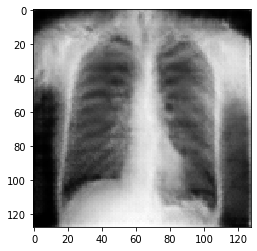

[16/51][20/236]	Loss_D: 1.3287	Loss_G: 1.0966	D(x): 0.6114	D(G(z)): 0.5397 / 0.3504
True


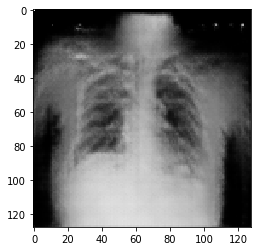

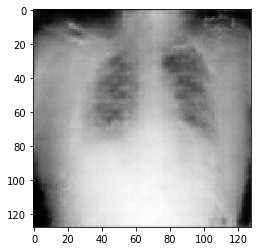

[16/51][40/236]	Loss_D: 1.4649	Loss_G: 0.7935	D(x): 0.4278	D(G(z)): 0.4366 / 0.4671
True


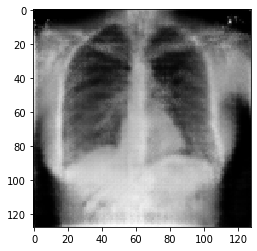

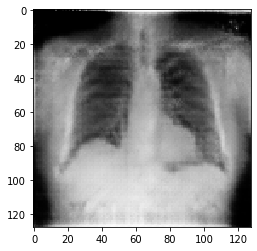

[16/51][60/236]	Loss_D: 1.3148	Loss_G: 0.8146	D(x): 0.4758	D(G(z)): 0.4232 / 0.4500
True


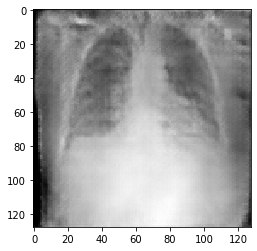

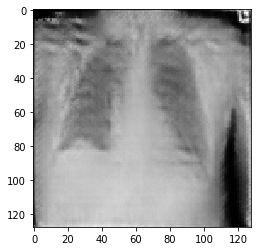

[16/51][80/236]	Loss_D: 1.2297	Loss_G: 1.1980	D(x): 0.6251	D(G(z)): 0.5201 / 0.3131
True


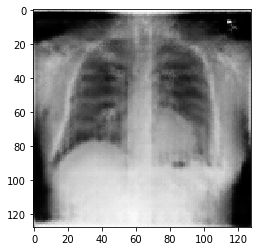

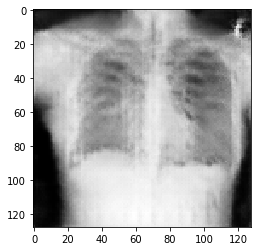

[16/51][100/236]	Loss_D: 1.1969	Loss_G: 1.0978	D(x): 0.6421	D(G(z)): 0.5190 / 0.3437
True


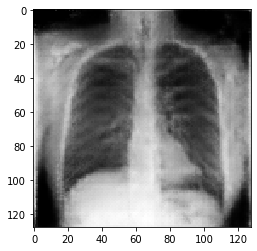

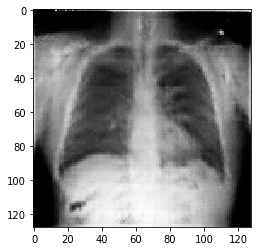

[16/51][120/236]	Loss_D: 1.4279	Loss_G: 0.8387	D(x): 0.4130	D(G(z)): 0.3979 / 0.4459
True


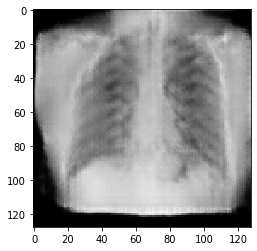

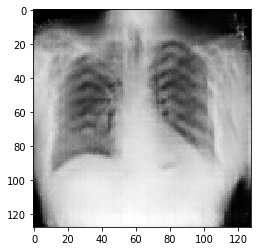

[16/51][140/236]	Loss_D: 1.2132	Loss_G: 1.0926	D(x): 0.5779	D(G(z)): 0.4687 / 0.3474
True


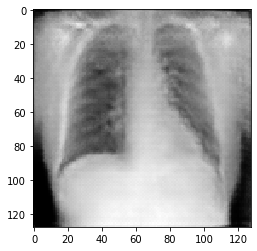

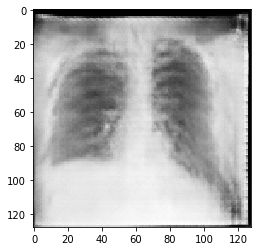

[16/51][160/236]	Loss_D: 1.2993	Loss_G: 0.7474	D(x): 0.4106	D(G(z)): 0.3146 / 0.4832
True


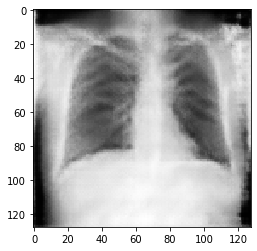

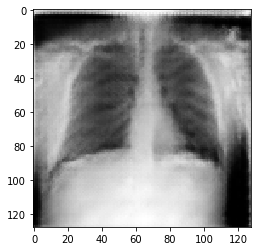

[16/51][180/236]	Loss_D: 1.3624	Loss_G: 0.9393	D(x): 0.5517	D(G(z)): 0.5180 / 0.4050
True


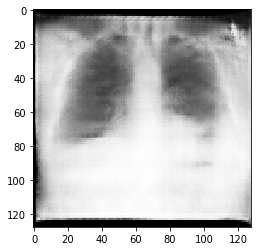

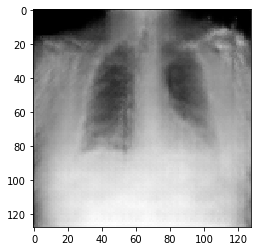

[16/51][200/236]	Loss_D: 1.2557	Loss_G: 1.1028	D(x): 0.5162	D(G(z)): 0.4306 / 0.3455
True


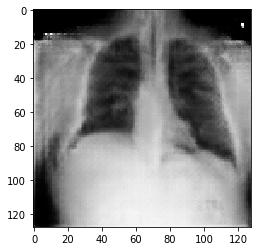

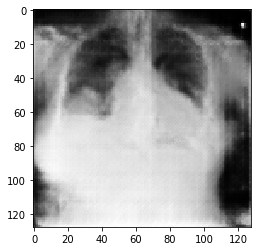

[16/51][220/236]	Loss_D: 1.4449	Loss_G: 0.8998	D(x): 0.4370	D(G(z)): 0.4315 / 0.4169



True


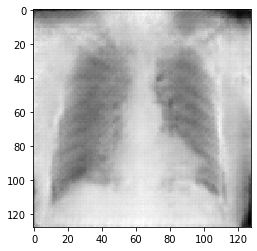

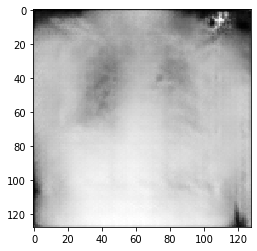

[17/51][0/236]	Loss_D: 1.2189	Loss_G: 1.2397	D(x): 0.5792	D(G(z)): 0.4762 / 0.2992
True


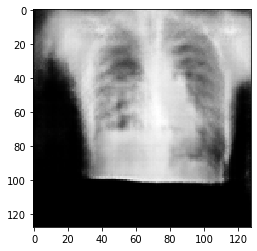

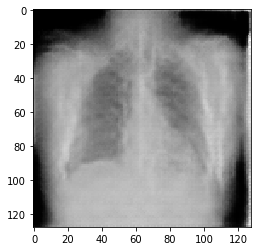

[17/51][20/236]	Loss_D: 1.3072	Loss_G: 0.9717	D(x): 0.5476	D(G(z)): 0.4922 / 0.3887
True


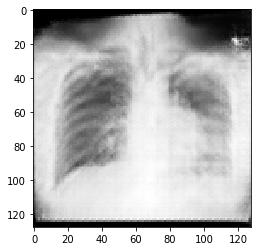

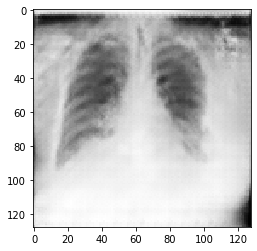

[17/51][40/236]	Loss_D: 1.3839	Loss_G: 1.1349	D(x): 0.5619	D(G(z)): 0.5374 / 0.3340
True


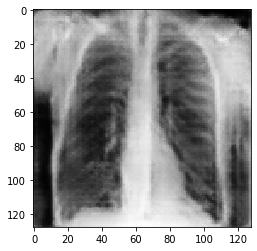

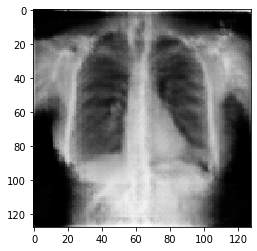

[17/51][60/236]	Loss_D: 1.1841	Loss_G: 1.0921	D(x): 0.4840	D(G(z)): 0.3510 / 0.3441
True


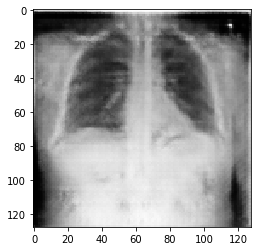

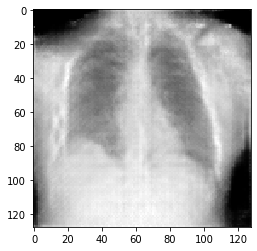

[17/51][80/236]	Loss_D: 1.5023	Loss_G: 1.0186	D(x): 0.4469	D(G(z)): 0.4835 / 0.3698
True


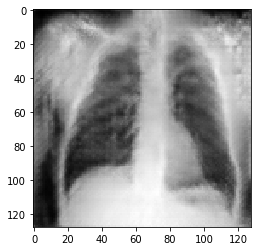

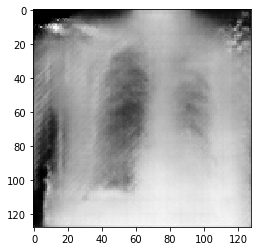

[17/51][100/236]	Loss_D: 1.2294	Loss_G: 1.2118	D(x): 0.6294	D(G(z)): 0.5235 / 0.3070
True


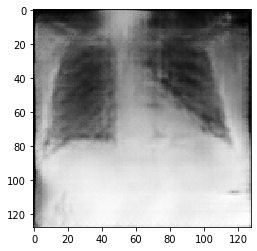

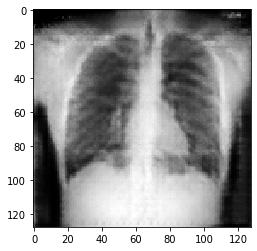

[17/51][120/236]	Loss_D: 1.5511	Loss_G: 0.8527	D(x): 0.4441	D(G(z)): 0.4907 / 0.4376
True


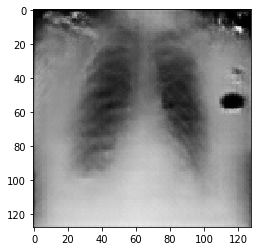

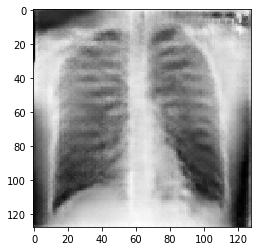

[17/51][140/236]	Loss_D: 1.3215	Loss_G: 1.1403	D(x): 0.4743	D(G(z)): 0.4228 / 0.3274
True


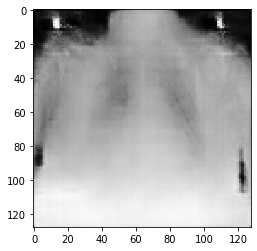

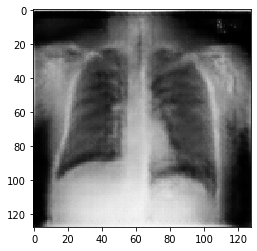

[17/51][160/236]	Loss_D: 1.3714	Loss_G: 1.0481	D(x): 0.5860	D(G(z)): 0.5529 / 0.3598
True


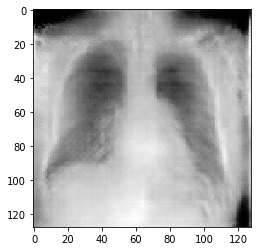

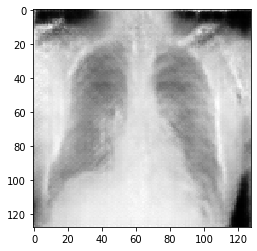

[17/51][180/236]	Loss_D: 1.5849	Loss_G: 1.0125	D(x): 0.6316	D(G(z)): 0.6517 / 0.3763
True


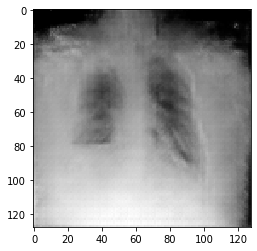

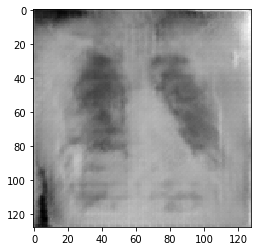

[17/51][200/236]	Loss_D: 1.3519	Loss_G: 1.1006	D(x): 0.5471	D(G(z)): 0.5099 / 0.3444
True


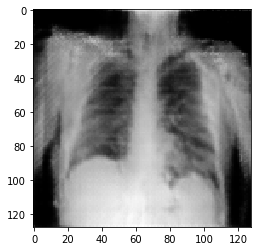

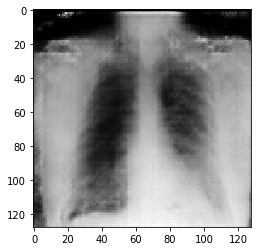

[17/51][220/236]	Loss_D: 1.2644	Loss_G: 1.0966	D(x): 0.5751	D(G(z)): 0.4969 / 0.3427



True


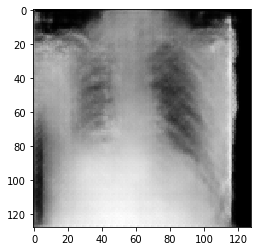

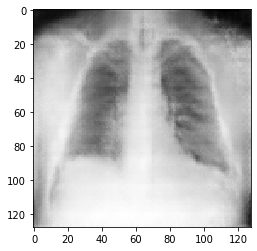

[18/51][0/236]	Loss_D: 1.4695	Loss_G: 0.8596	D(x): 0.4149	D(G(z)): 0.4186 / 0.4361
True


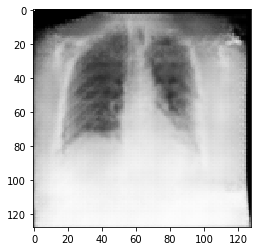

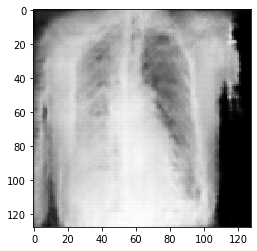

[18/51][20/236]	Loss_D: 1.3438	Loss_G: 1.4425	D(x): 0.5889	D(G(z)): 0.5447 / 0.2465
True


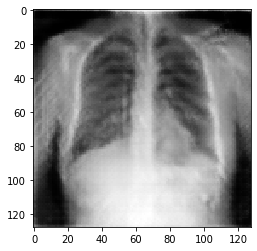

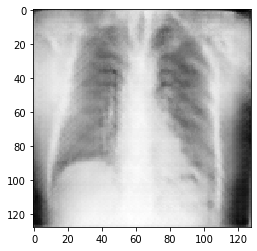

[18/51][40/236]	Loss_D: 1.7791	Loss_G: 0.8526	D(x): 0.2523	D(G(z)): 0.2520 / 0.4407
True


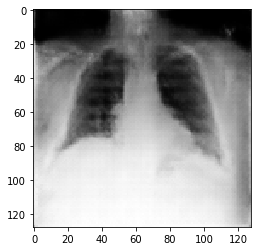

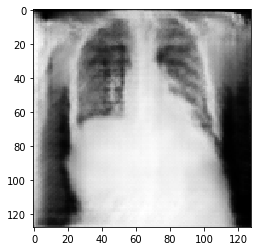

[18/51][60/236]	Loss_D: 1.2502	Loss_G: 1.2531	D(x): 0.6805	D(G(z)): 0.5635 / 0.3012
True


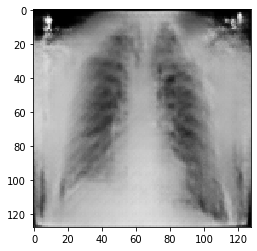

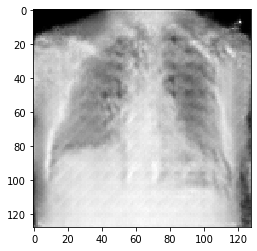

[18/51][80/236]	Loss_D: 1.3310	Loss_G: 1.1367	D(x): 0.5772	D(G(z)): 0.5189 / 0.3377
True


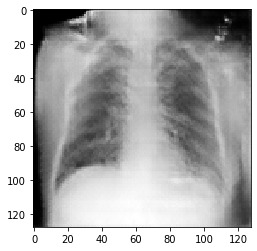

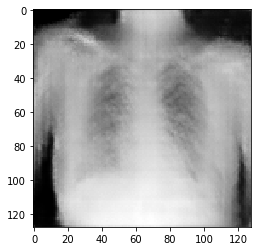

[18/51][100/236]	Loss_D: 1.1533	Loss_G: 1.2728	D(x): 0.6201	D(G(z)): 0.4754 / 0.2924
True


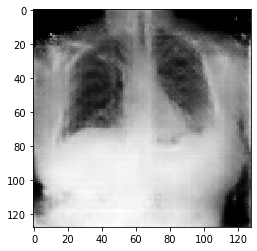

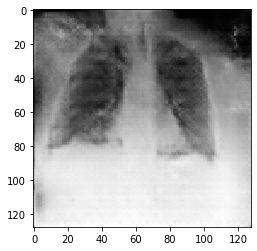

[18/51][120/236]	Loss_D: 1.2171	Loss_G: 1.3096	D(x): 0.5839	D(G(z)): 0.4753 / 0.2787
True


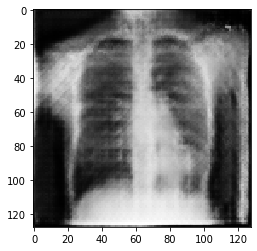

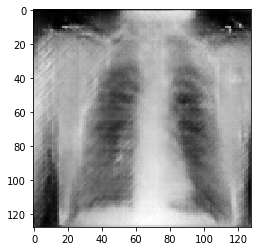

[18/51][140/236]	Loss_D: 1.3649	Loss_G: 1.3628	D(x): 0.6608	D(G(z)): 0.5967 / 0.2681
True


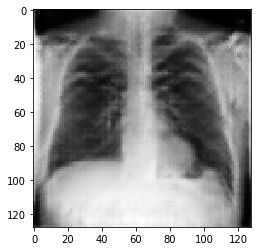

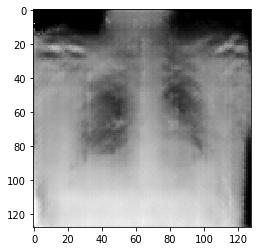

[18/51][160/236]	Loss_D: 1.3905	Loss_G: 1.6182	D(x): 0.6996	D(G(z)): 0.6289 / 0.2092
True


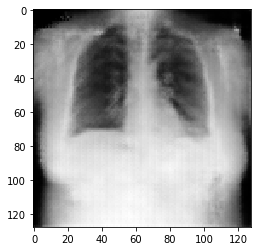

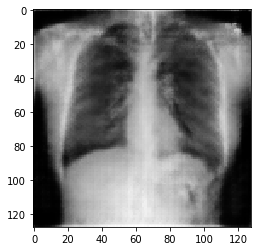

[18/51][180/236]	Loss_D: 1.1676	Loss_G: 0.7595	D(x): 0.4910	D(G(z)): 0.3513 / 0.4769
True


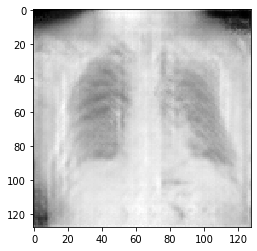

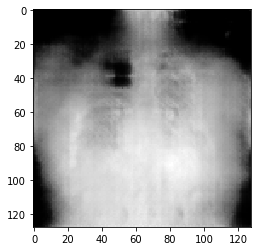

[18/51][200/236]	Loss_D: 1.3735	Loss_G: 0.7980	D(x): 0.4422	D(G(z)): 0.4034 / 0.4620
True


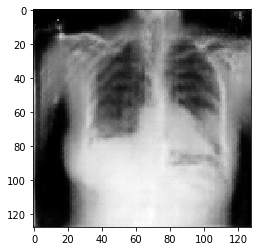

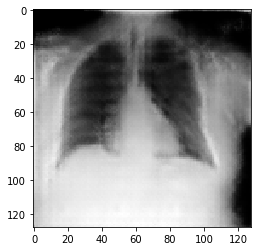

[18/51][220/236]	Loss_D: 1.1886	Loss_G: 1.3762	D(x): 0.6464	D(G(z)): 0.5144 / 0.2657



True


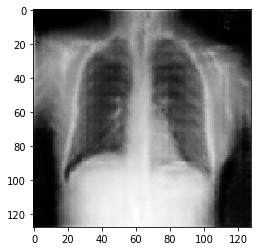

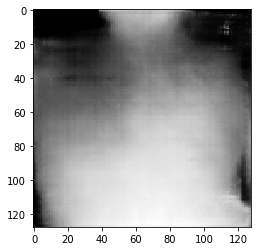

[19/51][0/236]	Loss_D: 1.7242	Loss_G: 0.7399	D(x): 0.4434	D(G(z)): 0.5728 / 0.4890
True


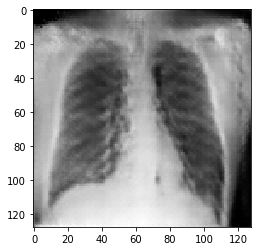

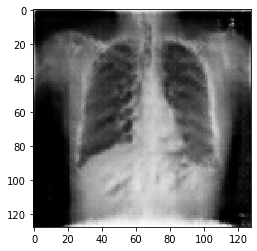

[19/51][20/236]	Loss_D: 1.4309	Loss_G: 1.0357	D(x): 0.5545	D(G(z)): 0.5489 / 0.3705
True


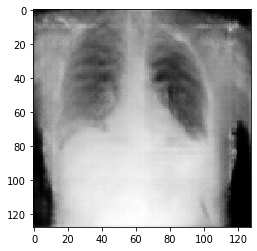

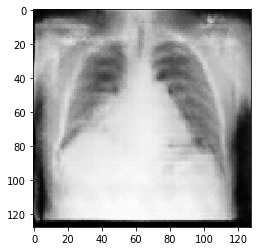

[19/51][40/236]	Loss_D: 1.2330	Loss_G: 1.2331	D(x): 0.5720	D(G(z)): 0.4724 / 0.2989
True


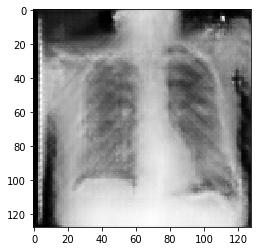

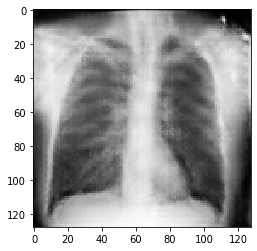

[19/51][60/236]	Loss_D: 1.2133	Loss_G: 1.0233	D(x): 0.5044	D(G(z)): 0.3910 / 0.3682
True


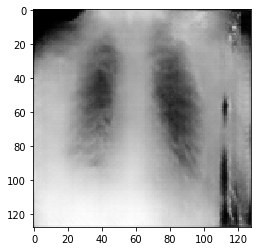

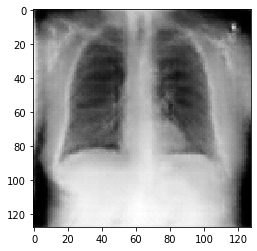

[19/51][80/236]	Loss_D: 1.1078	Loss_G: 1.1694	D(x): 0.5104	D(G(z)): 0.3227 / 0.3322
True


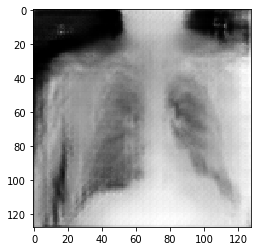

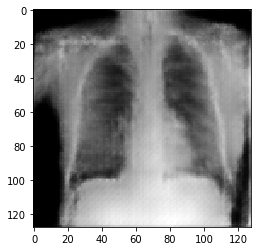

[19/51][100/236]	Loss_D: 1.2765	Loss_G: 0.9946	D(x): 0.5569	D(G(z)): 0.4834 / 0.3804
True


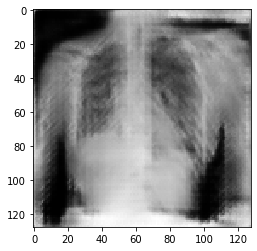

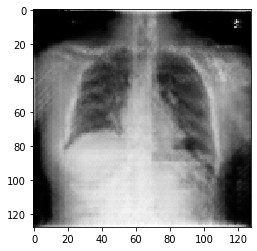

[19/51][120/236]	Loss_D: 1.3586	Loss_G: 1.1793	D(x): 0.4650	D(G(z)): 0.4179 / 0.3253
True


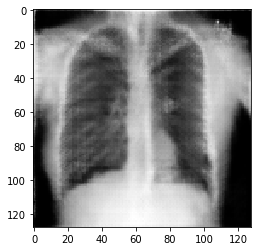

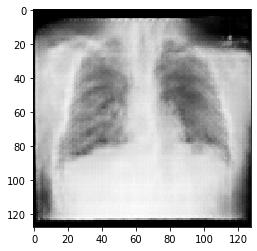

[19/51][140/236]	Loss_D: 0.9529	Loss_G: 1.5012	D(x): 0.7317	D(G(z)): 0.4601 / 0.2331
True


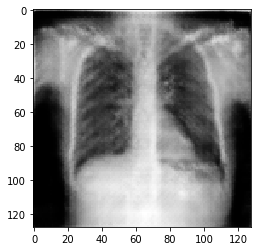

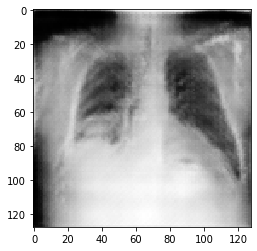

[19/51][160/236]	Loss_D: 1.7258	Loss_G: 1.4255	D(x): 0.8326	D(G(z)): 0.7693 / 0.2538
True


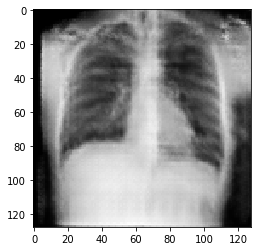

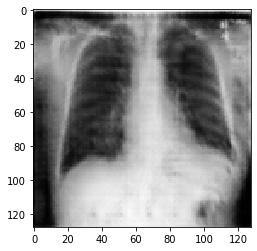

[19/51][180/236]	Loss_D: 1.1615	Loss_G: 1.1192	D(x): 0.5831	D(G(z)): 0.4502 / 0.3362
True


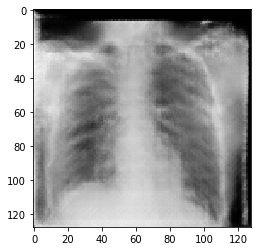

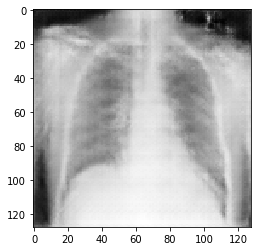

[19/51][200/236]	Loss_D: 1.6529	Loss_G: 0.7581	D(x): 0.2570	D(G(z)): 0.1596 / 0.4824
True


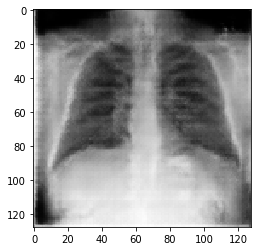

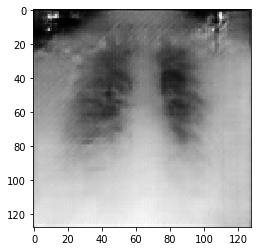

[19/51][220/236]	Loss_D: 1.1470	Loss_G: 1.4029	D(x): 0.6317	D(G(z)): 0.4736 / 0.2635



True


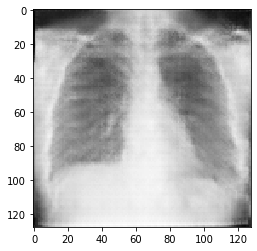

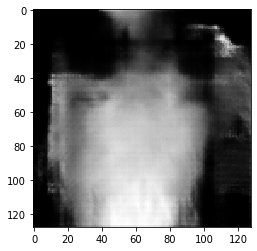

[20/51][0/236]	Loss_D: 1.0585	Loss_G: 1.1423	D(x): 0.4948	D(G(z)): 0.2787 / 0.3309
True


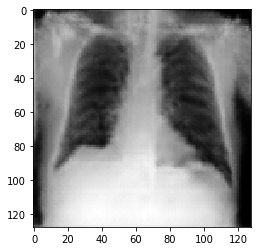

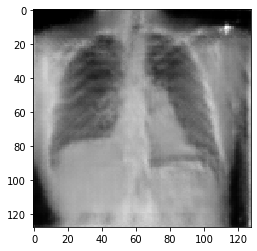

[20/51][20/236]	Loss_D: 1.1742	Loss_G: 0.9982	D(x): 0.5403	D(G(z)): 0.4128 / 0.3772
True


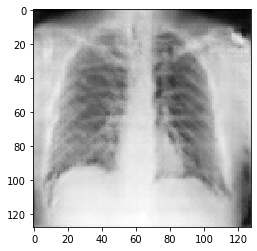

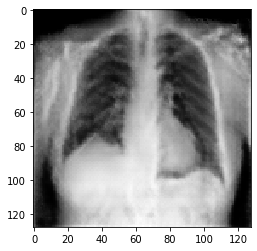

[20/51][40/236]	Loss_D: 1.2696	Loss_G: 1.4124	D(x): 0.7547	D(G(z)): 0.6103 / 0.2542
True


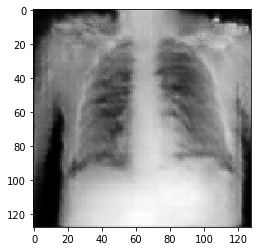

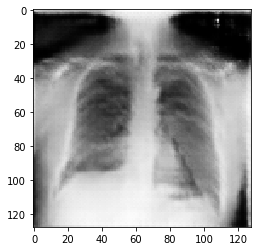

[20/51][60/236]	Loss_D: 1.0568	Loss_G: 1.3258	D(x): 0.5624	D(G(z)): 0.3653 / 0.2772
True


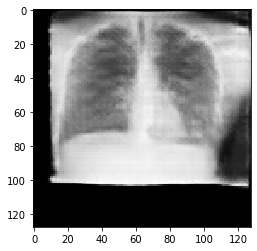

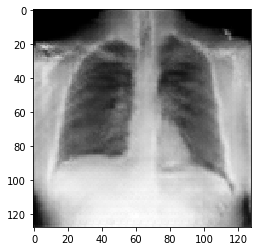

[20/51][80/236]	Loss_D: 1.3682	Loss_G: 0.8717	D(x): 0.4767	D(G(z)): 0.4435 / 0.4282
True


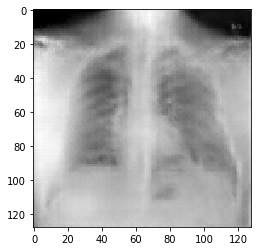

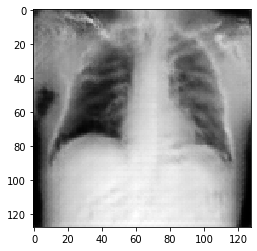

[20/51][100/236]	Loss_D: 1.3125	Loss_G: 1.1438	D(x): 0.7020	D(G(z)): 0.6013 / 0.3373
True


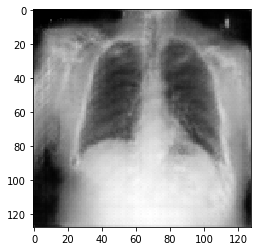

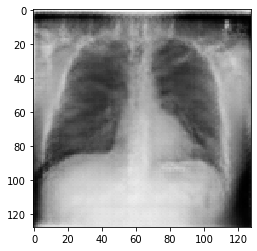

[20/51][120/236]	Loss_D: 1.2626	Loss_G: 1.1381	D(x): 0.6061	D(G(z)): 0.5143 / 0.3370
True


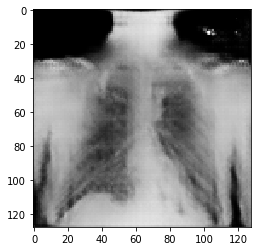

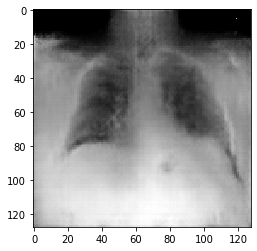

[20/51][140/236]	Loss_D: 1.0025	Loss_G: 1.5496	D(x): 0.7549	D(G(z)): 0.5002 / 0.2234
True


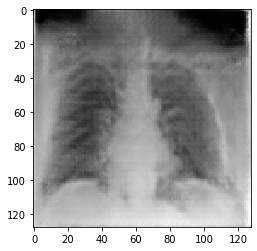

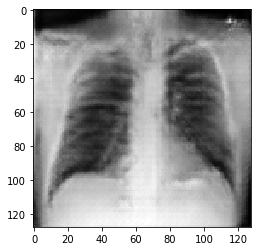

[20/51][160/236]	Loss_D: 1.2985	Loss_G: 1.3295	D(x): 0.6494	D(G(z)): 0.5599 / 0.2734
True


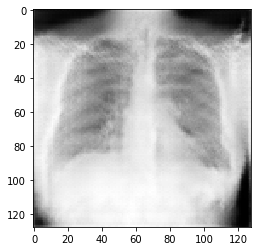

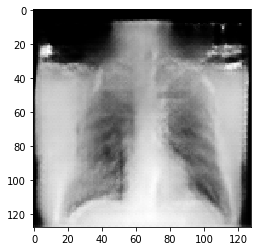

[20/51][180/236]	Loss_D: 1.2468	Loss_G: 0.9679	D(x): 0.5343	D(G(z)): 0.4431 / 0.3891
True


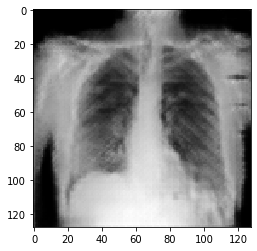

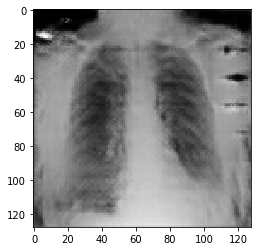

[20/51][200/236]	Loss_D: 1.1121	Loss_G: 1.2693	D(x): 0.5147	D(G(z)): 0.3427 / 0.2922
True


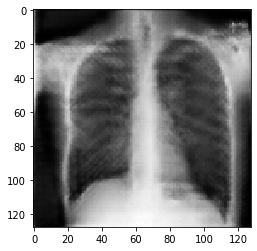

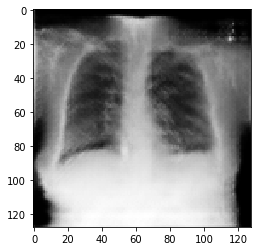

[20/51][220/236]	Loss_D: 1.2563	Loss_G: 0.9522	D(x): 0.5922	D(G(z)): 0.5037 / 0.3972



True


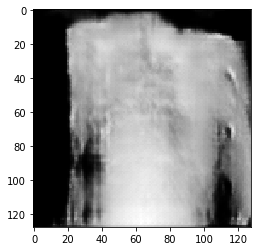

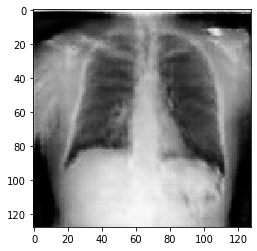

[21/51][0/236]	Loss_D: 1.1769	Loss_G: 0.9731	D(x): 0.5646	D(G(z)): 0.4344 / 0.3911
True


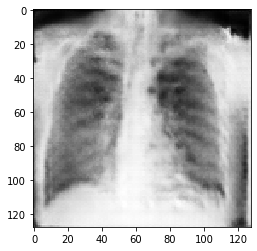

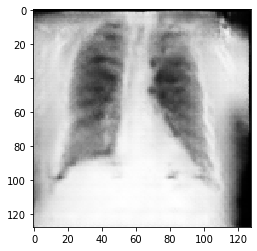

[21/51][20/236]	Loss_D: 1.1468	Loss_G: 1.3984	D(x): 0.6485	D(G(z)): 0.4975 / 0.2567
True


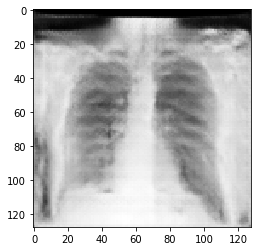

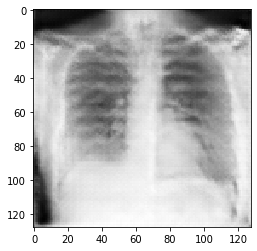

[21/51][40/236]	Loss_D: 0.8429	Loss_G: 1.5006	D(x): 0.6871	D(G(z)): 0.3614 / 0.2324
True


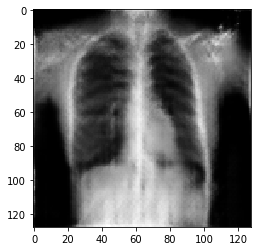

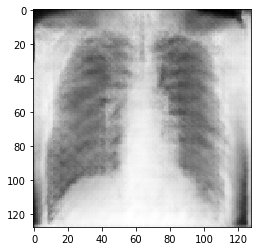

[21/51][60/236]	Loss_D: 1.0504	Loss_G: 1.1202	D(x): 0.6892	D(G(z)): 0.4732 / 0.3426
True


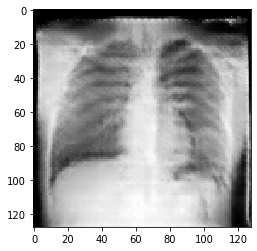

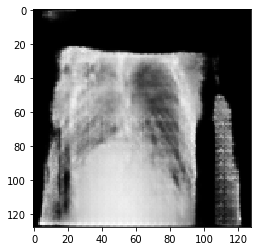

[21/51][80/236]	Loss_D: 0.8836	Loss_G: 1.4518	D(x): 0.8022	D(G(z)): 0.4707 / 0.2465
True


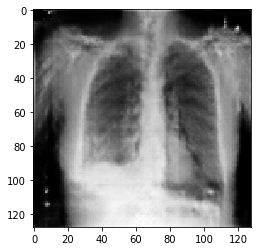

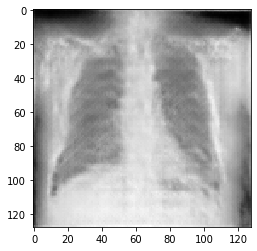

[21/51][100/236]	Loss_D: 0.9548	Loss_G: 1.5285	D(x): 0.6587	D(G(z)): 0.4032 / 0.2288
True


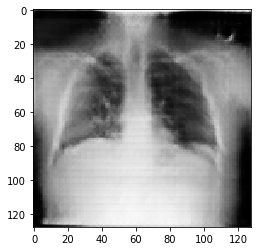

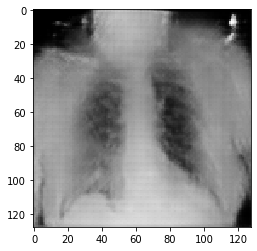

[21/51][120/236]	Loss_D: 1.7419	Loss_G: 0.8648	D(x): 0.3439	D(G(z)): 0.4475 / 0.4305
True


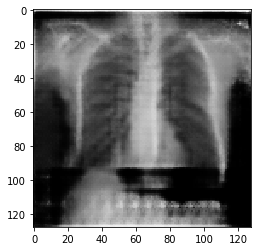

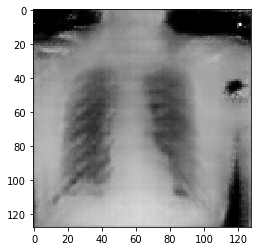

[21/51][140/236]	Loss_D: 1.1261	Loss_G: 1.5352	D(x): 0.6441	D(G(z)): 0.4815 / 0.2294
True


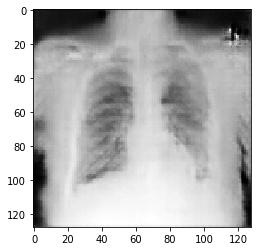

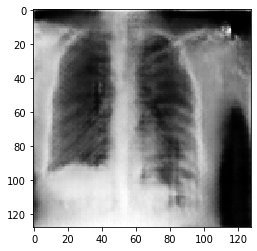

[21/51][160/236]	Loss_D: 0.8839	Loss_G: 1.3373	D(x): 0.5706	D(G(z)): 0.2594 / 0.2730
True


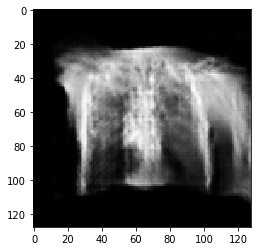

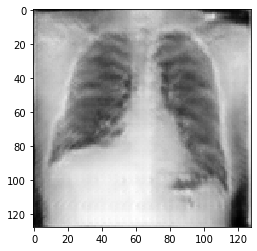

[21/51][180/236]	Loss_D: 1.1867	Loss_G: 1.0584	D(x): 0.6063	D(G(z)): 0.4801 / 0.3611
True


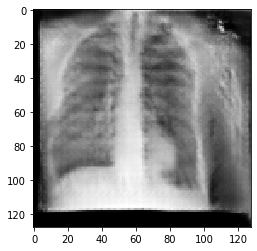

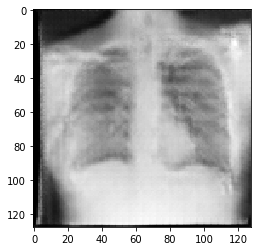

[21/51][200/236]	Loss_D: 1.1744	Loss_G: 1.1270	D(x): 0.5354	D(G(z)): 0.4045 / 0.3343
True


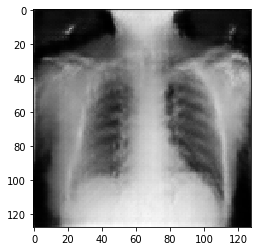

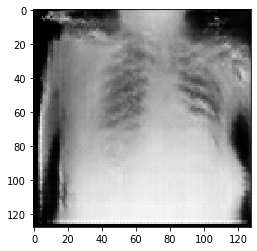

[21/51][220/236]	Loss_D: 1.2659	Loss_G: 1.1678	D(x): 0.4342	D(G(z)): 0.3285 / 0.3209



True


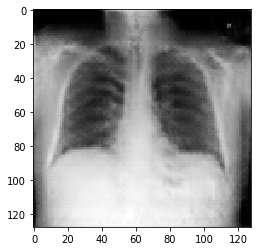

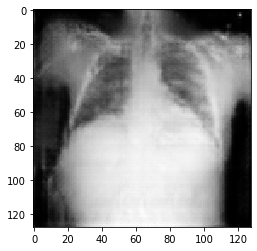

[22/51][0/236]	Loss_D: 1.1214	Loss_G: 1.0912	D(x): 0.7006	D(G(z)): 0.5209 / 0.3456
True


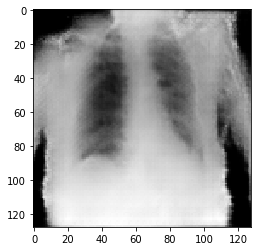

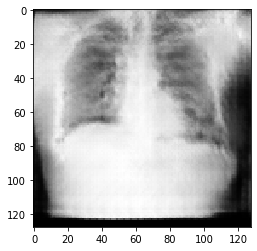

[22/51][20/236]	Loss_D: 1.2608	Loss_G: 1.2859	D(x): 0.6034	D(G(z)): 0.5142 / 0.2882
True


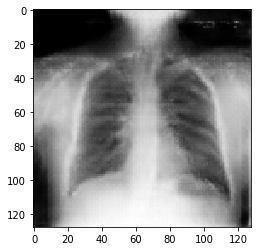

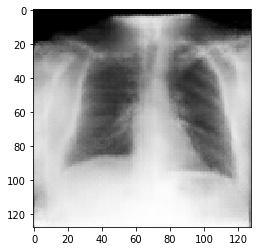

[22/51][40/236]	Loss_D: 0.9644	Loss_G: 1.3517	D(x): 0.5556	D(G(z)): 0.2927 / 0.2704
True


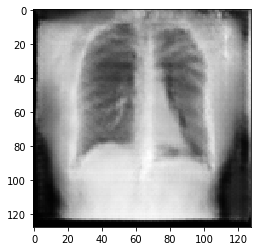

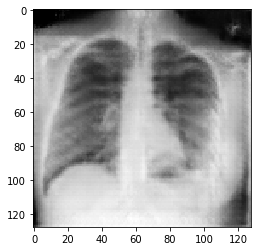

[22/51][60/236]	Loss_D: 1.0498	Loss_G: 1.3903	D(x): 0.6514	D(G(z)): 0.4449 / 0.2695
True


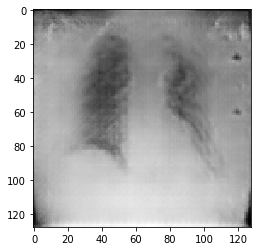

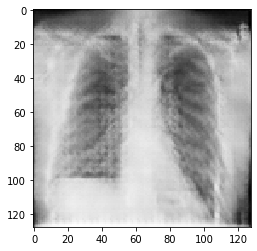

[22/51][80/236]	Loss_D: 0.9441	Loss_G: 1.3139	D(x): 0.6467	D(G(z)): 0.3847 / 0.2839
True


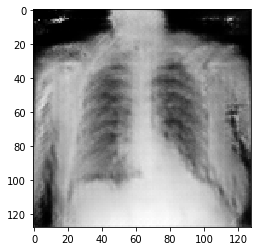

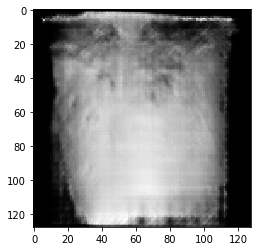

[22/51][100/236]	Loss_D: 1.4830	Loss_G: 0.9776	D(x): 0.3552	D(G(z)): 0.3320 / 0.3887
True


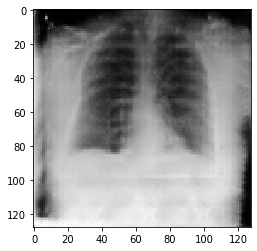

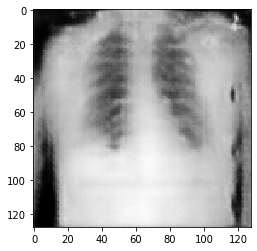

[22/51][120/236]	Loss_D: 1.0605	Loss_G: 1.8724	D(x): 0.7667	D(G(z)): 0.5357 / 0.1634
True


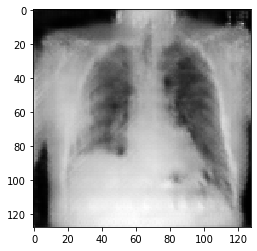

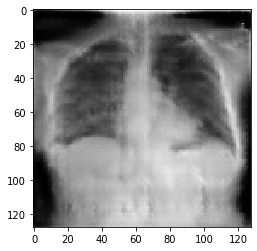

[22/51][140/236]	Loss_D: 1.3461	Loss_G: 1.2658	D(x): 0.4125	D(G(z)): 0.3436 / 0.2934
True


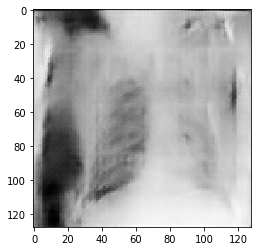

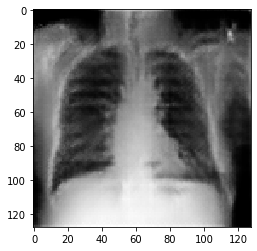

[22/51][160/236]	Loss_D: 1.0089	Loss_G: 1.8456	D(x): 0.7166	D(G(z)): 0.4715 / 0.1674
True


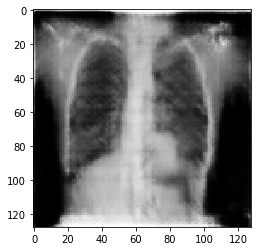

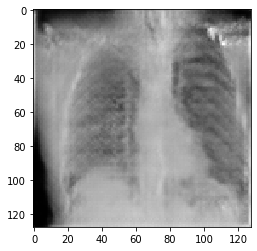

[22/51][180/236]	Loss_D: 1.5705	Loss_G: 1.5146	D(x): 0.5009	D(G(z)): 0.5614 / 0.2558
True


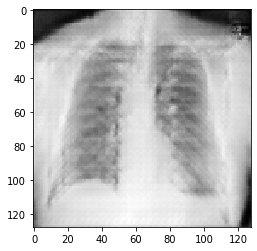

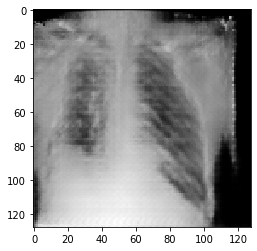

[22/51][200/236]	Loss_D: 1.2363	Loss_G: 1.0108	D(x): 0.4686	D(G(z)): 0.3537 / 0.3872
True


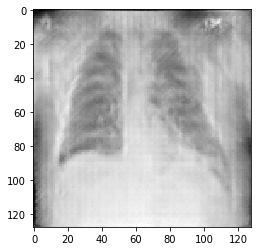

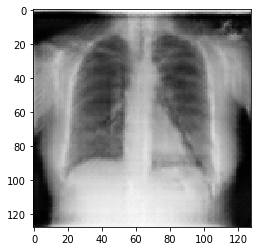

[22/51][220/236]	Loss_D: 1.3200	Loss_G: 1.1501	D(x): 0.4606	D(G(z)): 0.3943 / 0.3299



True


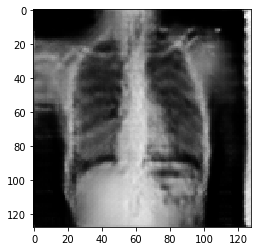

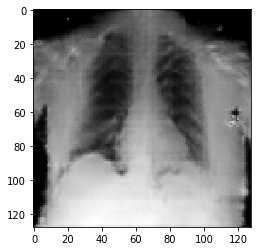

[23/51][0/236]	Loss_D: 1.4649	Loss_G: 0.9928	D(x): 0.5039	D(G(z)): 0.5141 / 0.3856
True


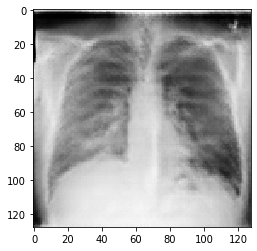

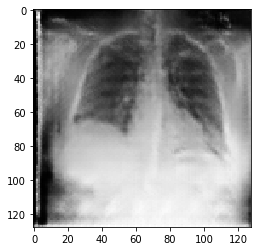

[23/51][20/236]	Loss_D: 1.2744	Loss_G: 0.9749	D(x): 0.4195	D(G(z)): 0.3025 / 0.3933
True


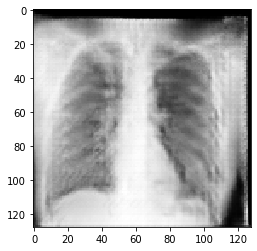

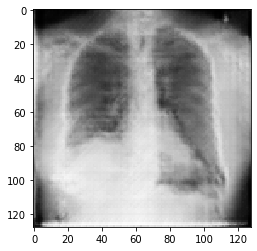

[23/51][40/236]	Loss_D: 1.3383	Loss_G: 1.0473	D(x): 0.4916	D(G(z)): 0.4406 / 0.3599
True


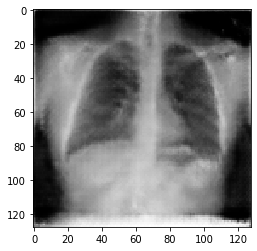

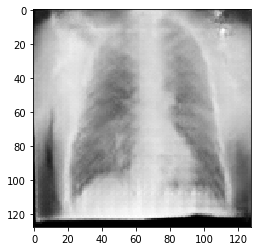

[23/51][60/236]	Loss_D: 1.3923	Loss_G: 1.0980	D(x): 0.4405	D(G(z)): 0.4148 / 0.3463
True


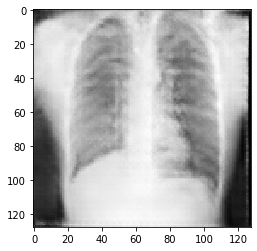

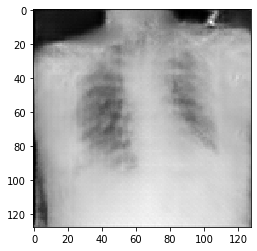

[23/51][80/236]	Loss_D: 1.6755	Loss_G: 0.9934	D(x): 0.5730	D(G(z)): 0.6540 / 0.3890
True


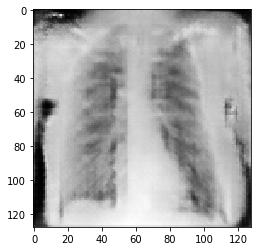

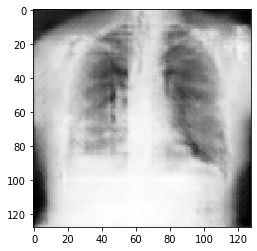

[23/51][100/236]	Loss_D: 1.4378	Loss_G: 1.5677	D(x): 0.5869	D(G(z)): 0.5739 / 0.2192
True


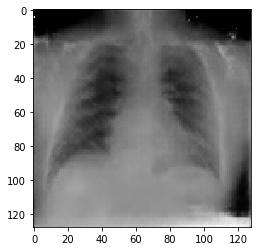

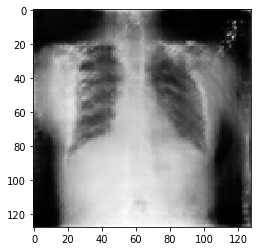

[23/51][120/236]	Loss_D: 1.3602	Loss_G: 1.1415	D(x): 0.4862	D(G(z)): 0.4521 / 0.3300
True


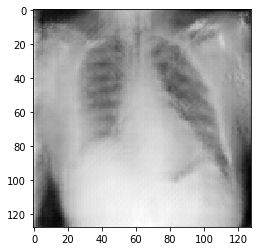

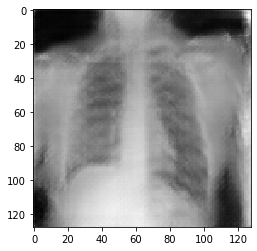

[23/51][140/236]	Loss_D: 1.0653	Loss_G: 1.1771	D(x): 0.5353	D(G(z)): 0.3248 / 0.3227
True


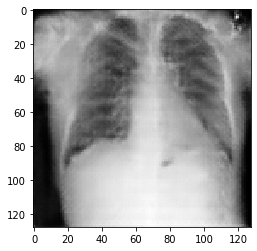

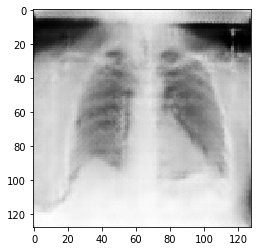

[23/51][160/236]	Loss_D: 1.0190	Loss_G: 1.2714	D(x): 0.5691	D(G(z)): 0.3472 / 0.2916
True


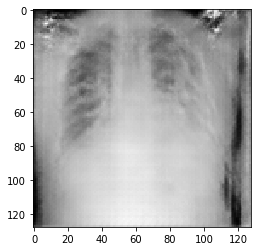

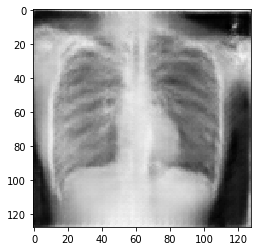

[23/51][180/236]	Loss_D: 1.4848	Loss_G: 0.9216	D(x): 0.4922	D(G(z)): 0.5099 / 0.4155
True


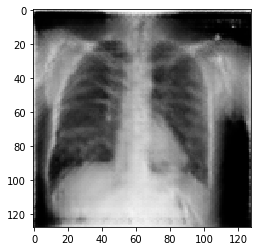

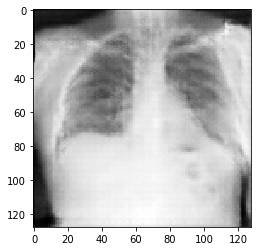

[23/51][200/236]	Loss_D: 1.4272	Loss_G: 0.7119	D(x): 0.5077	D(G(z)): 0.5018 / 0.5015
True


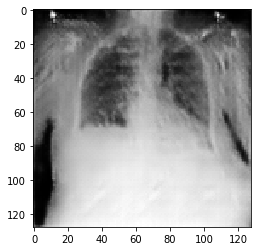

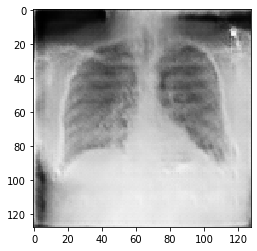

[23/51][220/236]	Loss_D: 1.5739	Loss_G: 1.2701	D(x): 0.5376	D(G(z)): 0.5913 / 0.2970



True


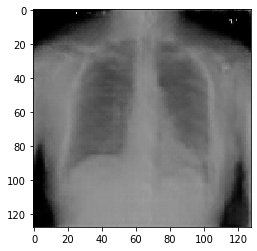

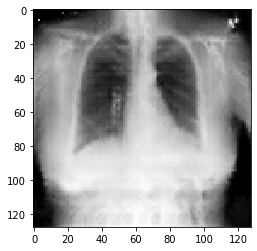

[24/51][0/236]	Loss_D: 1.5902	Loss_G: 0.8262	D(x): 0.4441	D(G(z)): 0.5196 / 0.4464
True


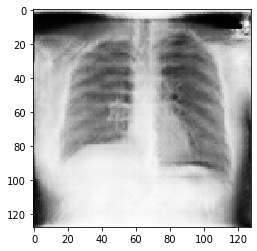

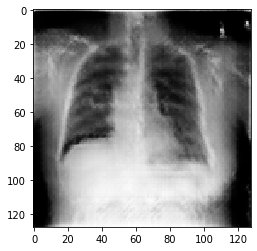

[24/51][20/236]	Loss_D: 1.2398	Loss_G: 0.8766	D(x): 0.5536	D(G(z)): 0.4618 / 0.4272
True


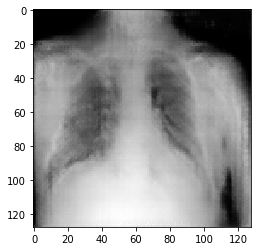

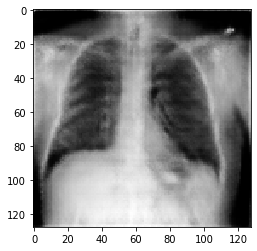

[24/51][40/236]	Loss_D: 0.9925	Loss_G: 1.0403	D(x): 0.6081	D(G(z)): 0.3773 / 0.3666
True


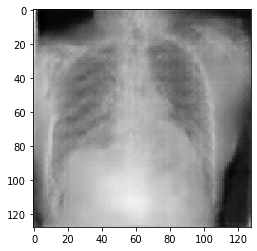

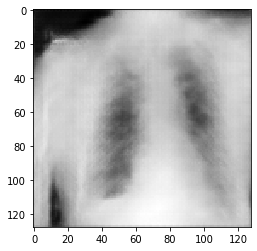

[24/51][60/236]	Loss_D: 1.3260	Loss_G: 0.7907	D(x): 0.4142	D(G(z)): 0.3221 / 0.4640
True


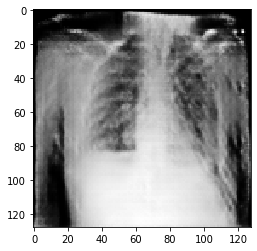

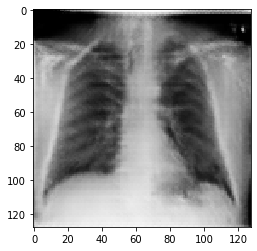

[24/51][80/236]	Loss_D: 1.3151	Loss_G: 1.3392	D(x): 0.5320	D(G(z)): 0.4735 / 0.2750
True


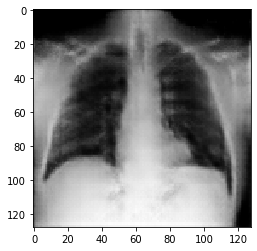

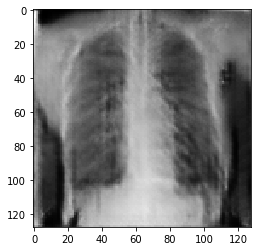

[24/51][100/236]	Loss_D: 1.1237	Loss_G: 1.2356	D(x): 0.5321	D(G(z)): 0.3626 / 0.3015
True


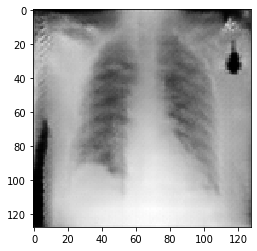

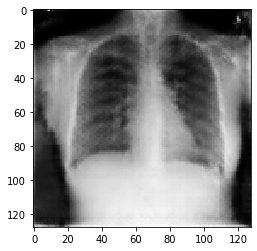

[24/51][120/236]	Loss_D: 1.3199	Loss_G: 0.7793	D(x): 0.5564	D(G(z)): 0.4965 / 0.4741
True


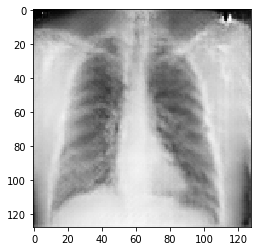

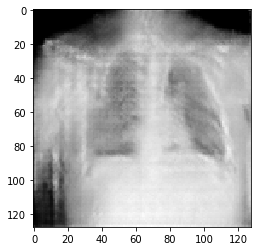

[24/51][140/236]	Loss_D: 1.1546	Loss_G: 1.2408	D(x): 0.5380	D(G(z)): 0.3976 / 0.2998
True


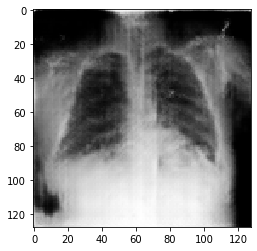

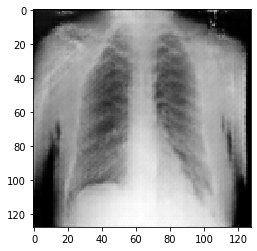

[24/51][160/236]	Loss_D: 1.1879	Loss_G: 1.0303	D(x): 0.6030	D(G(z)): 0.4714 / 0.3670
True


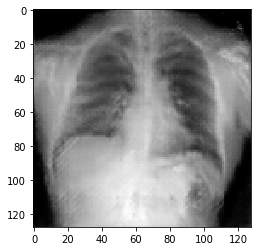

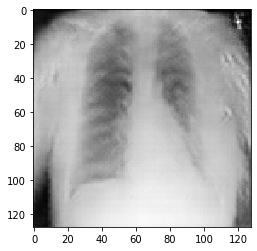

[24/51][180/236]	Loss_D: 1.0785	Loss_G: 1.2334	D(x): 0.6774	D(G(z)): 0.4854 / 0.3045
True


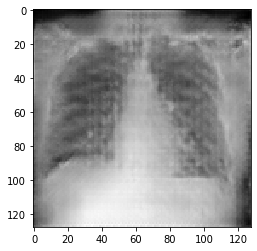

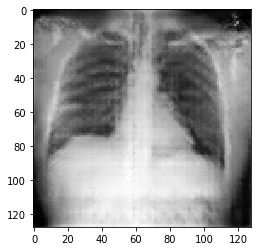

[24/51][200/236]	Loss_D: 1.2904	Loss_G: 1.2695	D(x): 0.5614	D(G(z)): 0.4960 / 0.2908
True


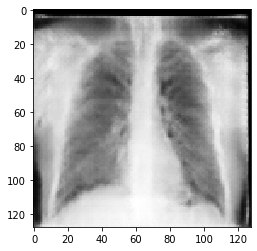

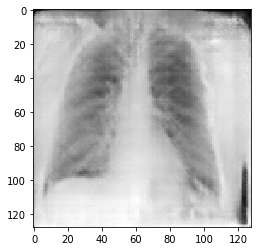

[24/51][220/236]	Loss_D: 1.1828	Loss_G: 1.1549	D(x): 0.5155	D(G(z)): 0.3899 / 0.3250



True


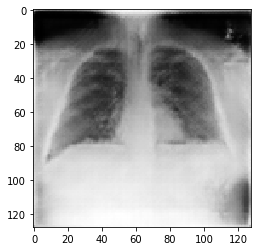

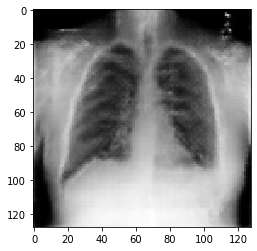

[25/51][0/236]	Loss_D: 1.2051	Loss_G: 1.1847	D(x): 0.6956	D(G(z)): 0.5557 / 0.3216
True


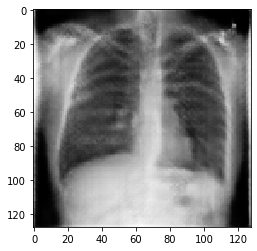

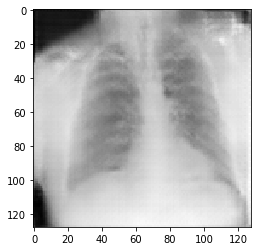

[25/51][20/236]	Loss_D: 1.1930	Loss_G: 1.0859	D(x): 0.5288	D(G(z)): 0.4050 / 0.3615
True


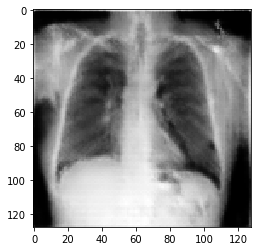

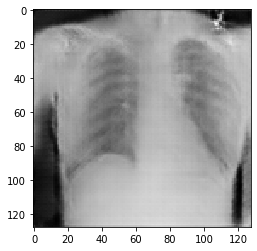

[25/51][40/236]	Loss_D: 1.1536	Loss_G: 1.2486	D(x): 0.6522	D(G(z)): 0.5047 / 0.2969
True


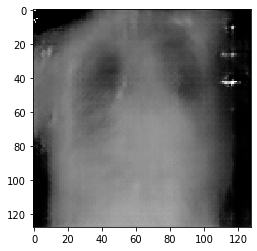

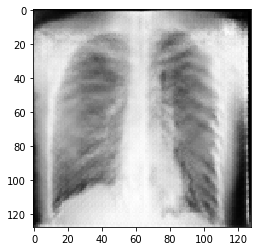

[25/51][60/236]	Loss_D: 0.9102	Loss_G: 1.5434	D(x): 0.5428	D(G(z)): 0.2280 / 0.2394
True


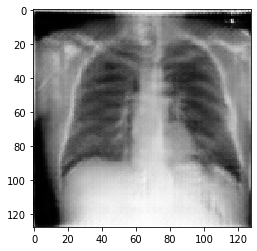

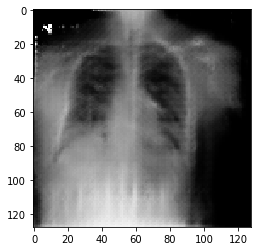

[25/51][80/236]	Loss_D: 1.2981	Loss_G: 3.2541	D(x): 0.7467	D(G(z)): 0.6088 / 0.0546
True


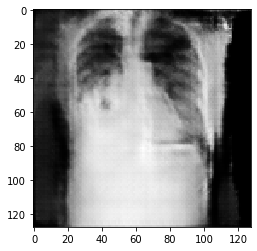

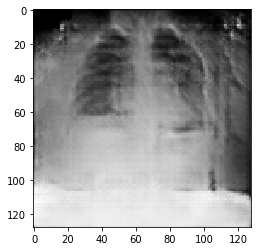

[25/51][100/236]	Loss_D: 1.1587	Loss_G: 1.4665	D(x): 0.5772	D(G(z)): 0.4314 / 0.2438
True


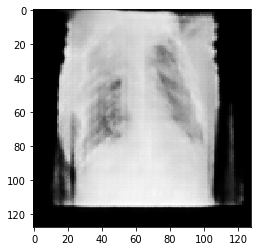

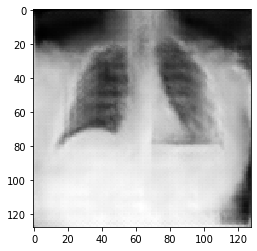

[25/51][120/236]	Loss_D: 1.0984	Loss_G: 1.5185	D(x): 0.6848	D(G(z)): 0.4976 / 0.2297
True


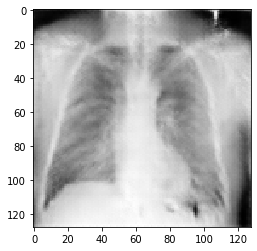

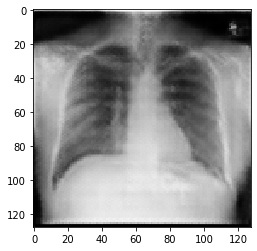

[25/51][140/236]	Loss_D: 1.2854	Loss_G: 1.0999	D(x): 0.5218	D(G(z)): 0.4513 / 0.3441
True


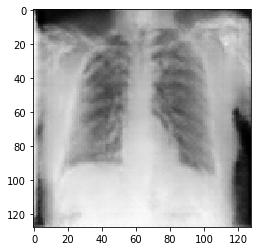

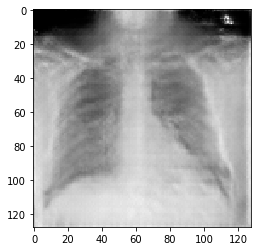

[25/51][160/236]	Loss_D: 0.8076	Loss_G: 1.6490	D(x): 0.6893	D(G(z)): 0.3419 / 0.2068
True


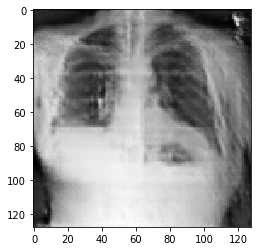

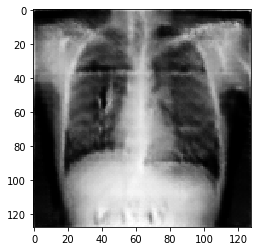

[25/51][180/236]	Loss_D: 0.8693	Loss_G: 1.9528	D(x): 0.7807	D(G(z)): 0.4474 / 0.1636
True


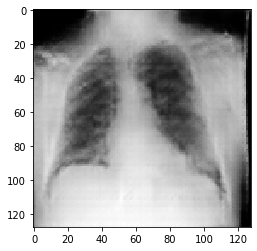

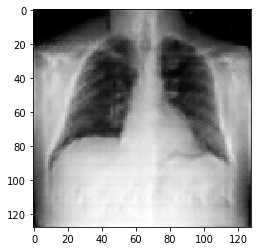

[25/51][200/236]	Loss_D: 1.5956	Loss_G: 1.1457	D(x): 0.5813	D(G(z)): 0.6269 / 0.3322
True


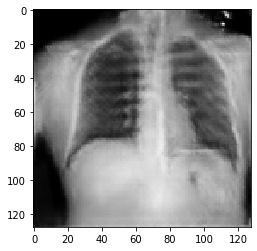

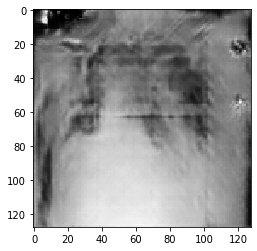

[25/51][220/236]	Loss_D: 1.2499	Loss_G: 1.4162	D(x): 0.7637	D(G(z)): 0.6045 / 0.2534



True


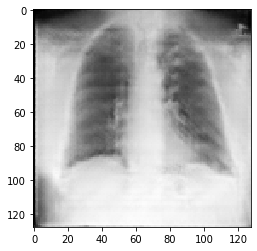

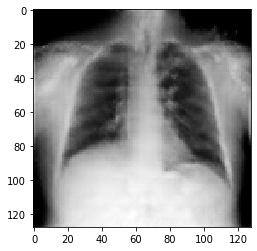

[26/51][0/236]	Loss_D: 1.0463	Loss_G: 1.1563	D(x): 0.5548	D(G(z)): 0.3416 / 0.3257
True


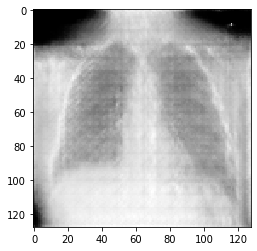

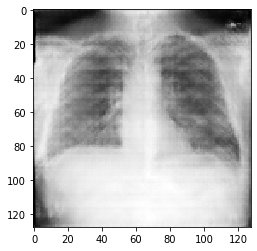

[26/51][20/236]	Loss_D: 1.3277	Loss_G: 0.9958	D(x): 0.5769	D(G(z)): 0.5088 / 0.3976
True


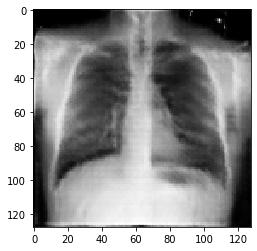

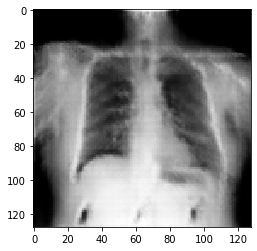

[26/51][40/236]	Loss_D: 1.3051	Loss_G: 1.2149	D(x): 0.4974	D(G(z)): 0.4344 / 0.3186
True


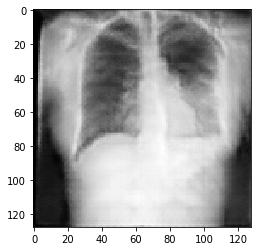

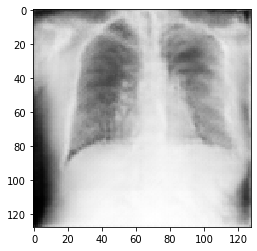

[26/51][60/236]	Loss_D: 1.1673	Loss_G: 1.2696	D(x): 0.5328	D(G(z)): 0.3933 / 0.2923
True


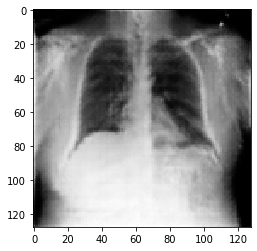

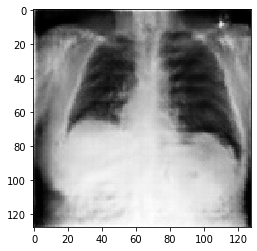

[26/51][80/236]	Loss_D: 1.2411	Loss_G: 1.0812	D(x): 0.5319	D(G(z)): 0.4368 / 0.3509
True


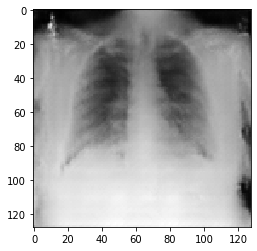

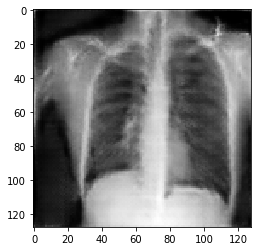

[26/51][100/236]	Loss_D: 0.9197	Loss_G: 2.1536	D(x): 0.8879	D(G(z)): 0.5392 / 0.1277
True


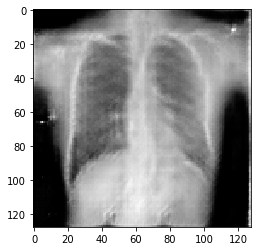

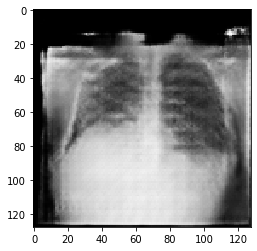

[26/51][120/236]	Loss_D: 1.0533	Loss_G: 1.1971	D(x): 0.6734	D(G(z)): 0.4642 / 0.3160
True


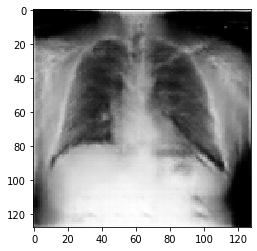

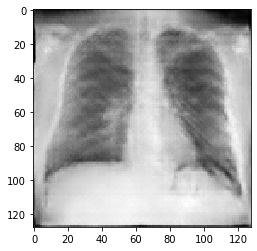

[26/51][140/236]	Loss_D: 1.5393	Loss_G: 1.3258	D(x): 0.6007	D(G(z)): 0.6177 / 0.2801
True


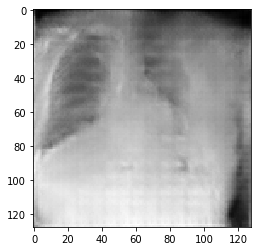

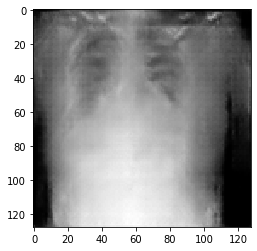

[26/51][160/236]	Loss_D: 1.2644	Loss_G: 1.1810	D(x): 0.6296	D(G(z)): 0.5199 / 0.3369
True


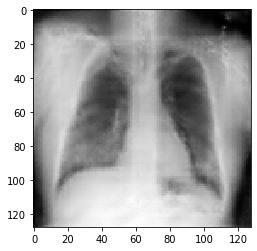

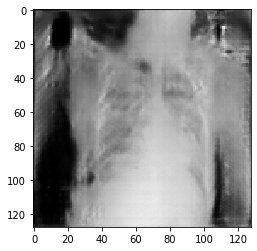

[26/51][180/236]	Loss_D: 1.0880	Loss_G: 1.5045	D(x): 0.7233	D(G(z)): 0.5211 / 0.2345
True


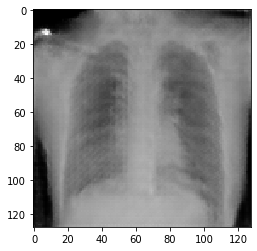

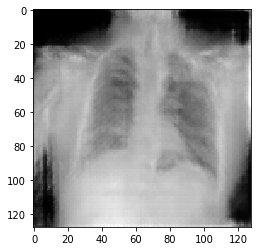

[26/51][200/236]	Loss_D: 1.4860	Loss_G: 1.1975	D(x): 0.4338	D(G(z)): 0.4487 / 0.3172
True


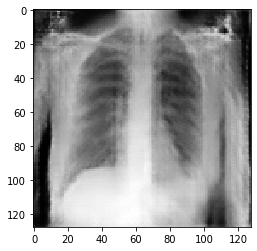

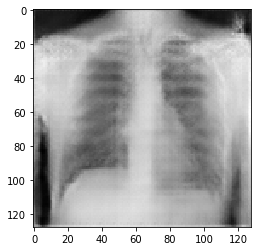

[26/51][220/236]	Loss_D: 1.3418	Loss_G: 1.2806	D(x): 0.7978	D(G(z)): 0.6551 / 0.2905



True


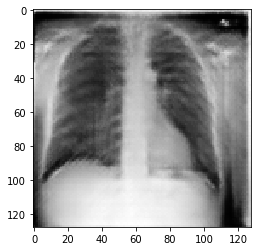

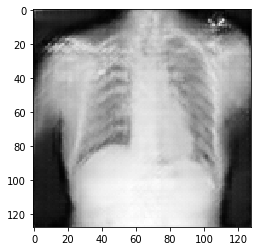

[27/51][0/236]	Loss_D: 1.1715	Loss_G: 1.0676	D(x): 0.5825	D(G(z)): 0.4507 / 0.3573
True


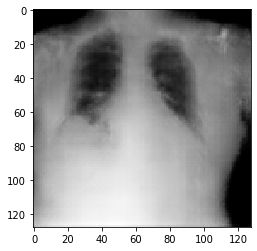

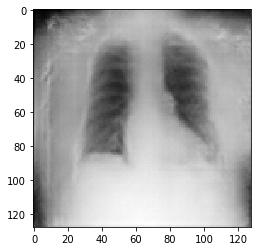

[27/51][20/236]	Loss_D: 1.4460	Loss_G: 1.3878	D(x): 0.6192	D(G(z)): 0.6000 / 0.2681
True


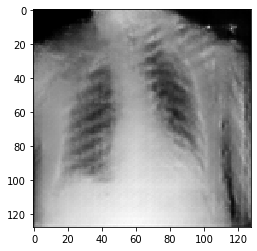

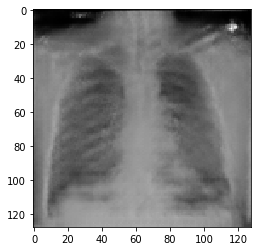

[27/51][40/236]	Loss_D: 1.1810	Loss_G: 1.1781	D(x): 0.5821	D(G(z)): 0.4535 / 0.3198
True


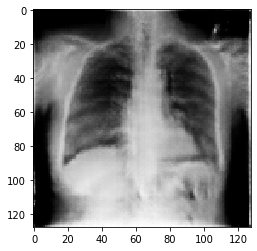

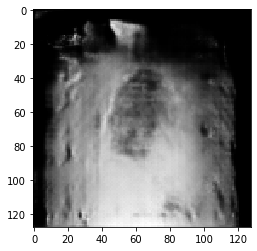

[27/51][60/236]	Loss_D: 1.6469	Loss_G: 0.8407	D(x): 0.2919	D(G(z)): 0.2946 / 0.4411
True


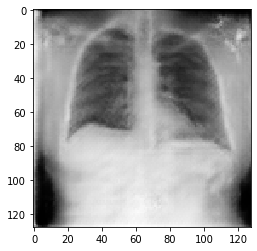

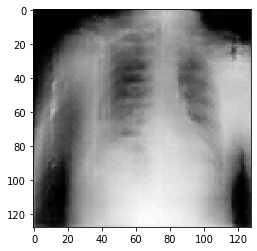

[27/51][80/236]	Loss_D: 1.0643	Loss_G: 0.9653	D(x): 0.5833	D(G(z)): 0.3923 / 0.3925
True


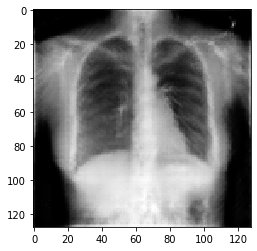

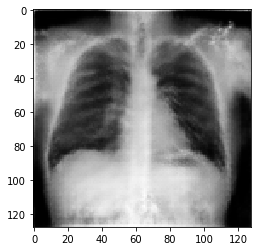

[27/51][100/236]	Loss_D: 1.0851	Loss_G: 1.3857	D(x): 0.7333	D(G(z)): 0.5245 / 0.2656
True


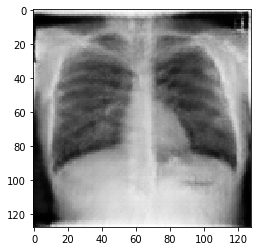

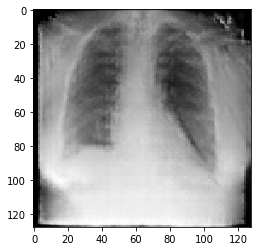

[27/51][120/236]	Loss_D: 1.3682	Loss_G: 1.0450	D(x): 0.5278	D(G(z)): 0.4961 / 0.3641
True


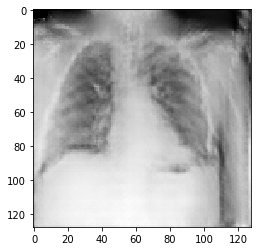

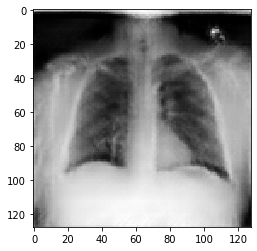

[27/51][140/236]	Loss_D: 0.9842	Loss_G: 1.4711	D(x): 0.5442	D(G(z)): 0.2934 / 0.2434
True


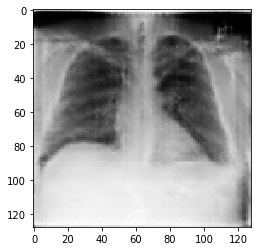

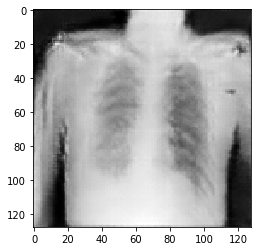

[27/51][160/236]	Loss_D: 1.2346	Loss_G: 1.1696	D(x): 0.5507	D(G(z)): 0.4510 / 0.3223
True


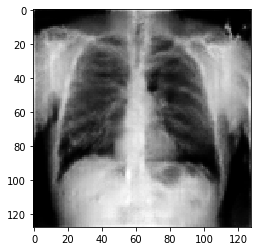

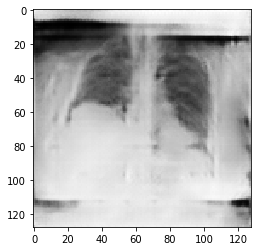

[27/51][180/236]	Loss_D: 1.1446	Loss_G: 1.3075	D(x): 0.6957	D(G(z)): 0.5257 / 0.2889
True


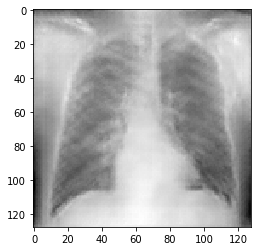

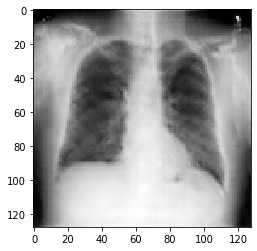

[27/51][200/236]	Loss_D: 1.3384	Loss_G: 1.2314	D(x): 0.7780	D(G(z)): 0.6451 / 0.3087
True


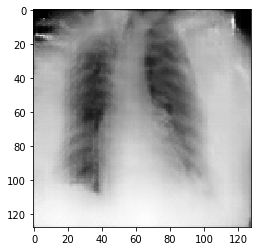

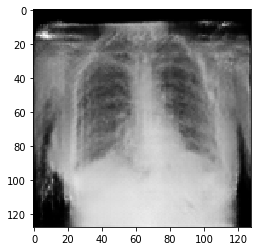

[27/51][220/236]	Loss_D: 1.4442	Loss_G: 0.8791	D(x): 0.5079	D(G(z)): 0.5174 / 0.4246



True


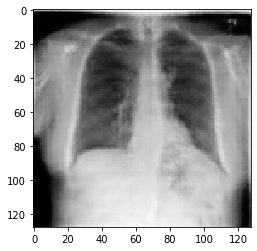

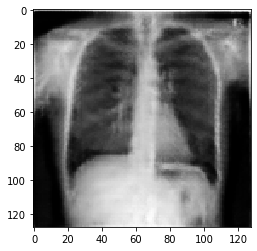

[28/51][0/236]	Loss_D: 1.2467	Loss_G: 1.3500	D(x): 0.5550	D(G(z)): 0.4641 / 0.2689
True


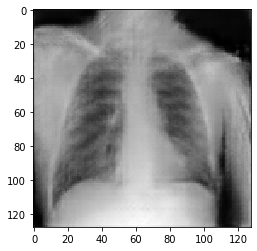

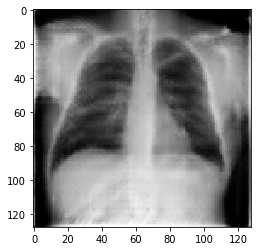

[28/51][20/236]	Loss_D: 1.1272	Loss_G: 1.1727	D(x): 0.5950	D(G(z)): 0.4366 / 0.3243
True


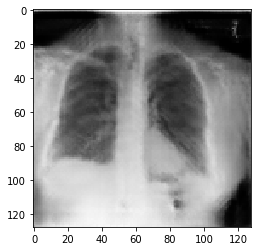

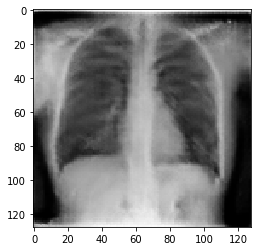

[28/51][40/236]	Loss_D: 0.9032	Loss_G: 1.4033	D(x): 0.6071	D(G(z)): 0.3172 / 0.2636
True


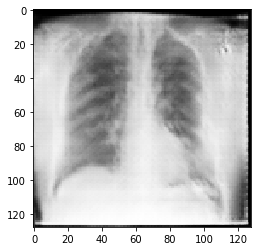

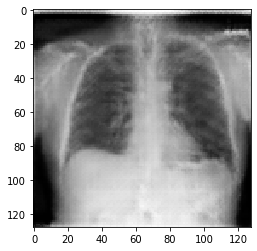

[28/51][60/236]	Loss_D: 1.3502	Loss_G: 0.9286	D(x): 0.5037	D(G(z)): 0.4551 / 0.4146
True


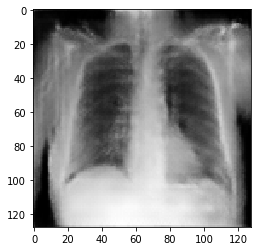

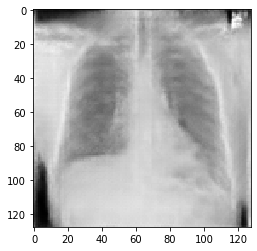

[28/51][80/236]	Loss_D: 1.8037	Loss_G: 0.8589	D(x): 0.2732	D(G(z)): 0.3477 / 0.4351
True


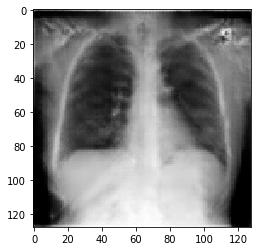

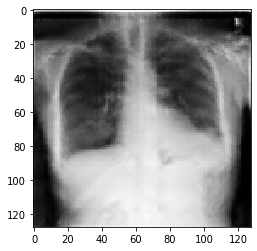

[28/51][100/236]	Loss_D: 0.9044	Loss_G: 1.4164	D(x): 0.7349	D(G(z)): 0.4292 / 0.2645
True


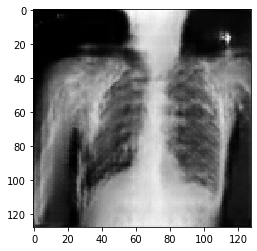

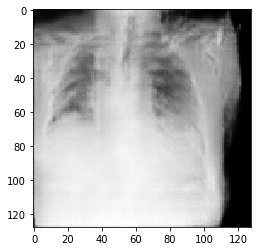

[28/51][120/236]	Loss_D: 1.1394	Loss_G: 1.4563	D(x): 0.6490	D(G(z)): 0.4713 / 0.2502
True


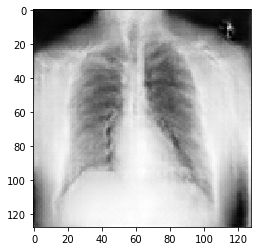

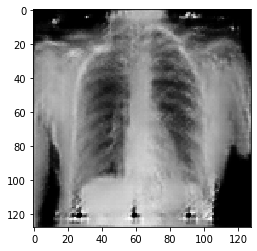

[28/51][140/236]	Loss_D: 1.2522	Loss_G: 1.1969	D(x): 0.4767	D(G(z)): 0.3725 / 0.3280
True


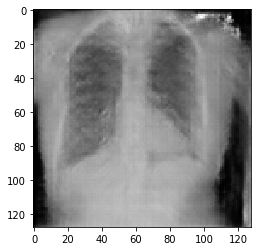

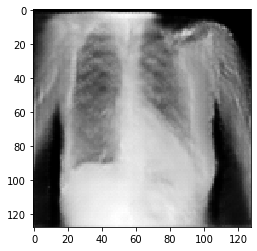

[28/51][160/236]	Loss_D: 0.8917	Loss_G: 1.3272	D(x): 0.8189	D(G(z)): 0.4876 / 0.2772
True


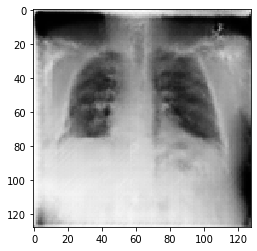

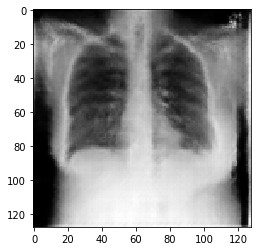

[28/51][180/236]	Loss_D: 1.0120	Loss_G: 1.0755	D(x): 0.6233	D(G(z)): 0.4021 / 0.3544
True


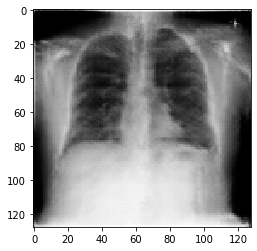

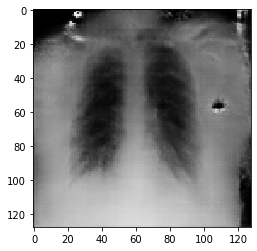

[28/51][200/236]	Loss_D: 1.3740	Loss_G: 0.9669	D(x): 0.4445	D(G(z)): 0.4041 / 0.3939
True


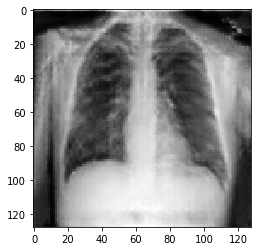

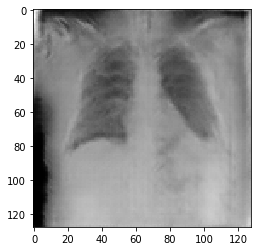

[28/51][220/236]	Loss_D: 1.8180	Loss_G: 1.0583	D(x): 0.7199	D(G(z)): 0.7560 / 0.3601



True


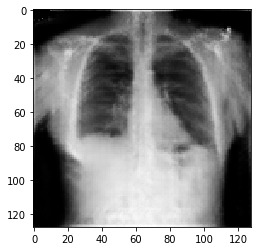

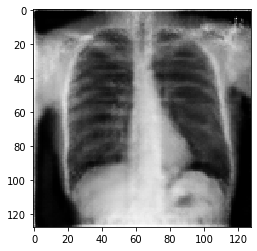

[29/51][0/236]	Loss_D: 1.2093	Loss_G: 1.3709	D(x): 0.5111	D(G(z)): 0.3888 / 0.2736
True


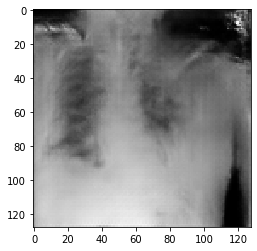

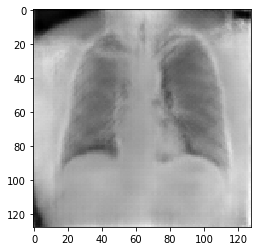

[29/51][20/236]	Loss_D: 1.2087	Loss_G: 1.0265	D(x): 0.4584	D(G(z)): 0.3217 / 0.3751
True


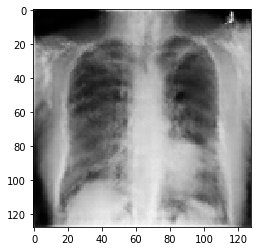

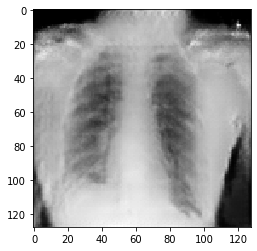

[29/51][40/236]	Loss_D: 1.4040	Loss_G: 1.3222	D(x): 0.5740	D(G(z)): 0.5474 / 0.2883
True


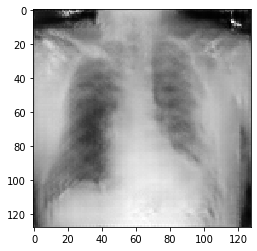

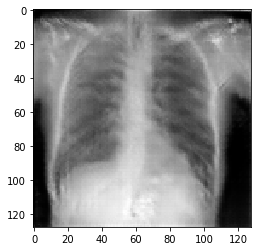

[29/51][60/236]	Loss_D: 0.6324	Loss_G: 2.0515	D(x): 0.6402	D(G(z)): 0.1552 / 0.1416
True


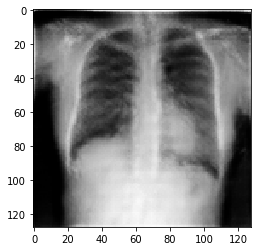

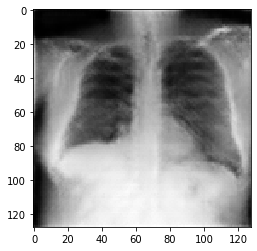

[29/51][80/236]	Loss_D: 1.3926	Loss_G: 1.0517	D(x): 0.5346	D(G(z)): 0.5081 / 0.3717
True


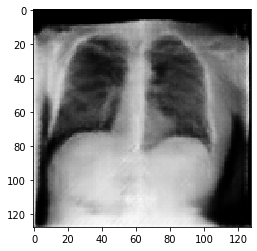

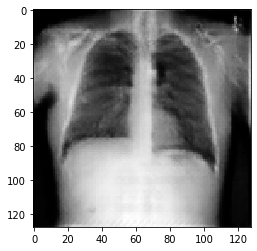

[29/51][100/236]	Loss_D: 1.1291	Loss_G: 1.0369	D(x): 0.4955	D(G(z)): 0.2995 / 0.3862
True


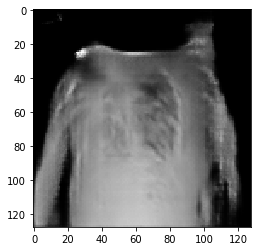

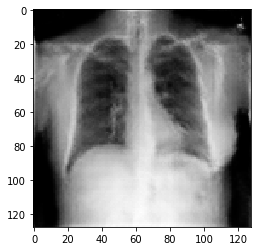

[29/51][120/236]	Loss_D: 1.1112	Loss_G: 1.1169	D(x): 0.6558	D(G(z)): 0.4827 / 0.3382
True


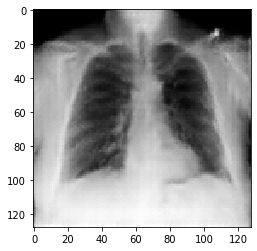

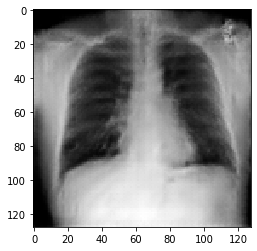

[29/51][140/236]	Loss_D: 1.2158	Loss_G: 1.0131	D(x): 0.5747	D(G(z)): 0.4498 / 0.3840
True


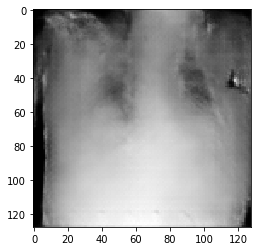

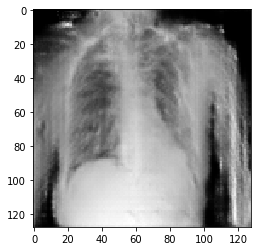

[29/51][160/236]	Loss_D: 1.0616	Loss_G: 1.0764	D(x): 0.4894	D(G(z)): 0.2661 / 0.3583
True


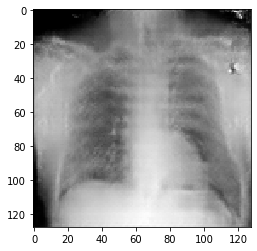

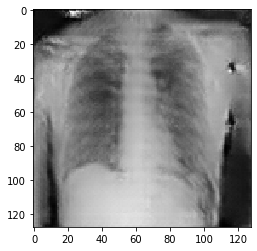

[29/51][180/236]	Loss_D: 1.7324	Loss_G: 0.9413	D(x): 0.4453	D(G(z)): 0.5682 / 0.4103
True


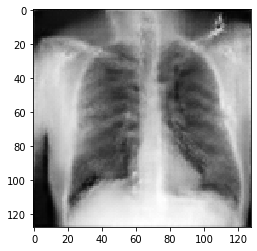

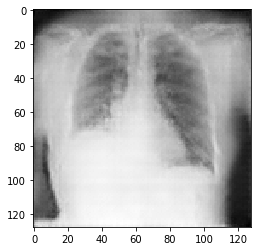

[29/51][200/236]	Loss_D: 1.0319	Loss_G: 1.3047	D(x): 0.5492	D(G(z)): 0.3303 / 0.2861
True


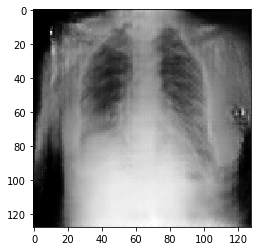

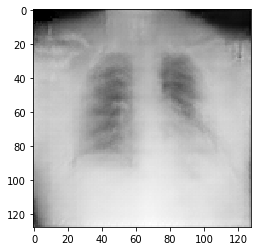

[29/51][220/236]	Loss_D: 1.2921	Loss_G: 1.0865	D(x): 0.5458	D(G(z)): 0.4760 / 0.3505



True


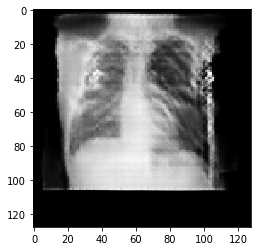

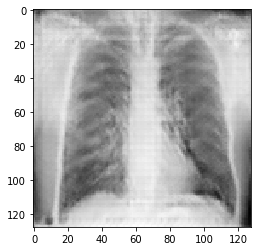

[30/51][0/236]	Loss_D: 1.0234	Loss_G: 1.6548	D(x): 0.5911	D(G(z)): 0.3734 / 0.2056
True


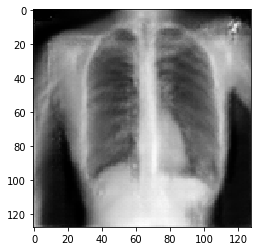

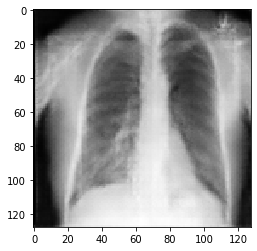

[30/51][20/236]	Loss_D: 1.0966	Loss_G: 1.0657	D(x): 0.6427	D(G(z)): 0.4639 / 0.3593
True


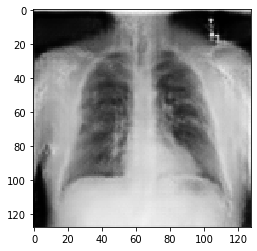

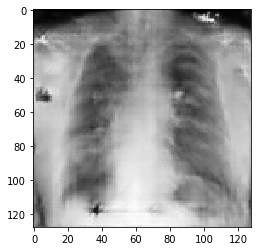

[30/51][40/236]	Loss_D: 1.5612	Loss_G: 0.5113	D(x): 0.3769	D(G(z)): 0.4132 / 0.6068
True


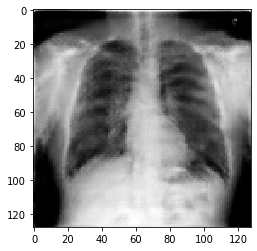

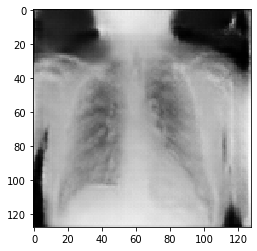

[30/51][60/236]	Loss_D: 0.9064	Loss_G: 1.1271	D(x): 0.7345	D(G(z)): 0.4341 / 0.3335
True


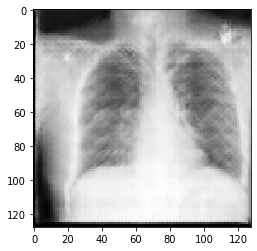

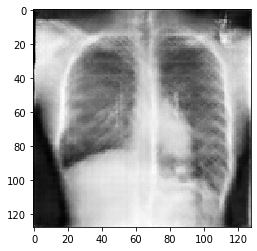

[30/51][80/236]	Loss_D: 0.9794	Loss_G: 1.1513	D(x): 0.6018	D(G(z)): 0.3553 / 0.3330
True


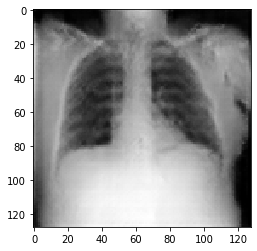

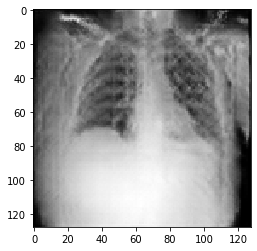

[30/51][100/236]	Loss_D: 1.1572	Loss_G: 1.0042	D(x): 0.5809	D(G(z)): 0.4353 / 0.3820
True


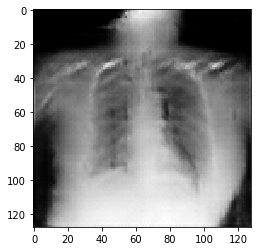

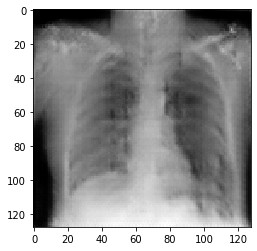

[30/51][120/236]	Loss_D: 1.3465	Loss_G: 1.6721	D(x): 0.6982	D(G(z)): 0.5928 / 0.2110
True


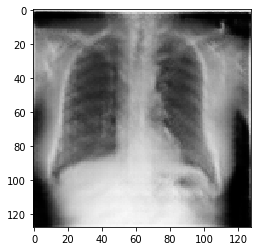

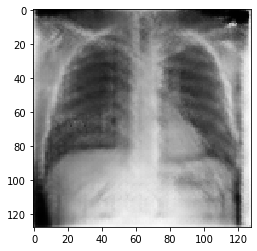

[30/51][140/236]	Loss_D: 1.0918	Loss_G: 1.4125	D(x): 0.5580	D(G(z)): 0.3715 / 0.2614
True


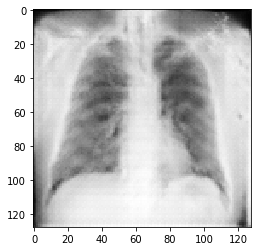

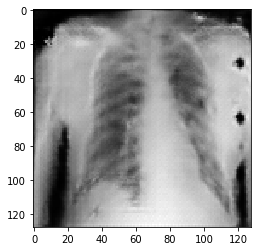

[30/51][160/236]	Loss_D: 0.9959	Loss_G: 1.5232	D(x): 0.6012	D(G(z)): 0.3602 / 0.2412
True


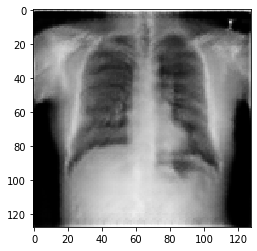

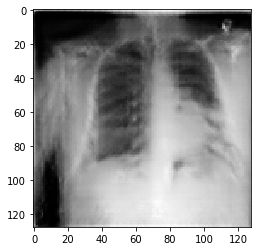

[30/51][180/236]	Loss_D: 1.0093	Loss_G: 1.6044	D(x): 0.6955	D(G(z)): 0.4553 / 0.2178
True


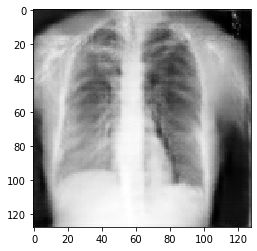

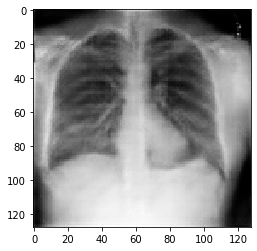

[30/51][200/236]	Loss_D: 1.5184	Loss_G: 0.9924	D(x): 0.3921	D(G(z)): 0.3903 / 0.3913
True


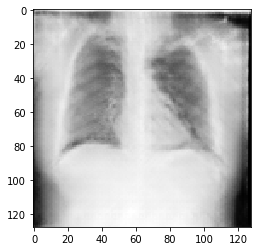

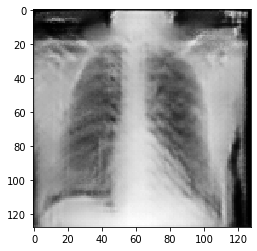

[30/51][220/236]	Loss_D: 1.1308	Loss_G: 1.5665	D(x): 0.7128	D(G(z)): 0.5301 / 0.2195



True


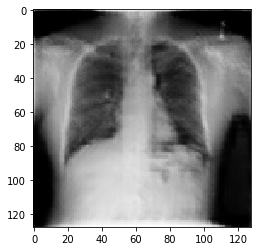

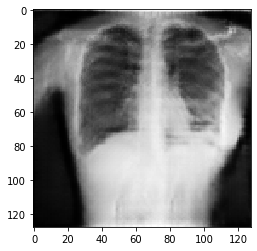

[31/51][0/236]	Loss_D: 1.0325	Loss_G: 1.4332	D(x): 0.6508	D(G(z)): 0.4296 / 0.2513
True


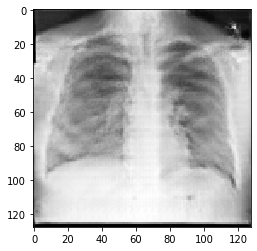

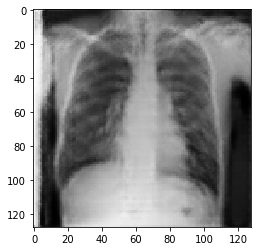

[31/51][20/236]	Loss_D: 1.2406	Loss_G: 1.0025	D(x): 0.5109	D(G(z)): 0.4094 / 0.3773
True


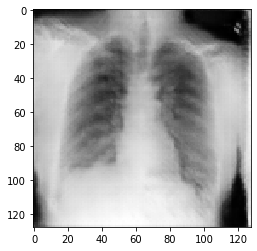

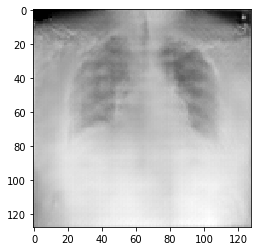

[31/51][40/236]	Loss_D: 1.2987	Loss_G: 0.9538	D(x): 0.4222	D(G(z)): 0.3171 / 0.4004
True


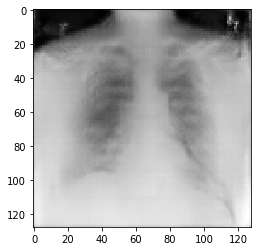

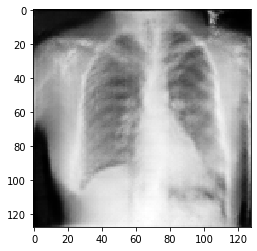

[31/51][60/236]	Loss_D: 1.1752	Loss_G: 0.9602	D(x): 0.5122	D(G(z)): 0.3640 / 0.4077
True


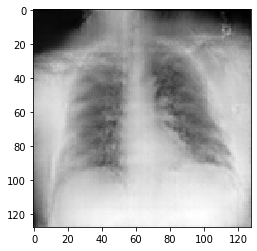

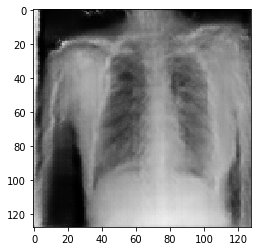

[31/51][80/236]	Loss_D: 1.0179	Loss_G: 1.8058	D(x): 0.7141	D(G(z)): 0.4741 / 0.1784
True


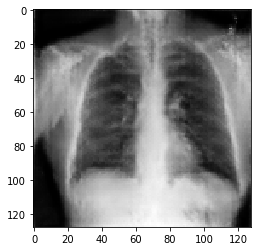

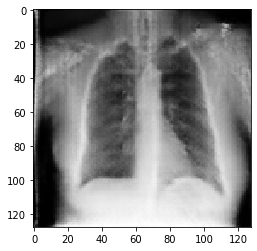

[31/51][100/236]	Loss_D: 1.2222	Loss_G: 1.2657	D(x): 0.4756	D(G(z)): 0.3462 / 0.2966
True


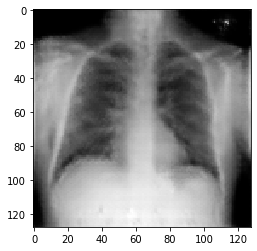

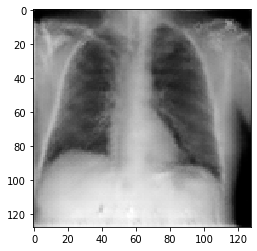

[31/51][120/236]	Loss_D: 1.1893	Loss_G: 1.8974	D(x): 0.6666	D(G(z)): 0.5276 / 0.1626
True


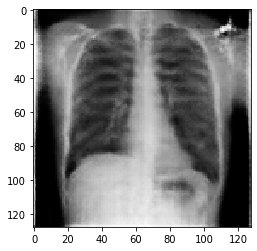

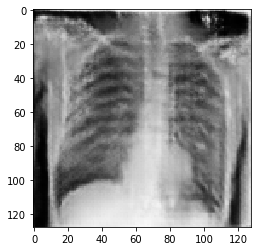

[31/51][140/236]	Loss_D: 1.0142	Loss_G: 1.3739	D(x): 0.6942	D(G(z)): 0.4626 / 0.2664
True


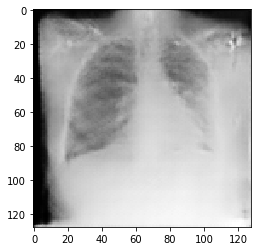

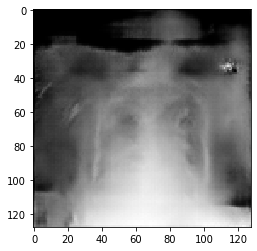

[31/51][160/236]	Loss_D: 0.8440	Loss_G: 1.7241	D(x): 0.6110	D(G(z)): 0.2751 / 0.1944
True


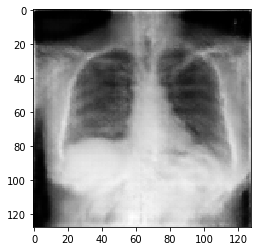

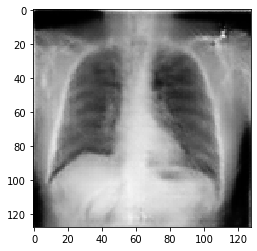

[31/51][180/236]	Loss_D: 1.2318	Loss_G: 1.0151	D(x): 0.5398	D(G(z)): 0.4265 / 0.3740
True


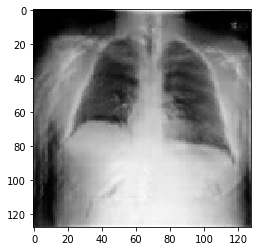

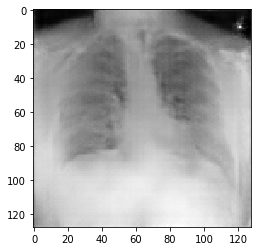

[31/51][200/236]	Loss_D: 1.2642	Loss_G: 0.6804	D(x): 0.5220	D(G(z)): 0.4347 / 0.5167
True


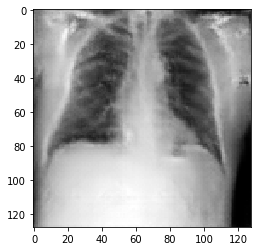

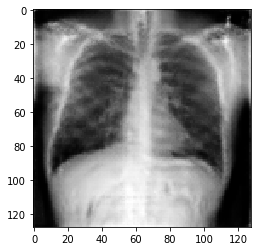

[31/51][220/236]	Loss_D: 1.2964	Loss_G: 1.0698	D(x): 0.6571	D(G(z)): 0.5666 / 0.3557



True


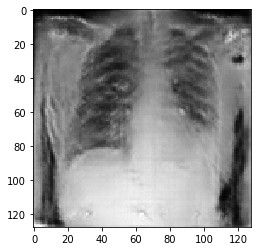

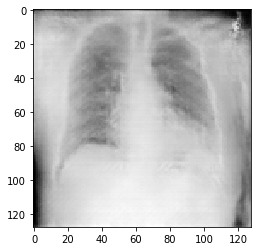

[32/51][0/236]	Loss_D: 1.5188	Loss_G: 1.0009	D(x): 0.5613	D(G(z)): 0.5895 / 0.3819
True


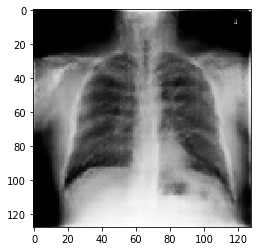

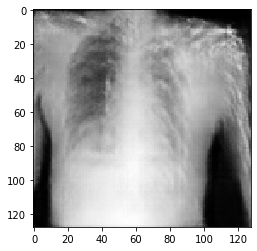

[32/51][20/236]	Loss_D: 1.2868	Loss_G: 1.0621	D(x): 0.4757	D(G(z)): 0.3911 / 0.3616
True


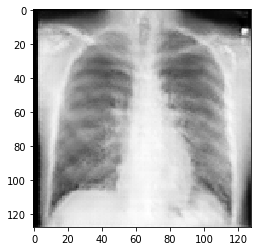

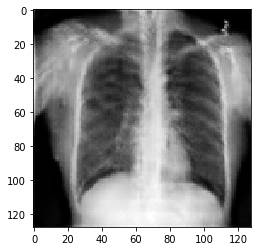

[32/51][40/236]	Loss_D: 1.4248	Loss_G: 1.0876	D(x): 0.3700	D(G(z)): 0.3137 / 0.3544
True


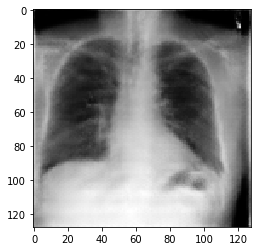

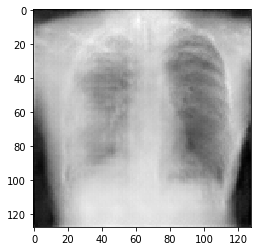

[32/51][60/236]	Loss_D: 1.2792	Loss_G: 1.1143	D(x): 0.4848	D(G(z)): 0.3976 / 0.3446
True


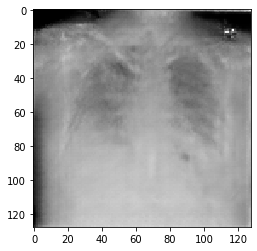

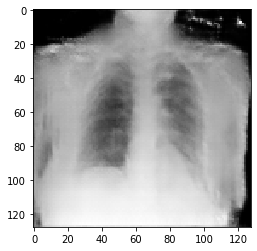

[32/51][80/236]	Loss_D: 0.9525	Loss_G: 1.7854	D(x): 0.7173	D(G(z)): 0.4469 / 0.1791
True


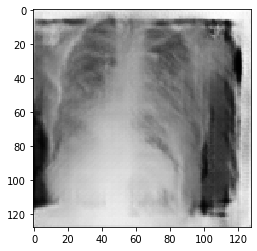

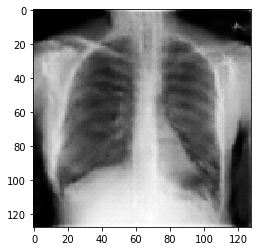

[32/51][100/236]	Loss_D: 1.3209	Loss_G: 1.2976	D(x): 0.5078	D(G(z)): 0.4378 / 0.2892
True


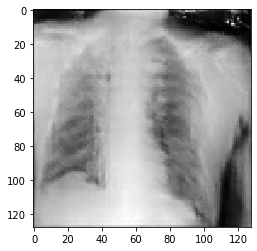

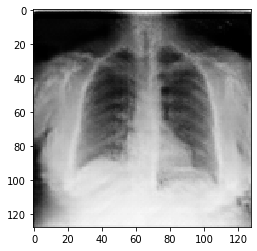

[32/51][120/236]	Loss_D: 0.9268	Loss_G: 1.7300	D(x): 0.6919	D(G(z)): 0.4110 / 0.1898
True


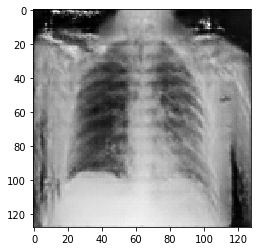

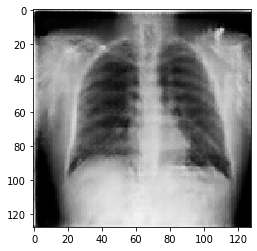

[32/51][140/236]	Loss_D: 0.9577	Loss_G: 1.5655	D(x): 0.7015	D(G(z)): 0.4383 / 0.2253
True


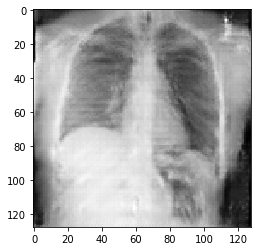

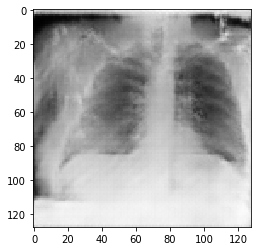

[32/51][160/236]	Loss_D: 1.4811	Loss_G: 0.6830	D(x): 0.3887	D(G(z)): 0.3731 / 0.5177
True


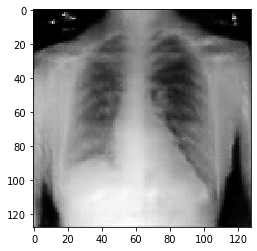

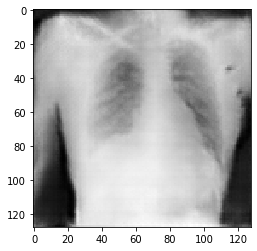

[32/51][180/236]	Loss_D: 1.0637	Loss_G: 1.3768	D(x): 0.5529	D(G(z)): 0.3473 / 0.2710
True


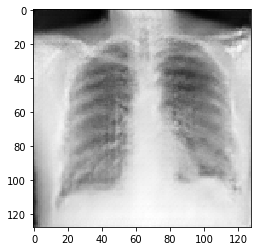

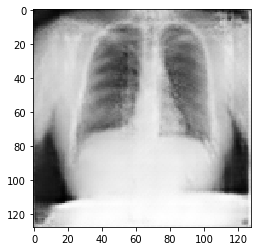

[32/51][200/236]	Loss_D: 1.3774	Loss_G: 1.1359	D(x): 0.5442	D(G(z)): 0.5101 / 0.3392
True


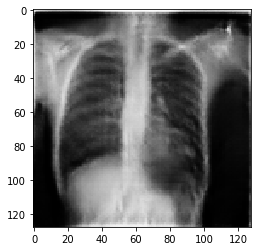

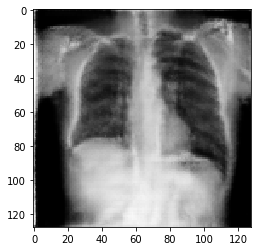

[32/51][220/236]	Loss_D: 1.3399	Loss_G: 1.1488	D(x): 0.5377	D(G(z)): 0.4882 / 0.3380



True


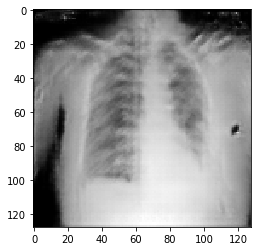

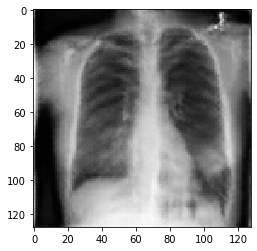

[33/51][0/236]	Loss_D: 1.1026	Loss_G: 1.7187	D(x): 0.7779	D(G(z)): 0.5578 / 0.1913
True


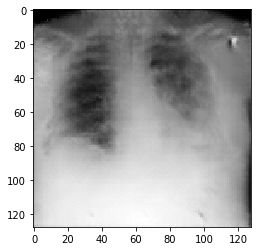

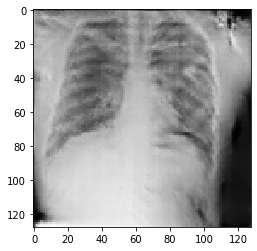

[33/51][20/236]	Loss_D: 1.2741	Loss_G: 1.1722	D(x): 0.5802	D(G(z)): 0.4946 / 0.3232
True


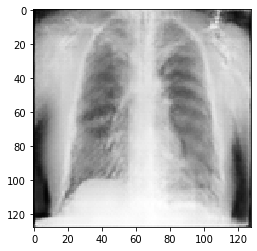

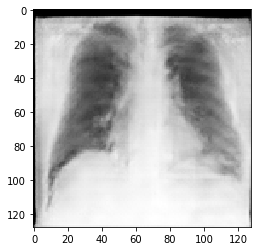

[33/51][40/236]	Loss_D: 1.4344	Loss_G: 0.8709	D(x): 0.3739	D(G(z)): 0.3242 / 0.4349
True


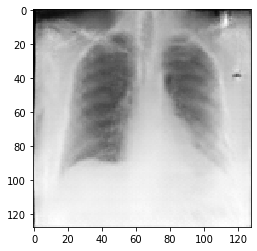

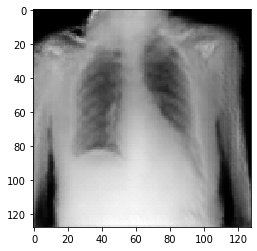

[33/51][60/236]	Loss_D: 1.1525	Loss_G: 0.9762	D(x): 0.5330	D(G(z)): 0.3834 / 0.3890
True


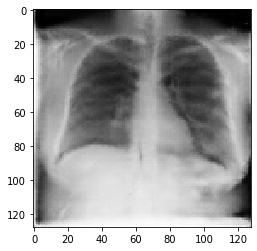

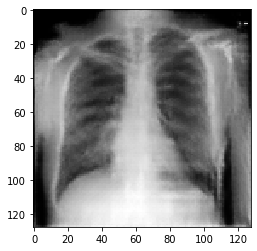

[33/51][80/236]	Loss_D: 1.2745	Loss_G: 1.3316	D(x): 0.4572	D(G(z)): 0.3586 / 0.2778
True


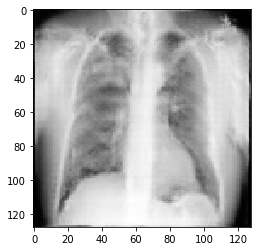

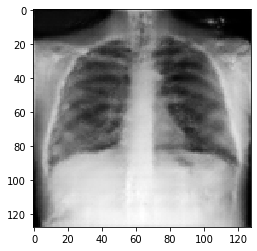

[33/51][100/236]	Loss_D: 1.2026	Loss_G: 1.0381	D(x): 0.5004	D(G(z)): 0.3744 / 0.3677
True


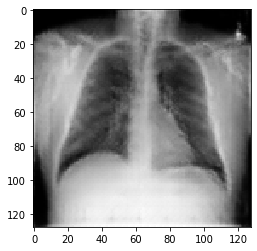

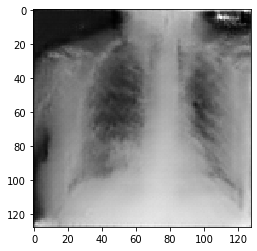

[33/51][120/236]	Loss_D: 1.1543	Loss_G: 1.1672	D(x): 0.4885	D(G(z)): 0.3298 / 0.3213
True


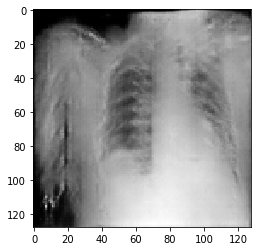

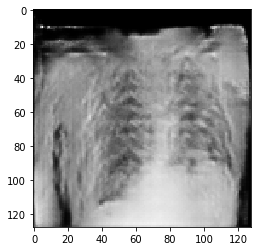

[33/51][140/236]	Loss_D: 1.6554	Loss_G: 1.2800	D(x): 0.6134	D(G(z)): 0.6681 / 0.2967
True


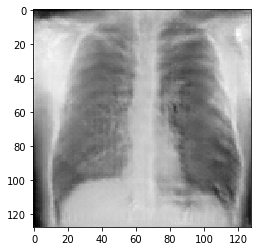

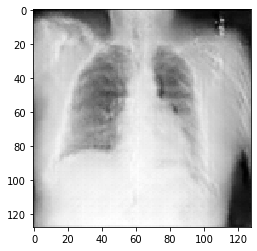

[33/51][160/236]	Loss_D: 1.1098	Loss_G: 1.6467	D(x): 0.7729	D(G(z)): 0.5512 / 0.2110
True


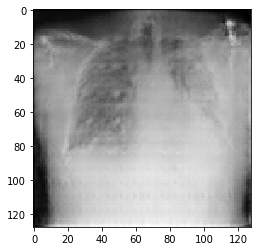

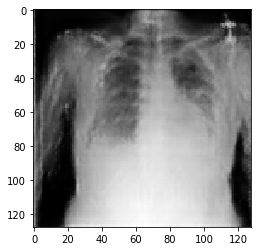

[33/51][180/236]	Loss_D: 1.1588	Loss_G: 1.3217	D(x): 0.4004	D(G(z)): 0.1776 / 0.2833
True


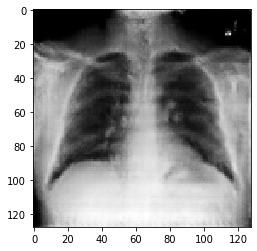

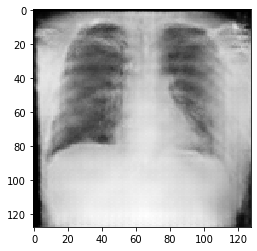

[33/51][200/236]	Loss_D: 1.1057	Loss_G: 1.3572	D(x): 0.6259	D(G(z)): 0.4205 / 0.2888
True


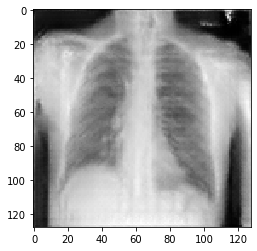

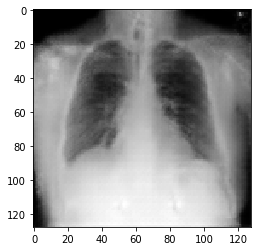

[33/51][220/236]	Loss_D: 1.0739	Loss_G: 1.3303	D(x): 0.5993	D(G(z)): 0.4006 / 0.2898



True


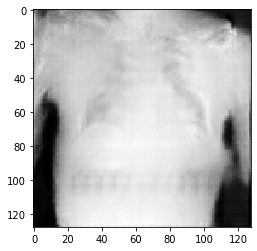

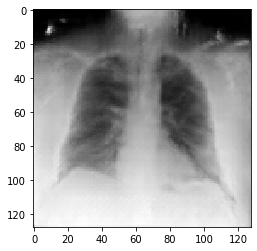

[34/51][0/236]	Loss_D: 1.9399	Loss_G: 0.7282	D(x): 0.3305	D(G(z)): 0.5136 / 0.4977
True


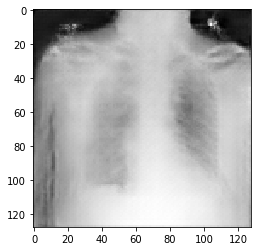

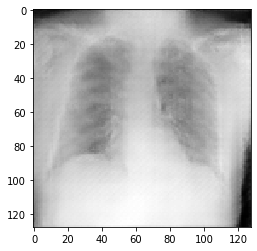

[34/51][20/236]	Loss_D: 1.1686	Loss_G: 1.2518	D(x): 0.5560	D(G(z)): 0.4167 / 0.3016
True


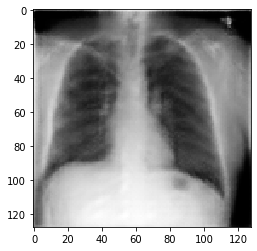

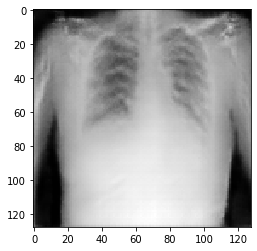

[34/51][40/236]	Loss_D: 1.0550	Loss_G: 1.3511	D(x): 0.6329	D(G(z)): 0.4250 / 0.2782
True


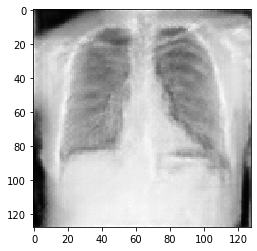

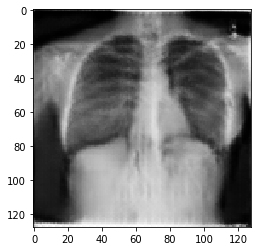

[34/51][60/236]	Loss_D: 1.0858	Loss_G: 1.3509	D(x): 0.6370	D(G(z)): 0.4494 / 0.2733
True


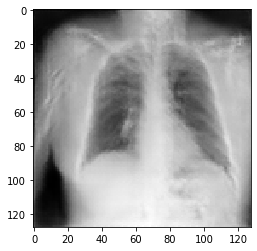

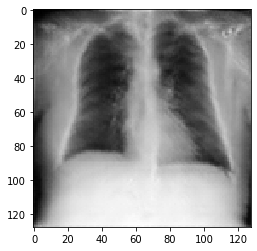

[34/51][80/236]	Loss_D: 1.3457	Loss_G: 1.1132	D(x): 0.4016	D(G(z)): 0.3206 / 0.3483
True


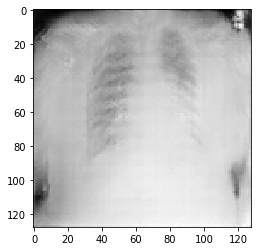

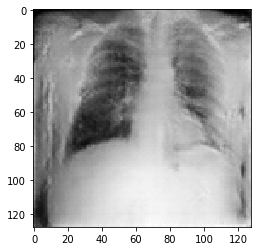

[34/51][100/236]	Loss_D: 0.8558	Loss_G: 1.2364	D(x): 0.6315	D(G(z)): 0.3088 / 0.3025
True


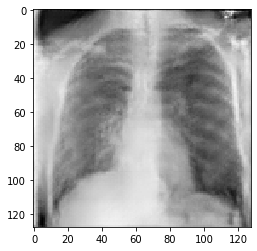

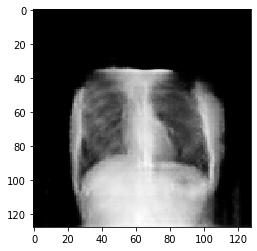

[34/51][120/236]	Loss_D: 1.4453	Loss_G: 1.2079	D(x): 0.6013	D(G(z)): 0.5848 / 0.3337
True


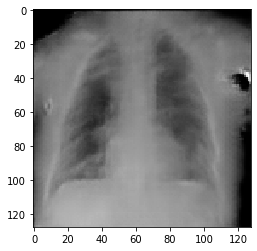

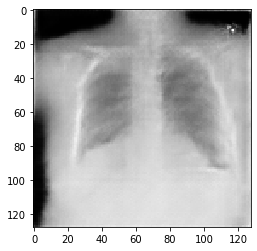

[34/51][140/236]	Loss_D: 1.1110	Loss_G: 1.1078	D(x): 0.5827	D(G(z)): 0.4153 / 0.3435
True


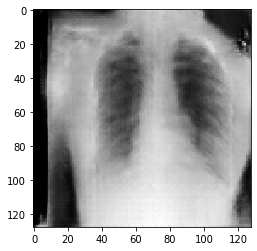

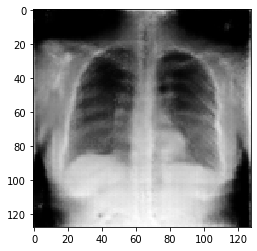

[34/51][160/236]	Loss_D: 0.8303	Loss_G: 1.5589	D(x): 0.6020	D(G(z)): 0.2517 / 0.2259
True


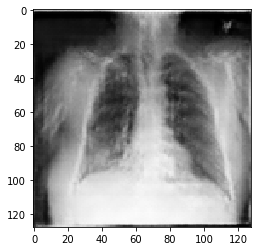

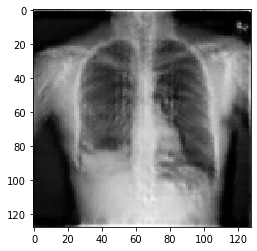

[34/51][180/236]	Loss_D: 2.1943	Loss_G: 1.1744	D(x): 0.7572	D(G(z)): 0.8377 / 0.3272
True


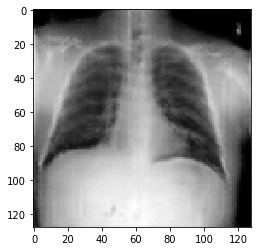

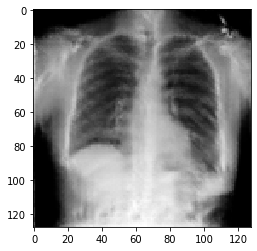

[34/51][200/236]	Loss_D: 1.2389	Loss_G: 1.3838	D(x): 0.7122	D(G(z)): 0.5802 / 0.2595
True


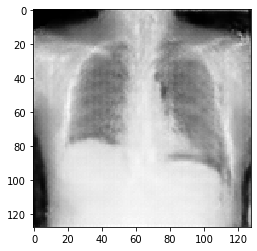

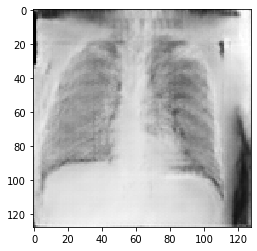

[34/51][220/236]	Loss_D: 1.0415	Loss_G: 1.0966	D(x): 0.5908	D(G(z)): 0.3745 / 0.3529



True


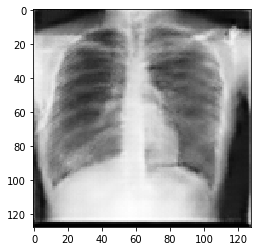

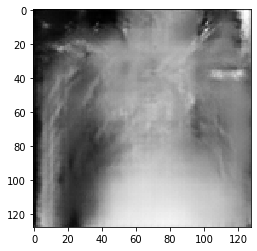

[35/51][0/236]	Loss_D: 1.0071	Loss_G: 1.4390	D(x): 0.8310	D(G(z)): 0.5478 / 0.2505
True


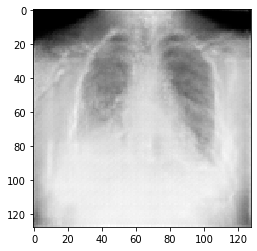

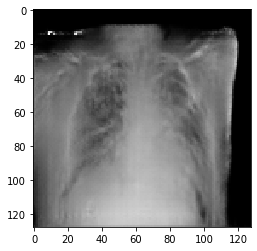

[35/51][20/236]	Loss_D: 1.0449	Loss_G: 1.0681	D(x): 0.6085	D(G(z)): 0.4045 / 0.3538
True


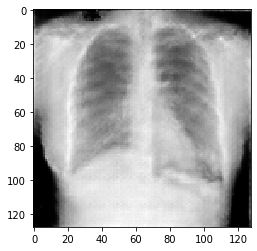

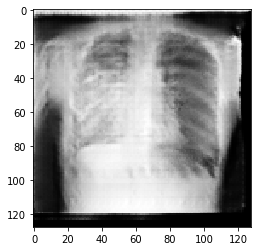

[35/51][40/236]	Loss_D: 0.9803	Loss_G: 1.1060	D(x): 0.5502	D(G(z)): 0.2947 / 0.3429
True


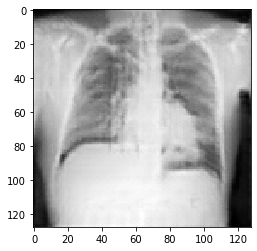

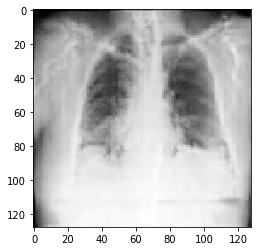

[35/51][60/236]	Loss_D: 1.4621	Loss_G: 1.1001	D(x): 0.4562	D(G(z)): 0.4645 / 0.3487
True


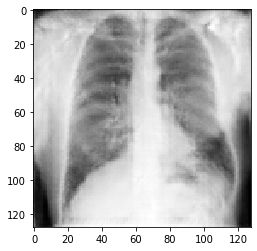

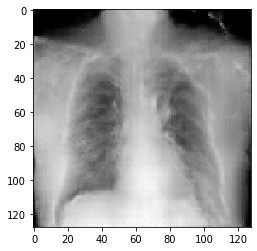

[35/51][80/236]	Loss_D: 1.1823	Loss_G: 1.6961	D(x): 0.8097	D(G(z)): 0.6058 / 0.1993
True


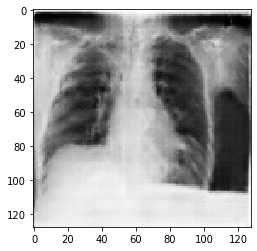

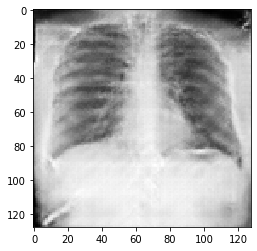

[35/51][100/236]	Loss_D: 1.4514	Loss_G: 1.0844	D(x): 0.6285	D(G(z)): 0.5888 / 0.3580
True


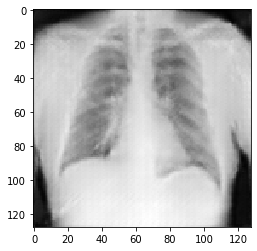

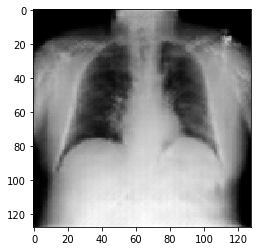

[35/51][120/236]	Loss_D: 1.0083	Loss_G: 1.5259	D(x): 0.5579	D(G(z)): 0.3236 / 0.2308
True


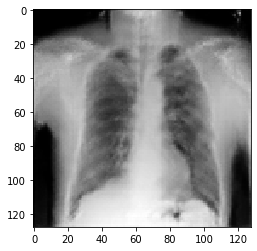

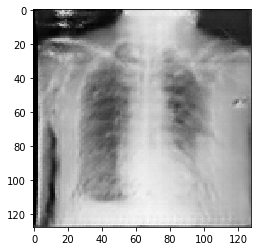

[35/51][140/236]	Loss_D: 1.2851	Loss_G: 0.9743	D(x): 0.5824	D(G(z)): 0.4959 / 0.3972
True


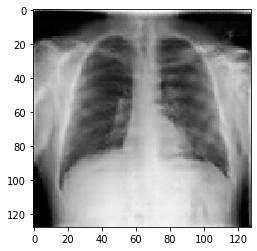

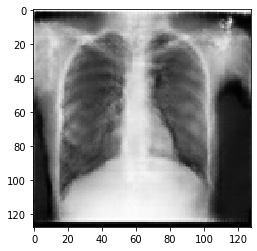

[35/51][160/236]	Loss_D: 1.1168	Loss_G: 1.0562	D(x): 0.5886	D(G(z)): 0.4174 / 0.3608
True


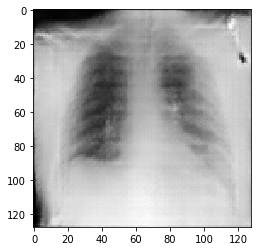

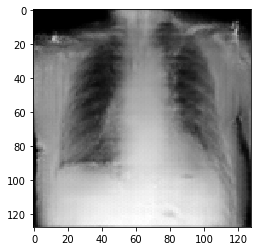

[35/51][180/236]	Loss_D: 1.4968	Loss_G: 0.9298	D(x): 0.6871	D(G(z)): 0.6526 / 0.4077
True


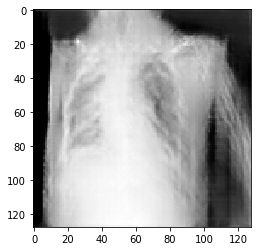

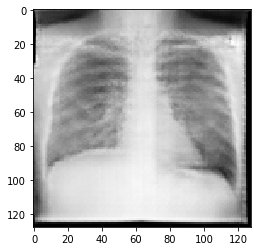

[35/51][200/236]	Loss_D: 1.2534	Loss_G: 1.2639	D(x): 0.5492	D(G(z)): 0.4569 / 0.2958
True


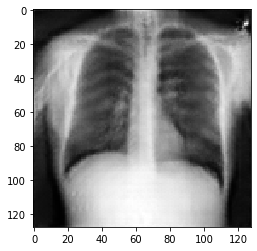

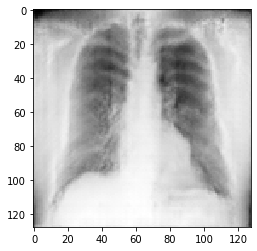

[35/51][220/236]	Loss_D: 0.7004	Loss_G: 1.9476	D(x): 0.6278	D(G(z)): 0.1826 / 0.1582



True


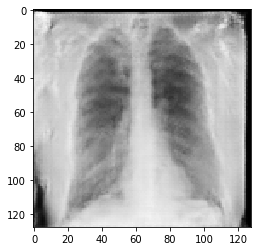

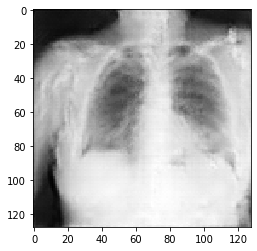

[36/51][0/236]	Loss_D: 1.4022	Loss_G: 0.9631	D(x): 0.4439	D(G(z)): 0.4138 / 0.3918
True


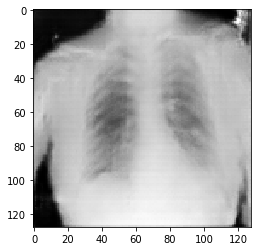

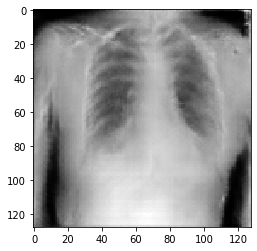

[36/51][20/236]	Loss_D: 1.1764	Loss_G: 1.1596	D(x): 0.4601	D(G(z)): 0.3043 / 0.3290
True


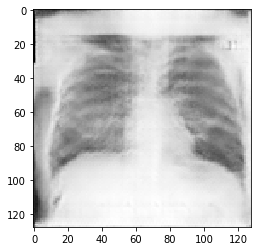

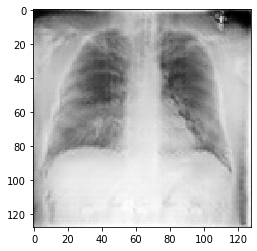

[36/51][40/236]	Loss_D: 0.9437	Loss_G: 1.5985	D(x): 0.5711	D(G(z)): 0.2907 / 0.2182
True


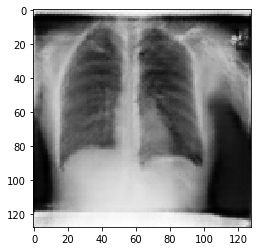

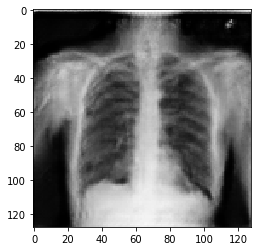

[36/51][60/236]	Loss_D: 0.9097	Loss_G: 1.6510	D(x): 0.7623	D(G(z)): 0.4553 / 0.2042
True


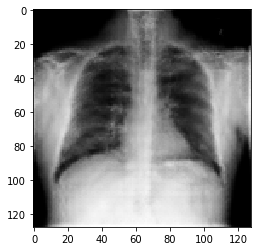

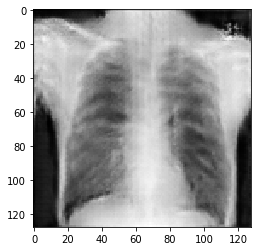

[36/51][80/236]	Loss_D: 1.1797	Loss_G: 1.4115	D(x): 0.4693	D(G(z)): 0.3205 / 0.2582
True


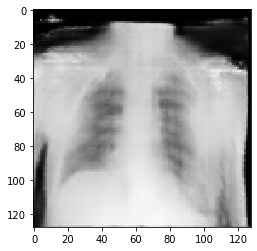

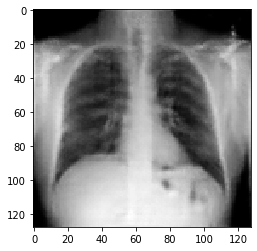

[36/51][100/236]	Loss_D: 1.0548	Loss_G: 1.1174	D(x): 0.4803	D(G(z)): 0.2491 / 0.3397
True


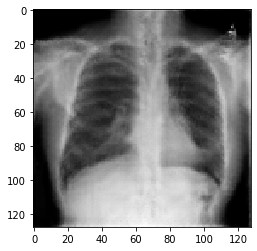

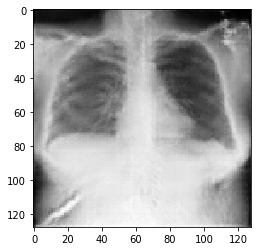

[36/51][120/236]	Loss_D: 0.3896	Loss_G: 2.0545	D(x): 0.8407	D(G(z)): 0.1895 / 0.1362
True


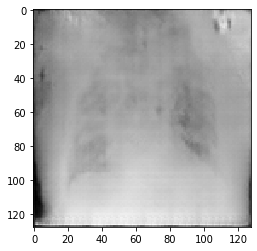

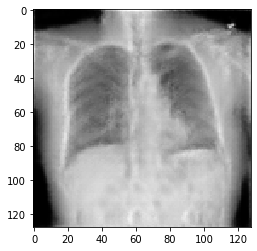

[36/51][140/236]	Loss_D: 1.4192	Loss_G: 0.7609	D(x): 0.3628	D(G(z)): 0.2997 / 0.4772
True


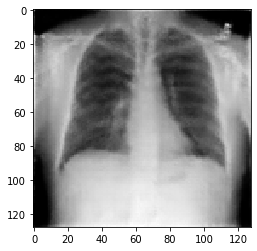

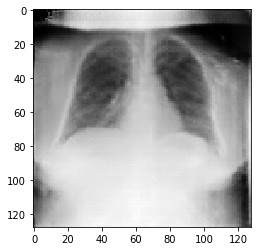

[36/51][160/236]	Loss_D: 1.1817	Loss_G: 0.9252	D(x): 0.5515	D(G(z)): 0.4215 / 0.4089
True


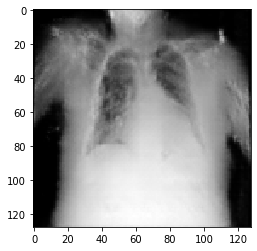

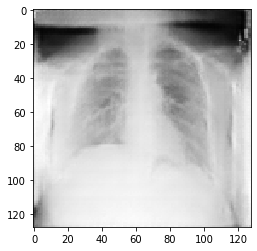

[36/51][180/236]	Loss_D: 1.5275	Loss_G: 1.5717	D(x): 0.8714	D(G(z)): 0.7388 / 0.2230
True


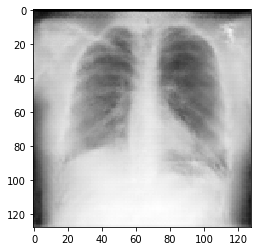

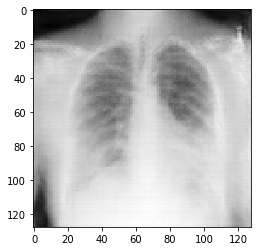

[36/51][200/236]	Loss_D: 1.2712	Loss_G: 1.1987	D(x): 0.6052	D(G(z)): 0.5151 / 0.3194
True


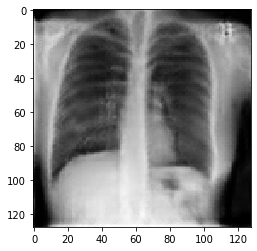

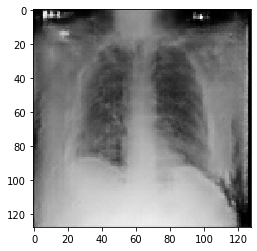

[36/51][220/236]	Loss_D: 0.7611	Loss_G: 1.7658	D(x): 0.6477	D(G(z)): 0.2562 / 0.1807



True


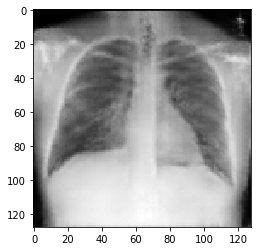

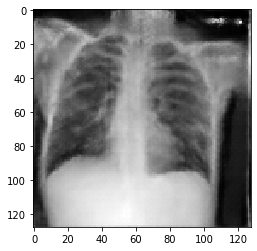

[37/51][0/236]	Loss_D: 0.9942	Loss_G: 1.5201	D(x): 0.4705	D(G(z)): 0.1823 / 0.2394
True


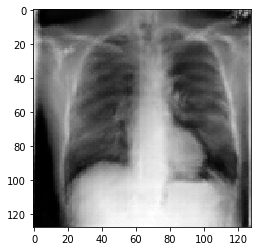

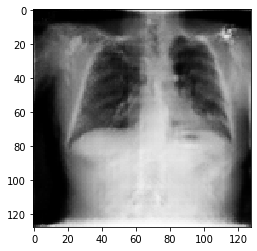

[37/51][20/236]	Loss_D: 1.3518	Loss_G: 1.0877	D(x): 0.3966	D(G(z)): 0.2940 / 0.3651
True


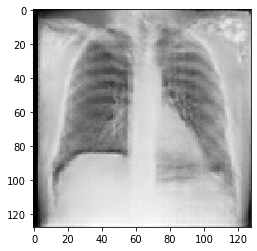

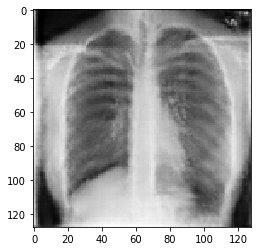

[37/51][40/236]	Loss_D: 1.0013	Loss_G: 1.6345	D(x): 0.6527	D(G(z)): 0.4131 / 0.2125
True


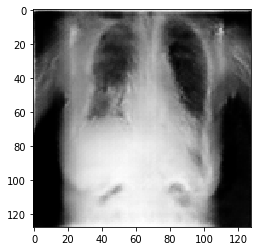

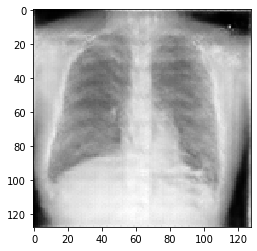

[37/51][60/236]	Loss_D: 0.8335	Loss_G: 1.5173	D(x): 0.7628	D(G(z)): 0.4154 / 0.2314
True


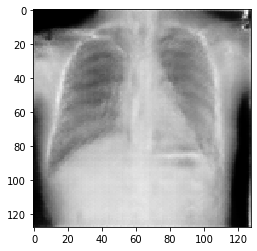

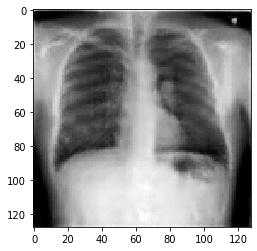

[37/51][80/236]	Loss_D: 0.7174	Loss_G: 1.8152	D(x): 0.7055	D(G(z)): 0.2940 / 0.1734
True


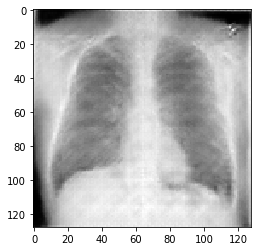

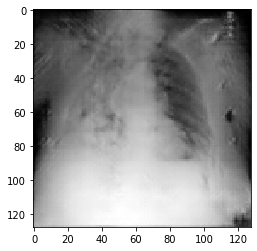

[37/51][100/236]	Loss_D: 1.0403	Loss_G: 1.3604	D(x): 0.6796	D(G(z)): 0.4583 / 0.2755
True


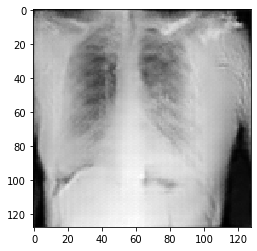

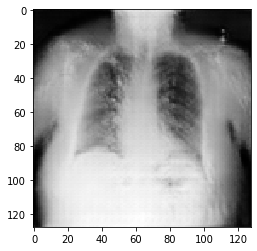

[37/51][120/236]	Loss_D: 1.4288	Loss_G: 1.2898	D(x): 0.8265	D(G(z)): 0.6914 / 0.2884
True


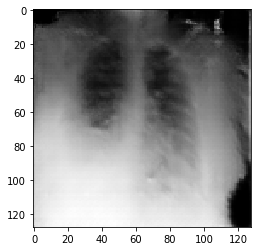

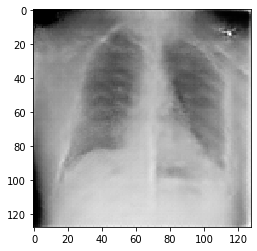

[37/51][140/236]	Loss_D: 1.0787	Loss_G: 0.8640	D(x): 0.5767	D(G(z)): 0.3857 / 0.4362
True


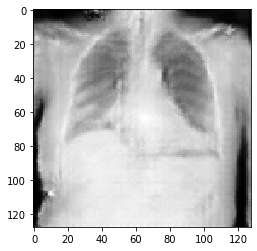

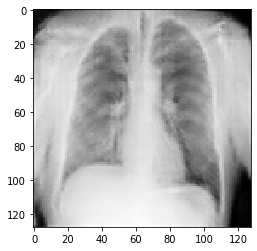

[37/51][160/236]	Loss_D: 0.8215	Loss_G: 1.7049	D(x): 0.6932	D(G(z)): 0.3504 / 0.1963
True


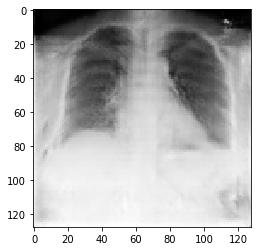

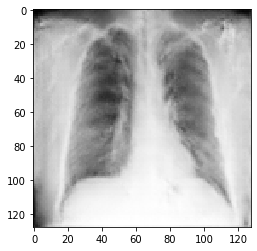

[37/51][180/236]	Loss_D: 1.0770	Loss_G: 1.2160	D(x): 0.5427	D(G(z)): 0.3460 / 0.3136
True


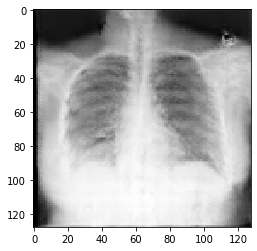

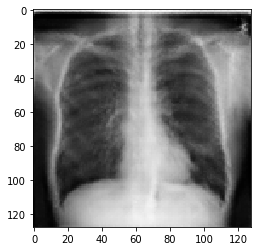

[37/51][200/236]	Loss_D: 1.1262	Loss_G: 0.8289	D(x): 0.5390	D(G(z)): 0.3754 / 0.4524
True


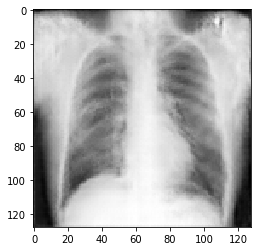

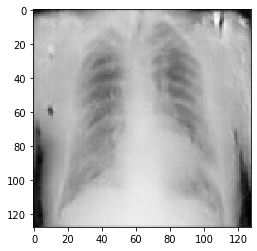

[37/51][220/236]	Loss_D: 1.2142	Loss_G: 1.2178	D(x): 0.7366	D(G(z)): 0.5769 / 0.3100



True


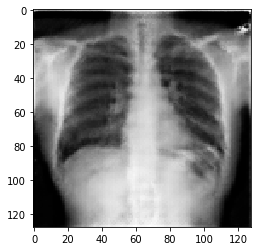

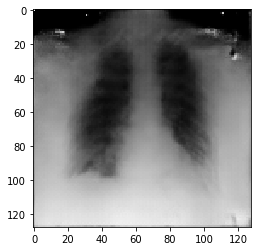

[38/51][0/236]	Loss_D: 1.1417	Loss_G: 1.3284	D(x): 0.6374	D(G(z)): 0.4707 / 0.2890
True


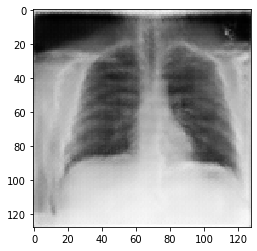

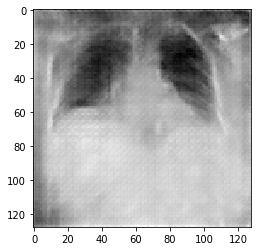

[38/51][20/236]	Loss_D: 1.0093	Loss_G: 1.5608	D(x): 0.6866	D(G(z)): 0.4493 / 0.2285
True


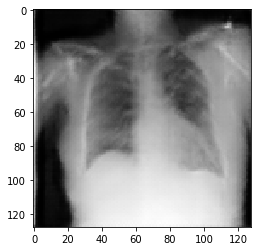

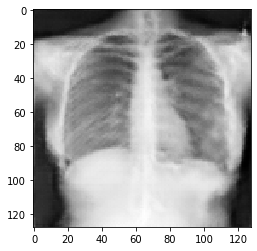

[38/51][40/236]	Loss_D: 1.3176	Loss_G: 0.7756	D(x): 0.4406	D(G(z)): 0.3525 / 0.4803
True


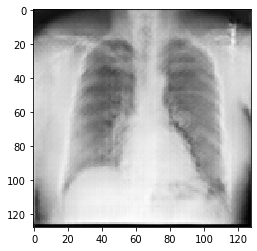

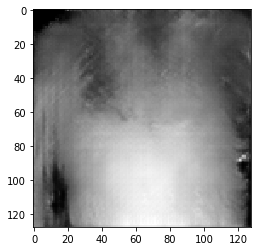

[38/51][60/236]	Loss_D: 1.1691	Loss_G: 1.4888	D(x): 0.7737	D(G(z)): 0.5736 / 0.2466
True


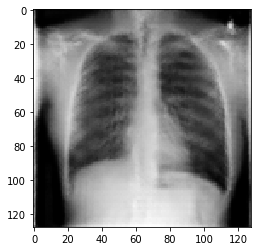

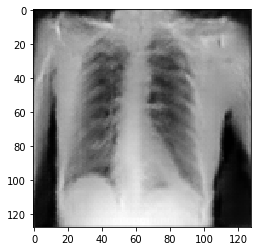

[38/51][80/236]	Loss_D: 1.1406	Loss_G: 1.4038	D(x): 0.7191	D(G(z)): 0.5109 / 0.2608
True


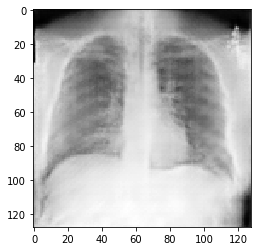

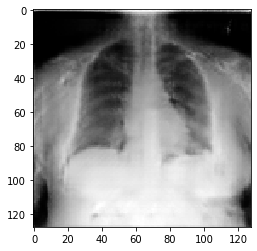

[38/51][100/236]	Loss_D: 0.7837	Loss_G: 1.9518	D(x): 0.5406	D(G(z)): 0.1276 / 0.1551
True


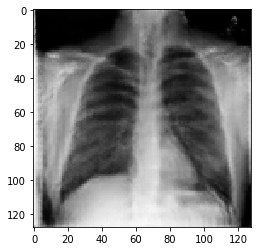

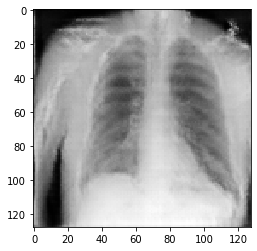

[38/51][120/236]	Loss_D: 0.7864	Loss_G: 1.7917	D(x): 0.5668	D(G(z)): 0.1742 / 0.1811
True


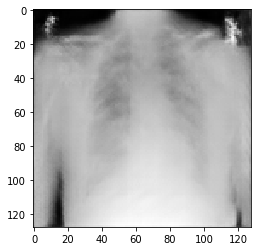

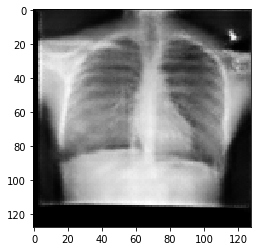

[38/51][140/236]	Loss_D: 1.4027	Loss_G: 1.1848	D(x): 0.5378	D(G(z)): 0.5119 / 0.3209
True


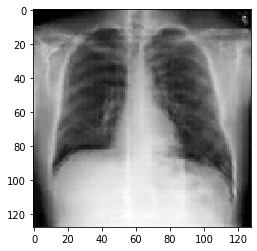

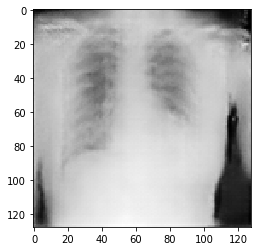

[38/51][160/236]	Loss_D: 0.9389	Loss_G: 1.5047	D(x): 0.7526	D(G(z)): 0.4544 / 0.2401
True


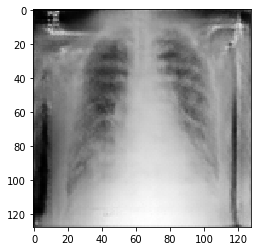

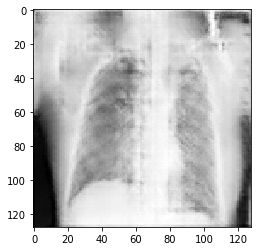

[38/51][180/236]	Loss_D: 0.4973	Loss_G: 1.9610	D(x): 0.7643	D(G(z)): 0.1917 / 0.1507
True


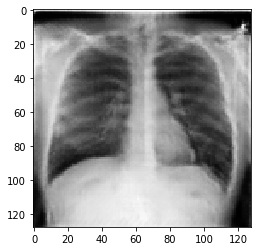

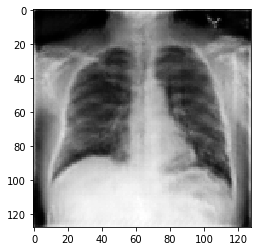

[38/51][200/236]	Loss_D: 0.7289	Loss_G: 1.9830	D(x): 0.6988	D(G(z)): 0.2848 / 0.1501
True


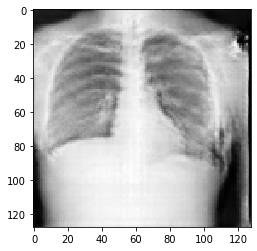

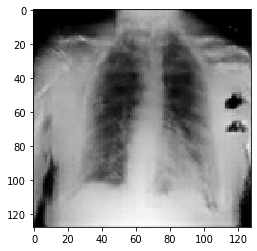

[38/51][220/236]	Loss_D: 1.3339	Loss_G: 2.0181	D(x): 0.8521	D(G(z)): 0.6748 / 0.1510



True


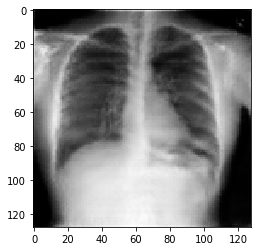

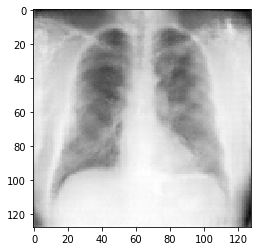

[39/51][0/236]	Loss_D: 1.2022	Loss_G: 1.4210	D(x): 0.6030	D(G(z)): 0.4783 / 0.2535
True


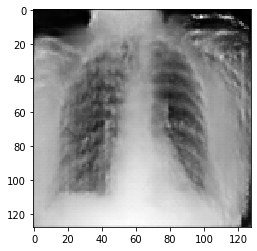

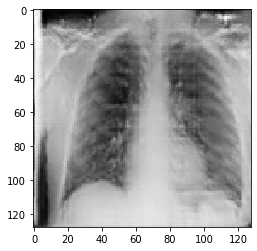

[39/51][20/236]	Loss_D: 0.8430	Loss_G: 2.1238	D(x): 0.6906	D(G(z)): 0.3579 / 0.1304
True


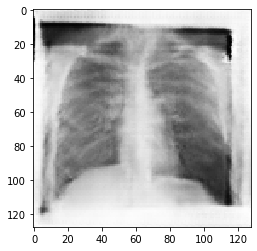

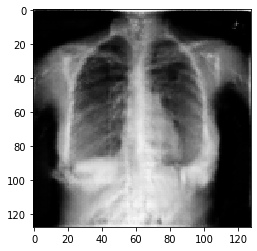

[39/51][40/236]	Loss_D: 0.7469	Loss_G: 1.6359	D(x): 0.7507	D(G(z)): 0.3513 / 0.2102
True


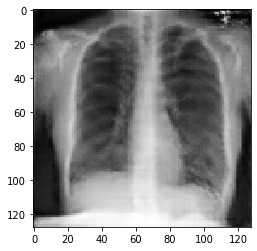

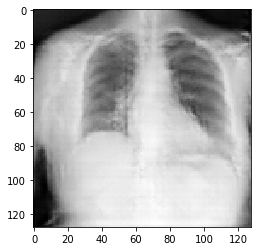

[39/51][60/236]	Loss_D: 1.1572	Loss_G: 1.5245	D(x): 0.6365	D(G(z)): 0.4723 / 0.2365
True


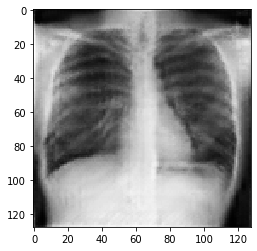

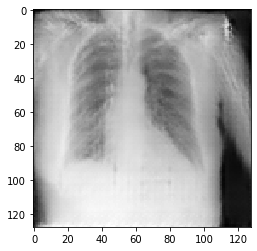

[39/51][80/236]	Loss_D: 1.1700	Loss_G: 1.1417	D(x): 0.4630	D(G(z)): 0.2954 / 0.3350
True


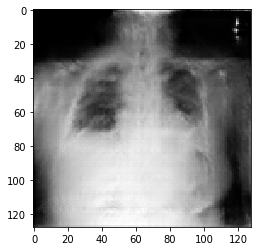

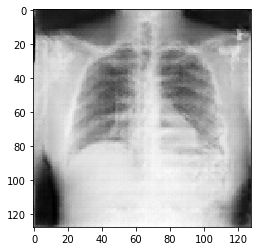

[39/51][100/236]	Loss_D: 1.0401	Loss_G: 1.4942	D(x): 0.4572	D(G(z)): 0.1892 / 0.2413
True


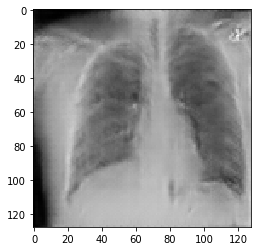

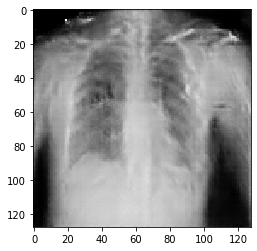

[39/51][120/236]	Loss_D: 0.5044	Loss_G: 2.1431	D(x): 0.7913	D(G(z)): 0.2268 / 0.1277
True


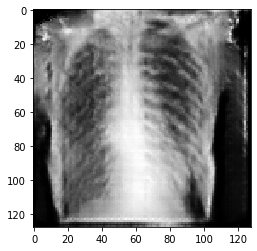

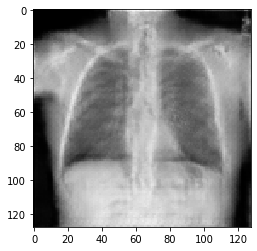

[39/51][140/236]	Loss_D: 0.6797	Loss_G: 2.1409	D(x): 0.7033	D(G(z)): 0.2627 / 0.1302
True


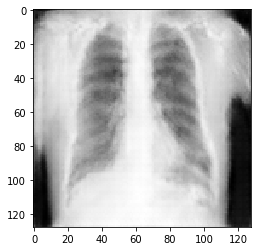

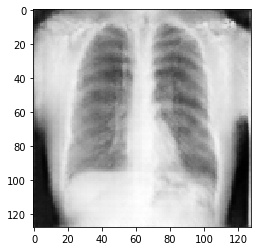

[39/51][160/236]	Loss_D: 0.7116	Loss_G: 2.5944	D(x): 0.7806	D(G(z)): 0.3549 / 0.0866
True


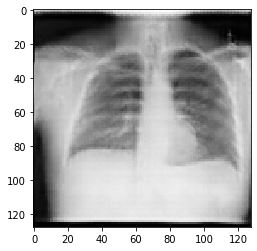

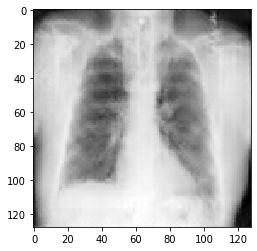

[39/51][180/236]	Loss_D: 1.0531	Loss_G: 1.8071	D(x): 0.7452	D(G(z)): 0.5121 / 0.1817
True


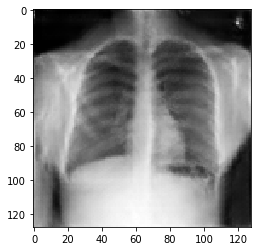

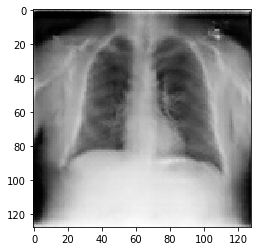

[39/51][200/236]	Loss_D: 1.0788	Loss_G: 1.8275	D(x): 0.7672	D(G(z)): 0.5372 / 0.1802
True


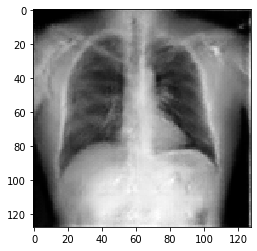

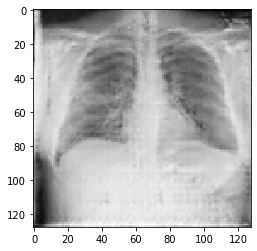

[39/51][220/236]	Loss_D: 0.7685	Loss_G: 1.8638	D(x): 0.6915	D(G(z)): 0.3148 / 0.1677



True


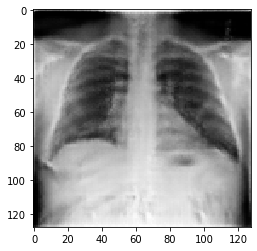

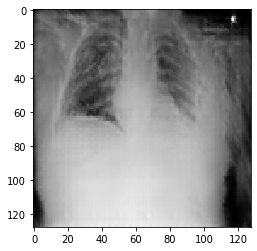

[40/51][0/236]	Loss_D: 0.9040	Loss_G: 1.6535	D(x): 0.5191	D(G(z)): 0.1838 / 0.2175
True


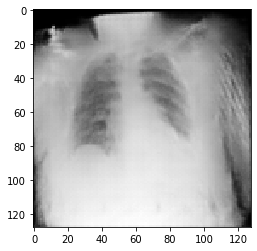

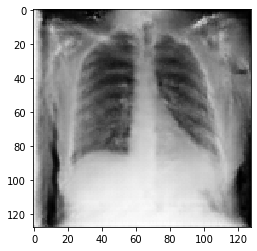

[40/51][20/236]	Loss_D: 1.4392	Loss_G: 1.1667	D(x): 0.2849	D(G(z)): 0.0885 / 0.3315
True


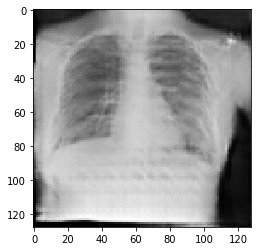

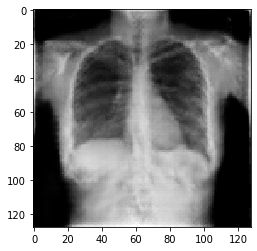

[40/51][40/236]	Loss_D: 0.6603	Loss_G: 2.3676	D(x): 0.6484	D(G(z)): 0.1910 / 0.1041
True


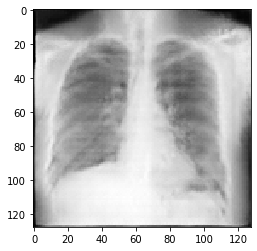

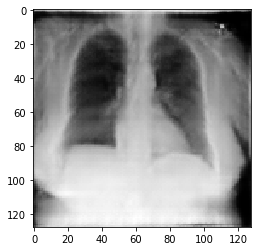

[40/51][60/236]	Loss_D: 0.5061	Loss_G: 1.9770	D(x): 0.6650	D(G(z)): 0.0734 / 0.1549
True


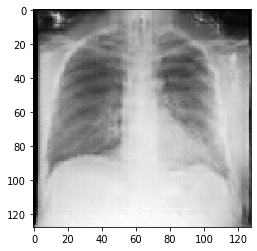

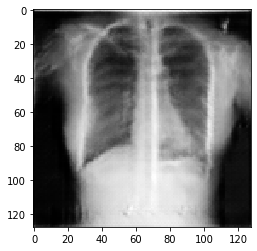

[40/51][80/236]	Loss_D: 0.3410	Loss_G: 2.5063	D(x): 0.9572	D(G(z)): 0.2484 / 0.1041
True


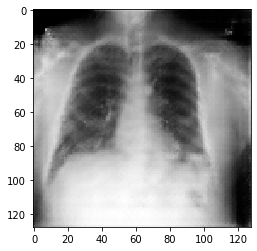

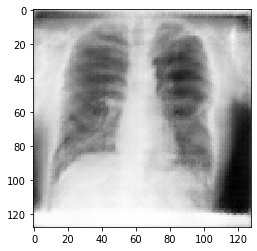

[40/51][100/236]	Loss_D: 0.2933	Loss_G: 3.2401	D(x): 0.9243	D(G(z)): 0.1787 / 0.0488
True


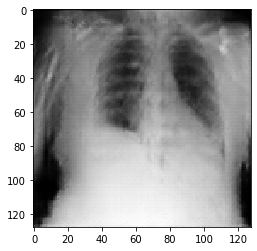

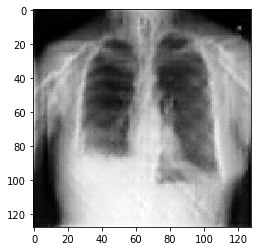

[40/51][120/236]	Loss_D: 1.2617	Loss_G: 1.1419	D(x): 0.3421	D(G(z)): 0.0997 / 0.3562
True


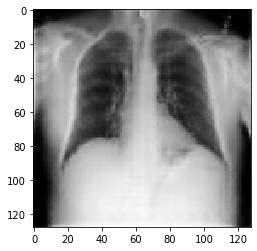

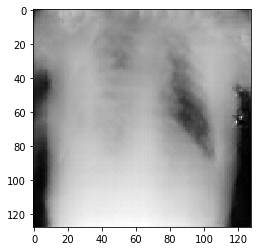

[40/51][140/236]	Loss_D: 0.7567	Loss_G: 1.6474	D(x): 0.6421	D(G(z)): 0.2492 / 0.2088
True


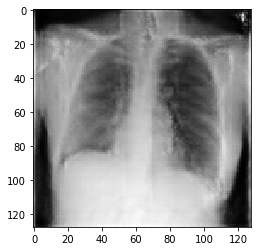

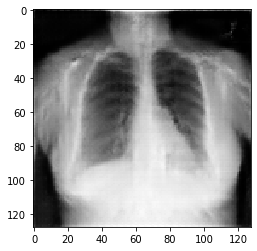

[40/51][160/236]	Loss_D: 1.0074	Loss_G: 1.8195	D(x): 0.5272	D(G(z)): 0.2620 / 0.1908
True


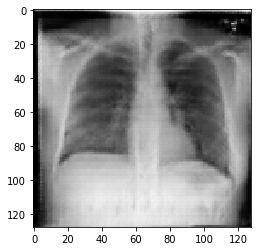

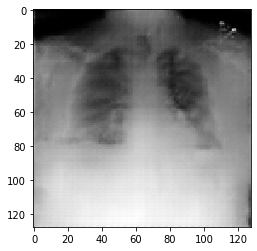

[40/51][180/236]	Loss_D: 1.2032	Loss_G: 2.3908	D(x): 0.8629	D(G(z)): 0.6226 / 0.1039
True


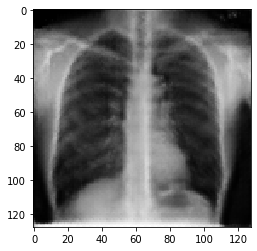

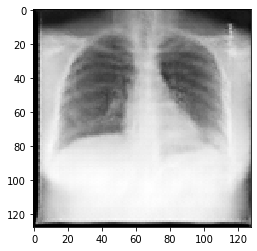

[40/51][200/236]	Loss_D: 0.9606	Loss_G: 1.4439	D(x): 0.5901	D(G(z)): 0.3210 / 0.2577
True


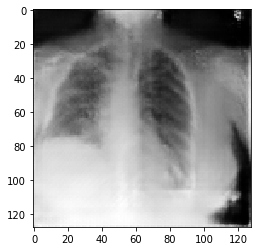

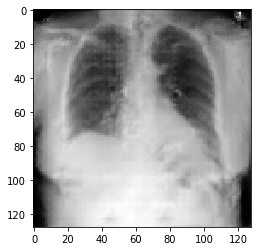

[40/51][220/236]	Loss_D: 0.7962	Loss_G: 2.3516	D(x): 0.5387	D(G(z)): 0.1128 / 0.1099



True


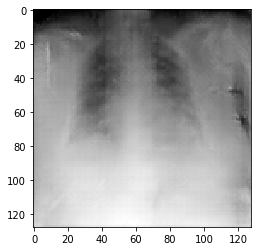

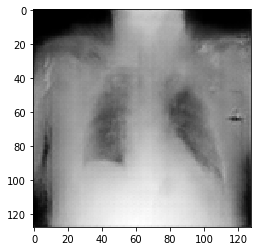

[41/51][0/236]	Loss_D: 0.9555	Loss_G: 1.9000	D(x): 0.7019	D(G(z)): 0.4180 / 0.1674
True


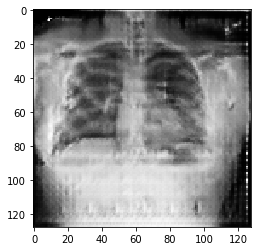

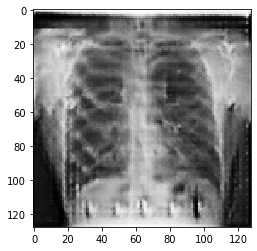

[41/51][20/236]	Loss_D: 0.3164	Loss_G: 4.5478	D(x): 0.9642	D(G(z)): 0.2290 / 0.0147
True


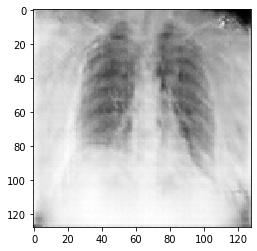

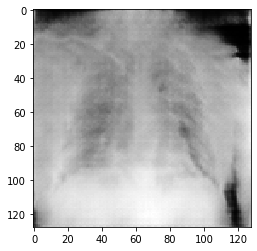

[41/51][40/236]	Loss_D: 0.3979	Loss_G: 2.9211	D(x): 0.8234	D(G(z)): 0.1741 / 0.0607
True


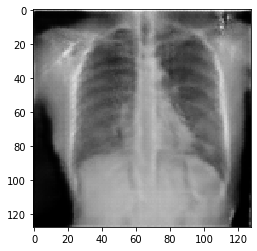

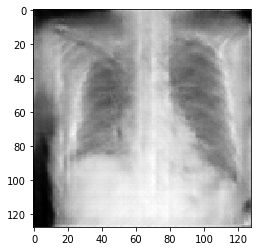

[41/51][60/236]	Loss_D: 0.3111	Loss_G: 3.4386	D(x): 0.7907	D(G(z)): 0.0573 / 0.0377
True


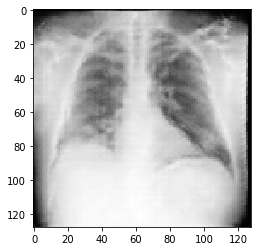

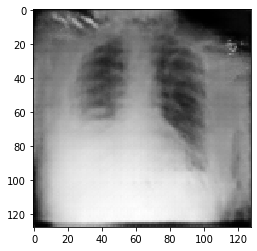

[41/51][80/236]	Loss_D: 0.3779	Loss_G: 2.7747	D(x): 0.8925	D(G(z)): 0.2212 / 0.0721
True


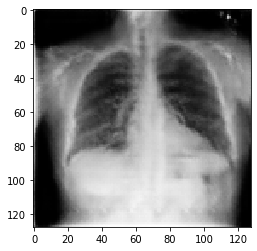

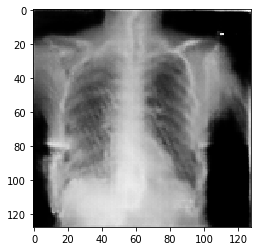

[41/51][100/236]	Loss_D: 0.4813	Loss_G: 1.8946	D(x): 0.7679	D(G(z)): 0.1839 / 0.1707
True


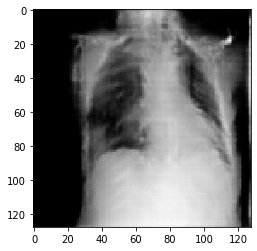

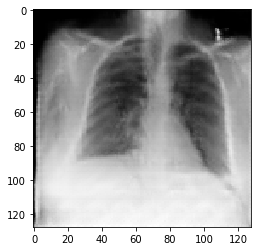

[41/51][120/236]	Loss_D: 0.5921	Loss_G: 2.6340	D(x): 0.6627	D(G(z)): 0.1473 / 0.0839
True


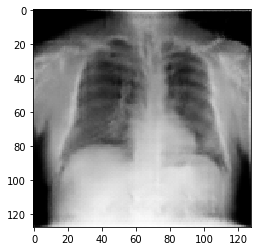

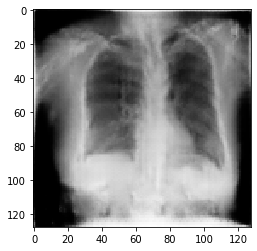

[41/51][140/236]	Loss_D: 1.1699	Loss_G: 1.0505	D(x): 0.3552	D(G(z)): 0.0389 / 0.3768
True


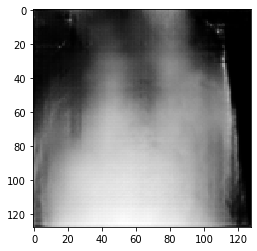

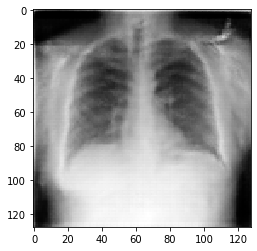

[41/51][160/236]	Loss_D: 0.3453	Loss_G: 3.2112	D(x): 0.7728	D(G(z)): 0.0682 / 0.0541
True


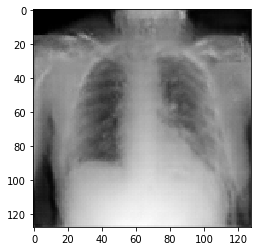

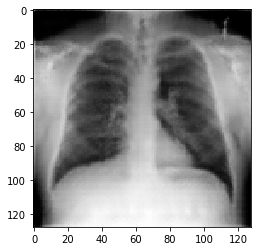

[41/51][180/236]	Loss_D: 0.7061	Loss_G: 1.7220	D(x): 0.5855	D(G(z)): 0.1071 / 0.2037
True


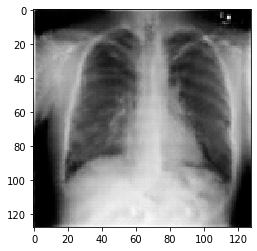

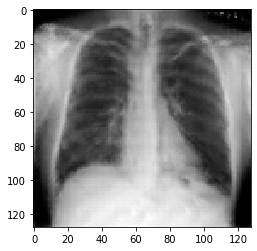

[41/51][200/236]	Loss_D: 0.2307	Loss_G: 3.0629	D(x): 0.8515	D(G(z)): 0.0610 / 0.0585
True


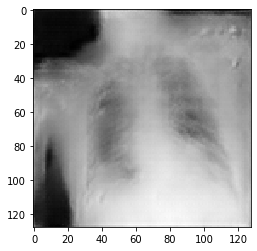

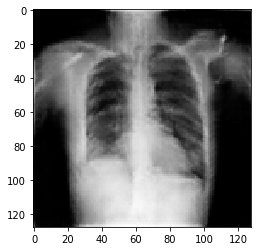

[41/51][220/236]	Loss_D: 0.9943	Loss_G: 1.3765	D(x): 0.5407	D(G(z)): 0.2521 / 0.2883



True


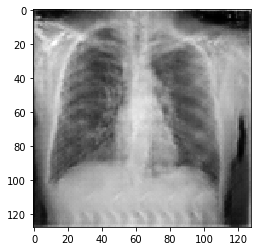

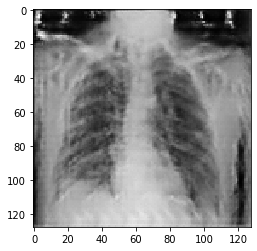

[42/51][0/236]	Loss_D: 0.3798	Loss_G: 2.8836	D(x): 0.8062	D(G(z)): 0.1306 / 0.0701
True


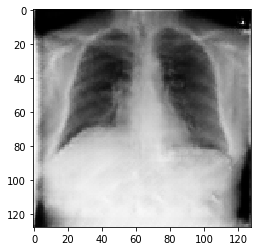

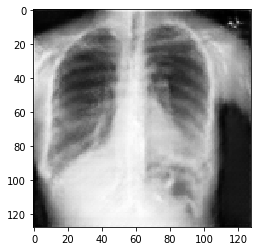

[42/51][20/236]	Loss_D: 0.5276	Loss_G: 2.1596	D(x): 0.7549	D(G(z)): 0.2070 / 0.1299
True


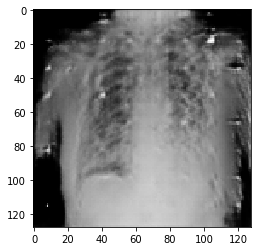

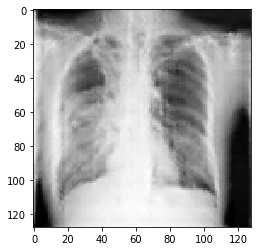

[42/51][40/236]	Loss_D: 0.8540	Loss_G: 1.7655	D(x): 0.7085	D(G(z)): 0.3510 / 0.1912
True


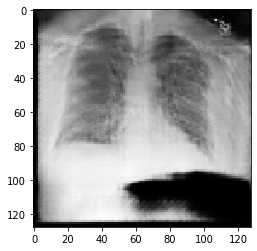

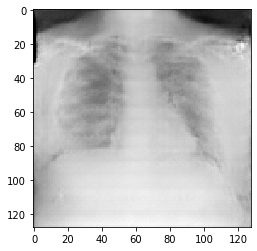

[42/51][60/236]	Loss_D: 1.0834	Loss_G: 1.4970	D(x): 0.4443	D(G(z)): 0.1431 / 0.2583
True


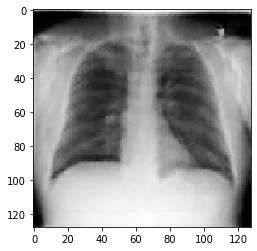

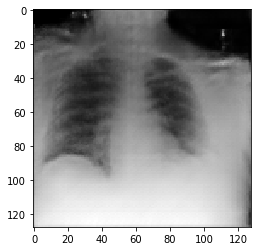

[42/51][80/236]	Loss_D: 0.8655	Loss_G: 2.3750	D(x): 0.6721	D(G(z)): 0.3483 / 0.1067
True


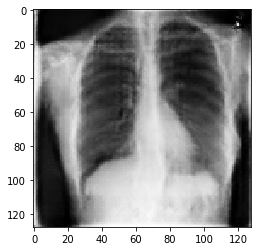

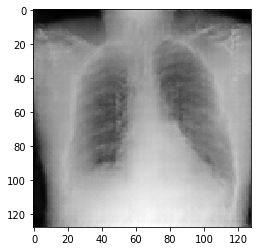

[42/51][100/236]	Loss_D: 0.5057	Loss_G: 2.6870	D(x): 0.6522	D(G(z)): 0.0572 / 0.0807
True


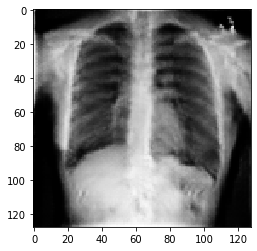

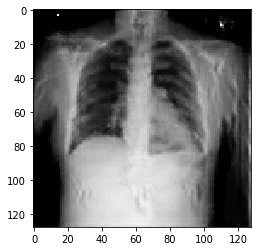

[42/51][120/236]	Loss_D: 0.4719	Loss_G: 1.8320	D(x): 0.8099	D(G(z)): 0.2180 / 0.1824
True


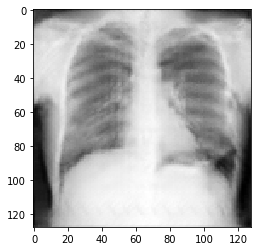

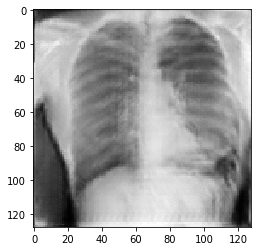

[42/51][140/236]	Loss_D: 0.4804	Loss_G: 2.5184	D(x): 0.7358	D(G(z)): 0.1342 / 0.0966
True


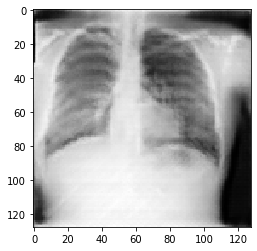

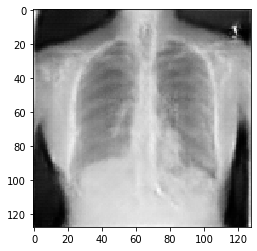

[42/51][160/236]	Loss_D: 1.1894	Loss_G: 3.0717	D(x): 0.9481	D(G(z)): 0.6501 / 0.0564
True


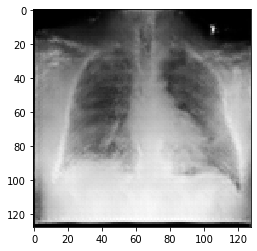

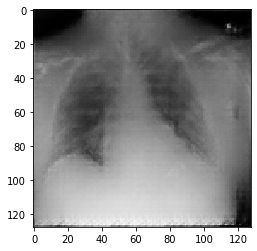

[42/51][180/236]	Loss_D: 0.5797	Loss_G: 2.2415	D(x): 0.6521	D(G(z)): 0.1165 / 0.1278
True


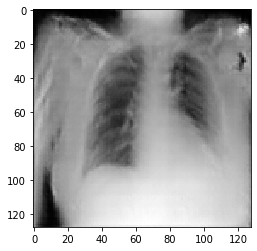

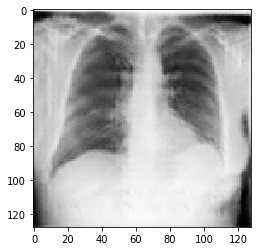

[42/51][200/236]	Loss_D: 0.8341	Loss_G: 2.3646	D(x): 0.7418	D(G(z)): 0.3827 / 0.1124
True


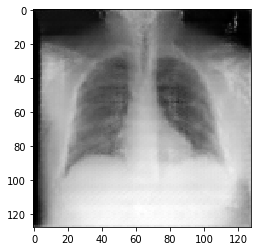

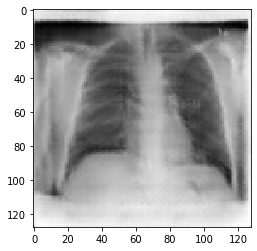

[42/51][220/236]	Loss_D: 0.6892	Loss_G: 2.1100	D(x): 0.5370	D(G(z)): 0.0236 / 0.1425



True


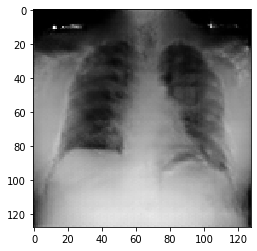

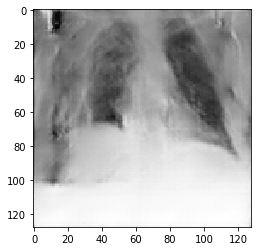

[43/51][0/236]	Loss_D: 0.8221	Loss_G: 2.3510	D(x): 0.6830	D(G(z)): 0.3312 / 0.1105
True


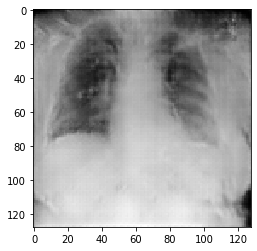

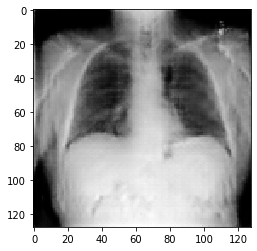

[43/51][20/236]	Loss_D: 1.1187	Loss_G: 0.6394	D(x): 0.4251	D(G(z)): 0.1788 / 0.5667
True


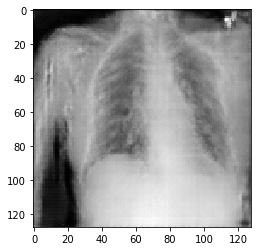

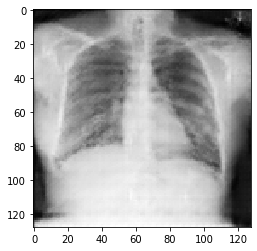

[43/51][40/236]	Loss_D: 0.7285	Loss_G: 3.2253	D(x): 0.8431	D(G(z)): 0.3955 / 0.0497
True


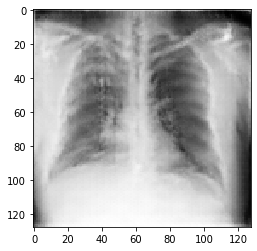

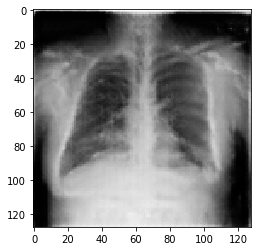

[43/51][60/236]	Loss_D: 0.1101	Loss_G: 4.2356	D(x): 0.9300	D(G(z)): 0.0347 / 0.0213
True


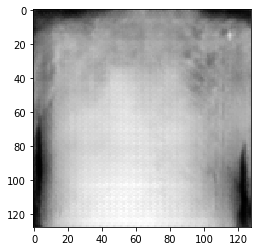

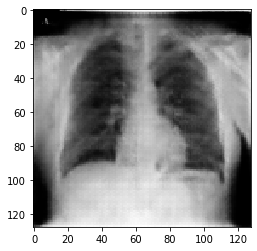

[43/51][80/236]	Loss_D: 0.2324	Loss_G: 3.6067	D(x): 0.9477	D(G(z)): 0.1520 / 0.0336
True


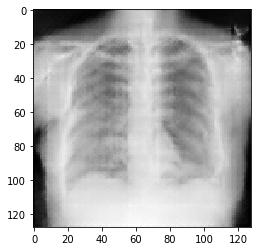

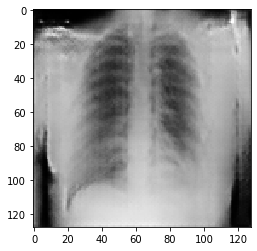

[43/51][100/236]	Loss_D: 0.7188	Loss_G: 2.3578	D(x): 0.7354	D(G(z)): 0.3090 / 0.1082
True


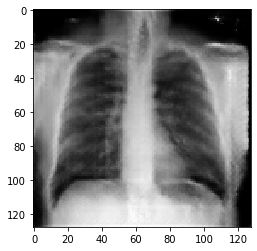

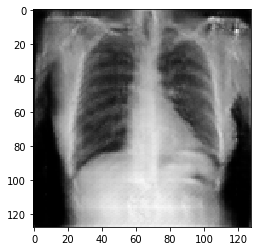

[43/51][120/236]	Loss_D: 0.5663	Loss_G: 2.5343	D(x): 0.9799	D(G(z)): 0.4039 / 0.0930
True


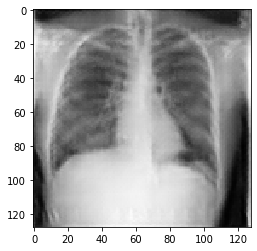

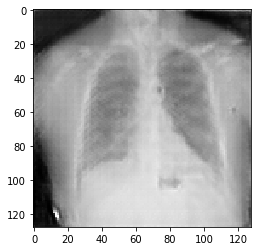

[43/51][140/236]	Loss_D: 1.5040	Loss_G: 1.3081	D(x): 0.3679	D(G(z)): 0.3141 / 0.3005
True


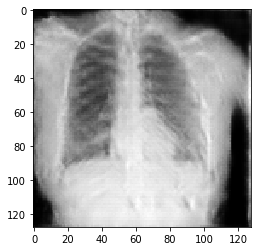

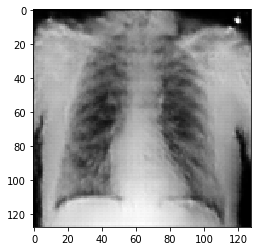

[43/51][160/236]	Loss_D: 0.3909	Loss_G: 3.3265	D(x): 0.7303	D(G(z)): 0.0537 / 0.0433
True


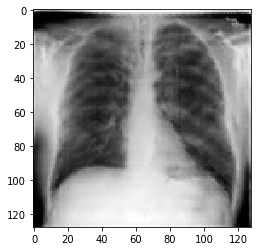

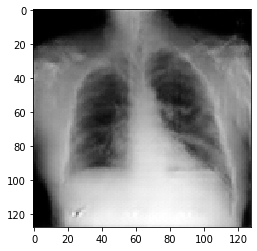

[43/51][180/236]	Loss_D: 0.5765	Loss_G: 1.9977	D(x): 0.6890	D(G(z)): 0.1586 / 0.1647
True


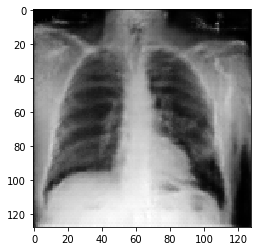

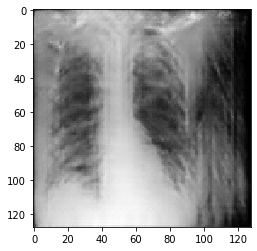

[43/51][200/236]	Loss_D: 0.6687	Loss_G: 2.8552	D(x): 0.9245	D(G(z)): 0.4263 / 0.0741
True


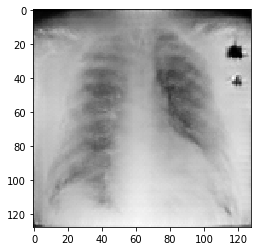

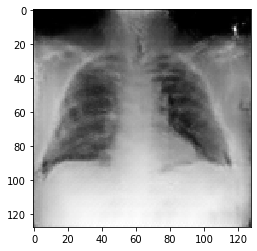

[43/51][220/236]	Loss_D: 0.2814	Loss_G: 2.4604	D(x): 0.8843	D(G(z)): 0.1409 / 0.0962



True


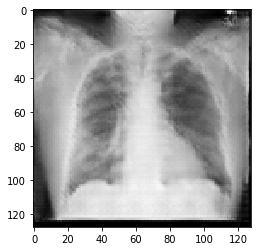

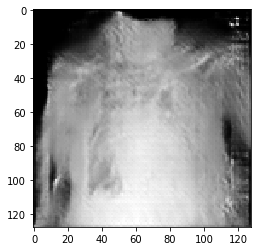

[44/51][0/236]	Loss_D: 1.2044	Loss_G: 0.6993	D(x): 0.4059	D(G(z)): 0.1925 / 0.5160
True


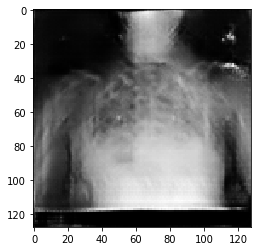

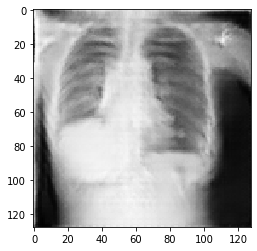

[44/51][20/236]	Loss_D: 0.3131	Loss_G: 3.9611	D(x): 0.7697	D(G(z)): 0.0365 / 0.0230
True


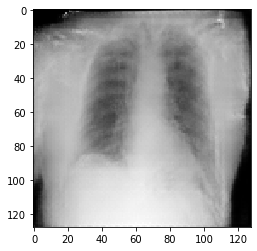

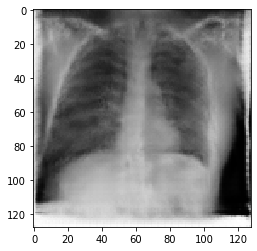

[44/51][40/236]	Loss_D: 1.0588	Loss_G: 1.3976	D(x): 0.4629	D(G(z)): 0.1596 / 0.2882
True


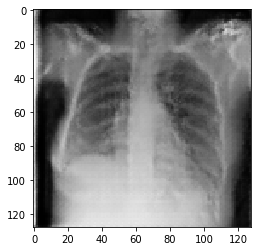

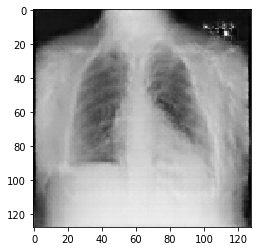

[44/51][60/236]	Loss_D: 0.5591	Loss_G: 1.4506	D(x): 0.6663	D(G(z)): 0.1063 / 0.2622
True


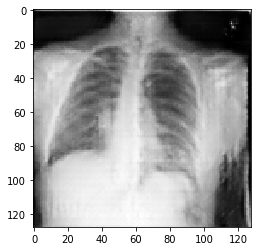

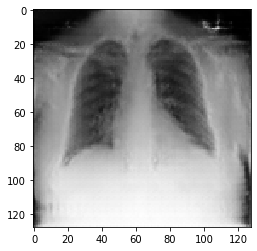

[44/51][80/236]	Loss_D: 1.2762	Loss_G: 1.7009	D(x): 0.3318	D(G(z)): 0.0435 / 0.2020
True


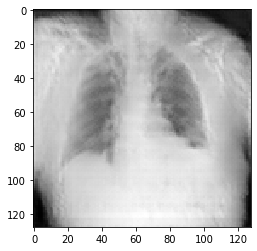

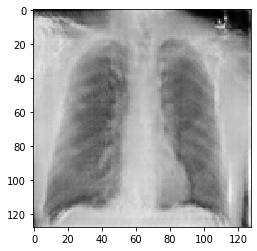

[44/51][100/236]	Loss_D: 0.6252	Loss_G: 2.4356	D(x): 0.5719	D(G(z)): 0.0227 / 0.1092
True


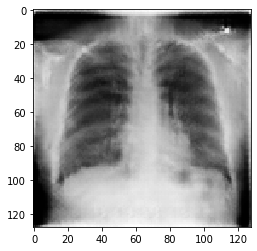

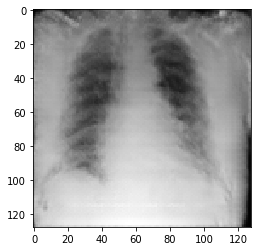

[44/51][120/236]	Loss_D: 0.5511	Loss_G: 2.6917	D(x): 0.8364	D(G(z)): 0.2998 / 0.0765
True


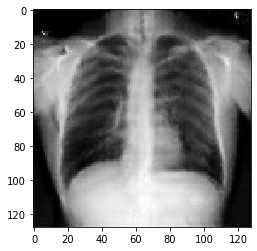

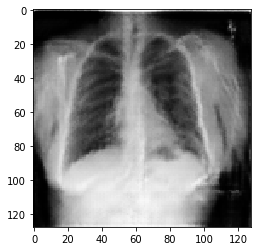

[44/51][140/236]	Loss_D: 0.6267	Loss_G: 3.0587	D(x): 0.9715	D(G(z)): 0.4321 / 0.0520
True


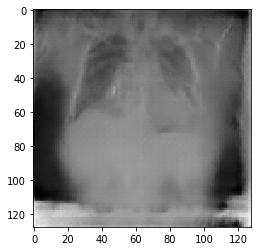

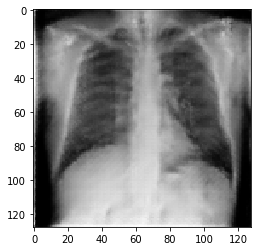

[44/51][160/236]	Loss_D: 0.1749	Loss_G: 2.9587	D(x): 0.9211	D(G(z)): 0.0856 / 0.0653
True


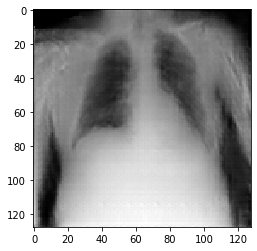

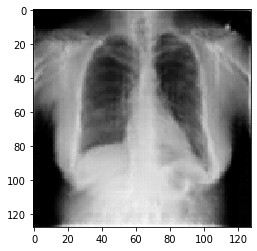

[44/51][180/236]	Loss_D: 0.3947	Loss_G: 3.6422	D(x): 0.7254	D(G(z)): 0.0579 / 0.0333
True


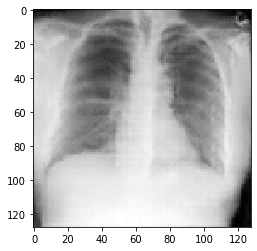

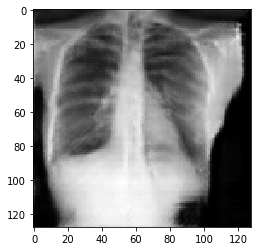

[44/51][200/236]	Loss_D: 0.9797	Loss_G: 1.4640	D(x): 0.4411	D(G(z)): 0.0851 / 0.2556
True


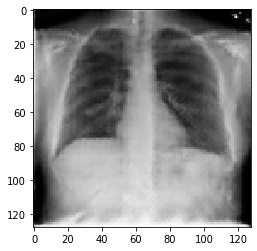

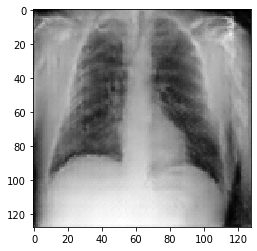

[44/51][220/236]	Loss_D: 0.4051	Loss_G: 2.6423	D(x): 0.7216	D(G(z)): 0.0457 / 0.0851



True


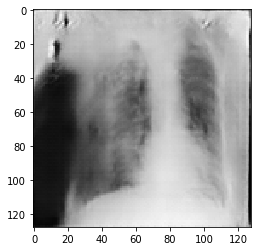

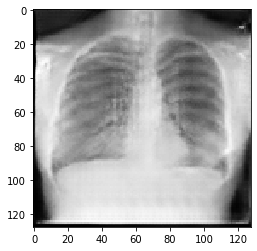

[45/51][0/236]	Loss_D: 0.5145	Loss_G: 1.9949	D(x): 0.7256	D(G(z)): 0.1587 / 0.1557
True


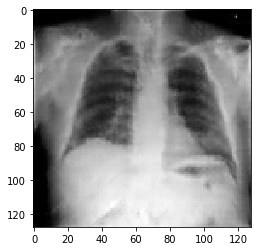

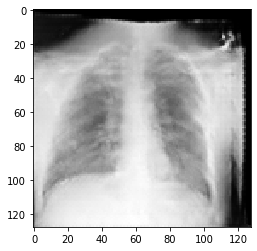

[45/51][20/236]	Loss_D: 0.3296	Loss_G: 2.0104	D(x): 0.8416	D(G(z)): 0.1387 / 0.1580
True


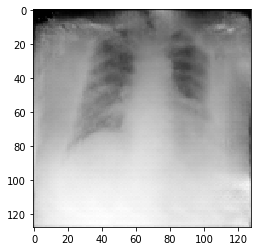

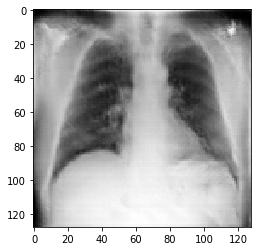

[45/51][40/236]	Loss_D: 0.7010	Loss_G: 2.0165	D(x): 0.6859	D(G(z)): 0.2547 / 0.1513
True


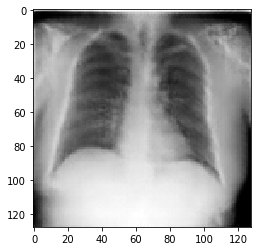

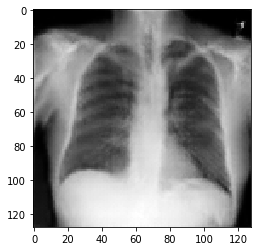

[45/51][60/236]	Loss_D: 0.4904	Loss_G: 2.0341	D(x): 0.7432	D(G(z)): 0.1552 / 0.1436
True


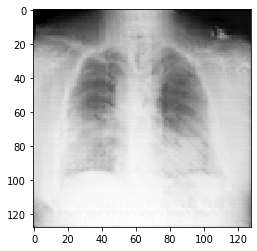

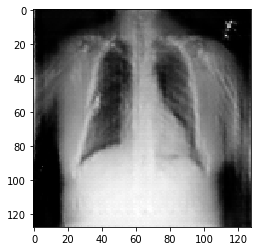

[45/51][80/236]	Loss_D: 0.1996	Loss_G: 2.1034	D(x): 0.9381	D(G(z)): 0.1208 / 0.1416
True


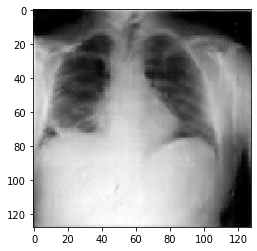

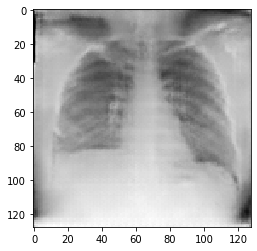

[45/51][100/236]	Loss_D: 0.5263	Loss_G: 2.0718	D(x): 0.7541	D(G(z)): 0.2036 / 0.1433
True


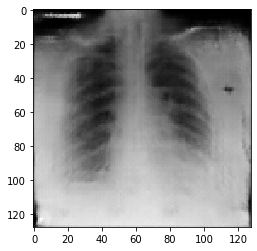

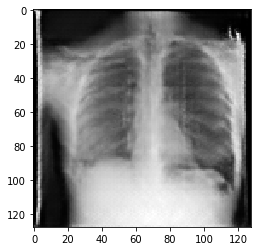

[45/51][120/236]	Loss_D: 0.7528	Loss_G: 1.3796	D(x): 0.8657	D(G(z)): 0.4326 / 0.2817
True


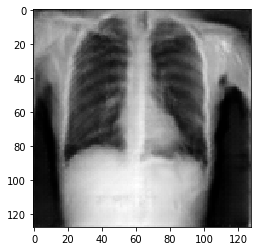

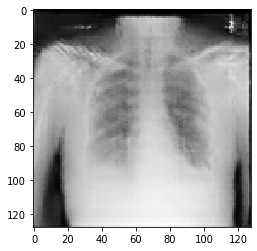

[45/51][140/236]	Loss_D: 0.7876	Loss_G: 2.6438	D(x): 0.9571	D(G(z)): 0.4998 / 0.0897
True


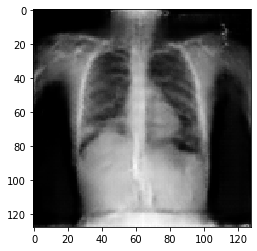

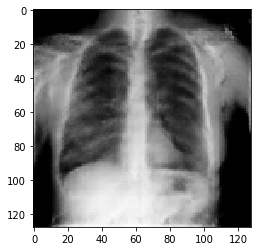

[45/51][160/236]	Loss_D: 0.7513	Loss_G: 2.4874	D(x): 0.5427	D(G(z)): 0.0882 / 0.0981
True


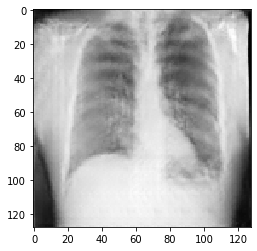

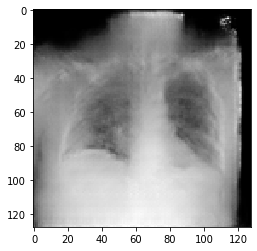

[45/51][180/236]	Loss_D: 1.3185	Loss_G: 2.2036	D(x): 0.3013	D(G(z)): 0.0268 / 0.1280
True


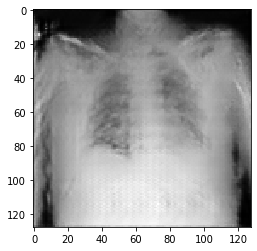

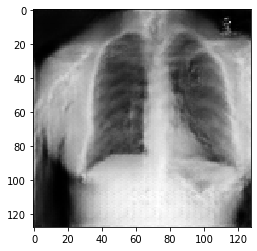

[45/51][200/236]	Loss_D: 0.9555	Loss_G: 1.5433	D(x): 0.4732	D(G(z)): 0.1370 / 0.2398
True


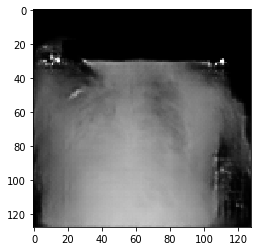

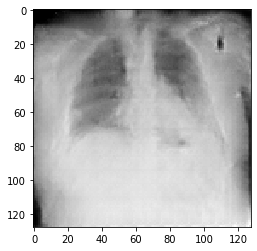

[45/51][220/236]	Loss_D: 0.3170	Loss_G: 2.2231	D(x): 0.8412	D(G(z)): 0.1272 / 0.1238



True


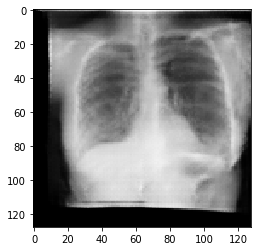

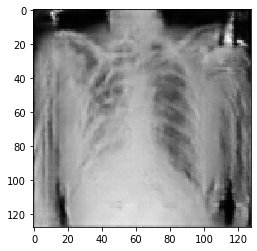

[46/51][0/236]	Loss_D: 0.4573	Loss_G: 2.0304	D(x): 0.9317	D(G(z)): 0.3084 / 0.1482
True


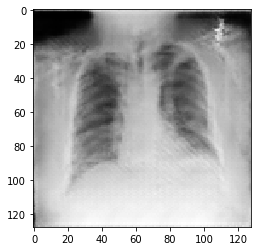

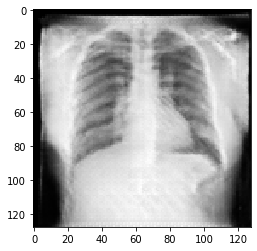

[46/51][20/236]	Loss_D: 0.2800	Loss_G: 4.7939	D(x): 0.7943	D(G(z)): 0.0094 / 0.0106
True


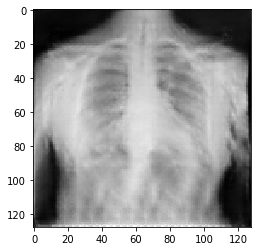

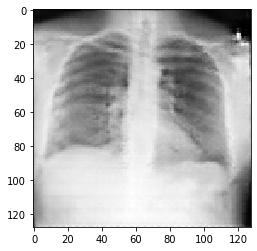

[46/51][40/236]	Loss_D: 0.3249	Loss_G: 2.6103	D(x): 0.7870	D(G(z)): 0.0725 / 0.0834
True


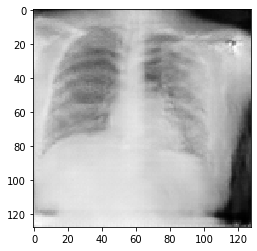

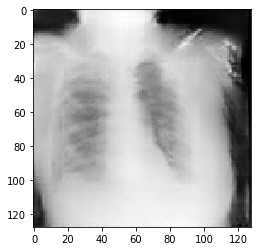

[46/51][60/236]	Loss_D: 0.2735	Loss_G: 3.2109	D(x): 0.9553	D(G(z)): 0.1945 / 0.0483
True


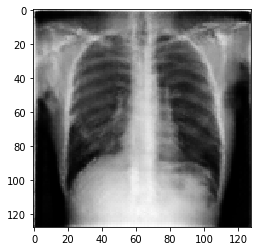

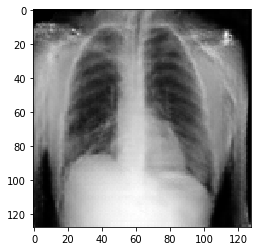

[46/51][80/236]	Loss_D: 0.5123	Loss_G: 2.4646	D(x): 0.7214	D(G(z)): 0.1484 / 0.1044
True


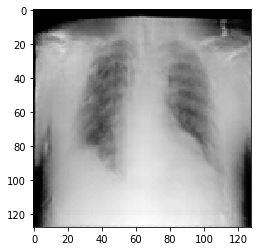

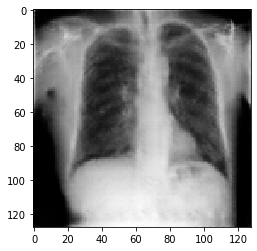

[46/51][100/236]	Loss_D: 0.2476	Loss_G: 4.3788	D(x): 0.8290	D(G(z)): 0.0502 / 0.0167
True


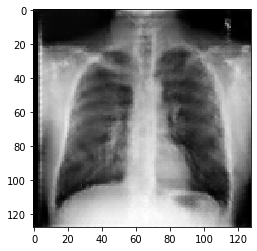

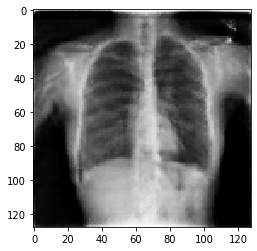

[46/51][120/236]	Loss_D: 0.8538	Loss_G: 3.7759	D(x): 0.9586	D(G(z)): 0.5370 / 0.0270
True


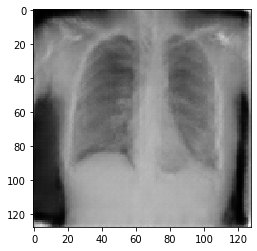

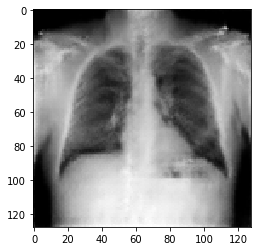

[46/51][140/236]	Loss_D: 0.6260	Loss_G: 1.8214	D(x): 0.8653	D(G(z)): 0.3664 / 0.1782
True


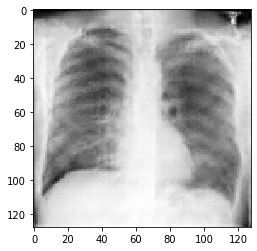

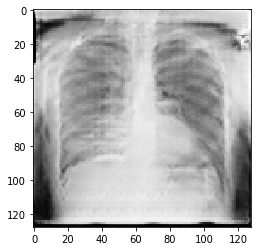

[46/51][160/236]	Loss_D: 0.5749	Loss_G: 2.1550	D(x): 0.7604	D(G(z)): 0.2358 / 0.1451
True


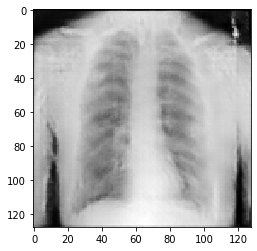

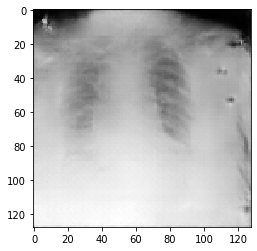

[46/51][180/236]	Loss_D: 0.6263	Loss_G: 2.8641	D(x): 0.8044	D(G(z)): 0.3139 / 0.0684
True


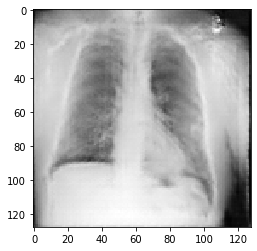

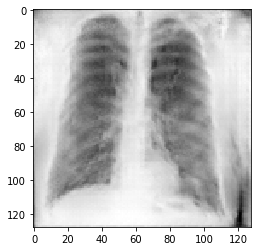

[46/51][200/236]	Loss_D: 1.4134	Loss_G: 3.2237	D(x): 0.8376	D(G(z)): 0.6823 / 0.0483
True


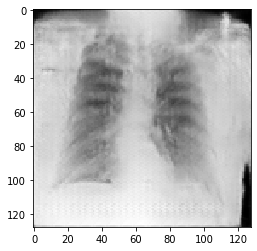

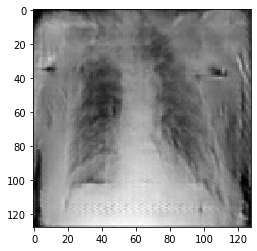

[46/51][220/236]	Loss_D: 0.6377	Loss_G: 2.6384	D(x): 0.9824	D(G(z)): 0.4432 / 0.0807



True


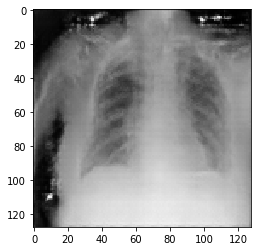

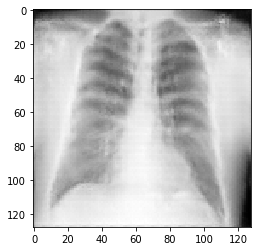

[47/51][0/236]	Loss_D: 0.8716	Loss_G: 2.9538	D(x): 0.8943	D(G(z)): 0.5114 / 0.0632
True


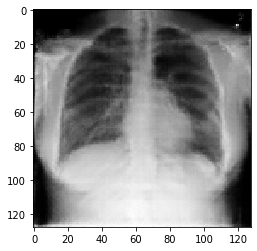

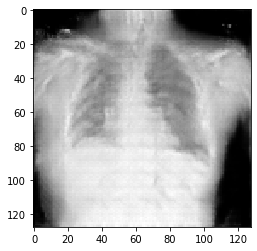

[47/51][20/236]	Loss_D: 2.3992	Loss_G: 2.0650	D(x): 0.1216	D(G(z)): 0.0254 / 0.1560
True


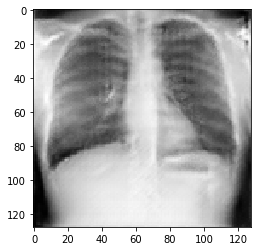

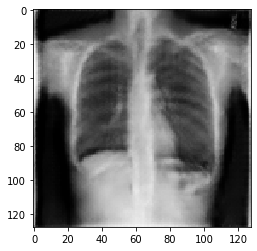

[47/51][40/236]	Loss_D: 0.3255	Loss_G: 3.2428	D(x): 0.8252	D(G(z)): 0.1106 / 0.0478
True


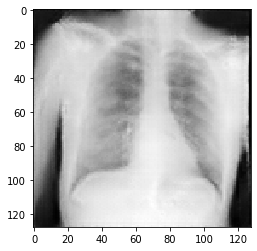

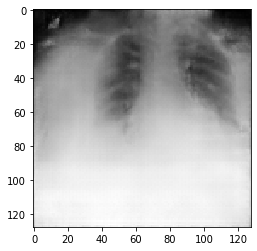

[47/51][60/236]	Loss_D: 0.4299	Loss_G: 2.7446	D(x): 0.8308	D(G(z)): 0.2074 / 0.0739
True


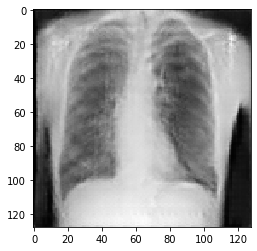

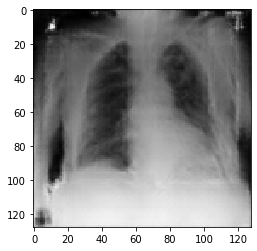

[47/51][80/236]	Loss_D: 0.2053	Loss_G: 4.1934	D(x): 0.8706	D(G(z)): 0.0571 / 0.0195
True


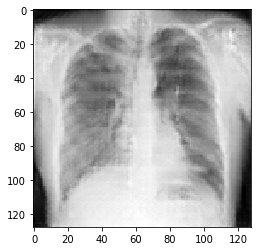

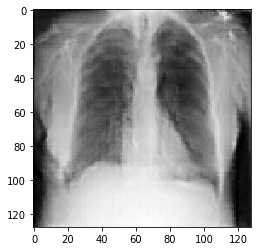

[47/51][100/236]	Loss_D: 0.3046	Loss_G: 2.6310	D(x): 0.8480	D(G(z)): 0.1223 / 0.0844
True


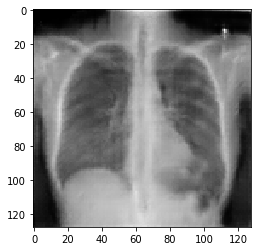

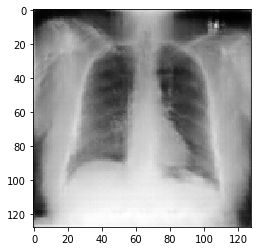

[47/51][120/236]	Loss_D: 0.6051	Loss_G: 3.4347	D(x): 0.5765	D(G(z)): 0.0174 / 0.0427
True


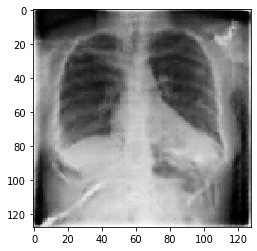

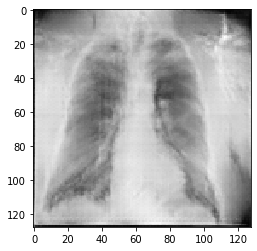

[47/51][140/236]	Loss_D: 0.1565	Loss_G: 2.4708	D(x): 0.9780	D(G(z)): 0.1236 / 0.0963
True


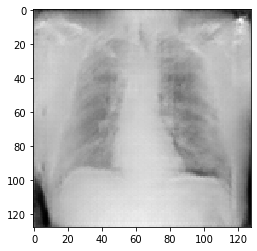

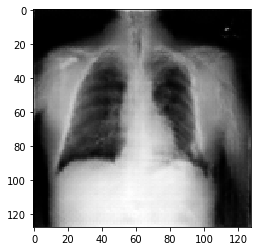

[47/51][160/236]	Loss_D: 1.0220	Loss_G: 1.1964	D(x): 0.3960	D(G(z)): 0.0252 / 0.3341
True


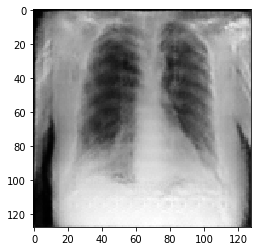

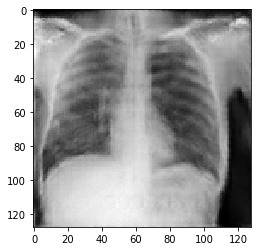

[47/51][180/236]	Loss_D: 1.1557	Loss_G: 0.8600	D(x): 0.4713	D(G(z)): 0.2746 / 0.4702
True


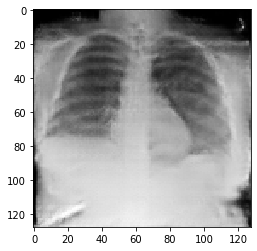

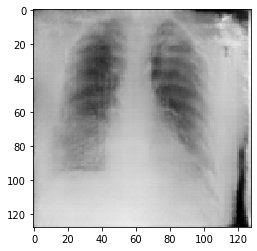

[47/51][200/236]	Loss_D: 0.2969	Loss_G: 2.8433	D(x): 0.8658	D(G(z)): 0.1343 / 0.0669
True


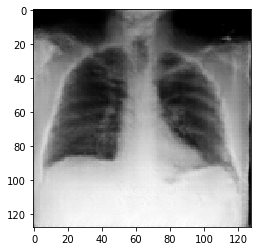

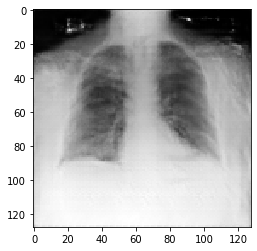

[47/51][220/236]	Loss_D: 0.4540	Loss_G: 1.6951	D(x): 0.7036	D(G(z)): 0.0795 / 0.2138



True


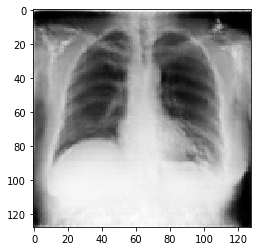

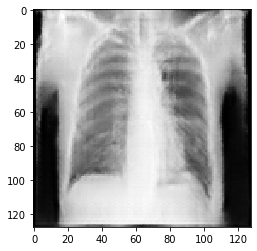

[48/51][0/236]	Loss_D: 0.3821	Loss_G: 2.7009	D(x): 0.8105	D(G(z)): 0.1500 / 0.0777
True


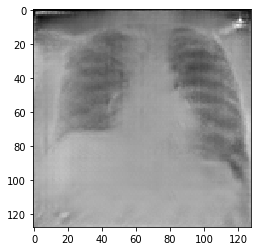

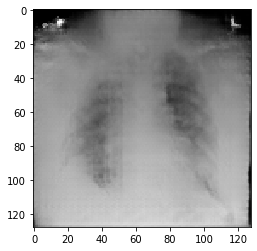

[48/51][20/236]	Loss_D: 0.6110	Loss_G: 1.8873	D(x): 0.6503	D(G(z)): 0.1433 / 0.1690
True


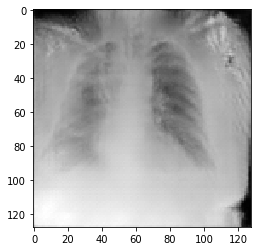

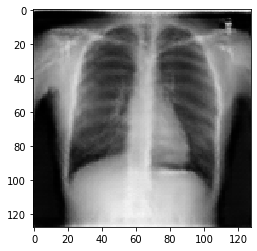

[48/51][40/236]	Loss_D: 0.4759	Loss_G: 2.2759	D(x): 0.8642	D(G(z)): 0.2692 / 0.1190
True


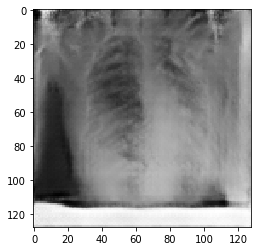

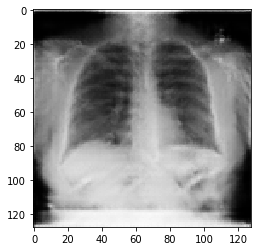

[48/51][60/236]	Loss_D: 1.9887	Loss_G: 2.0930	D(x): 0.9598	D(G(z)): 0.8382 / 0.1424
True


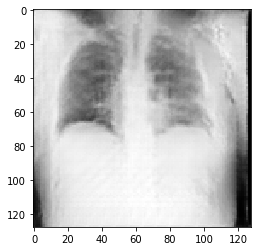

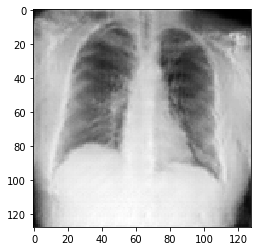

[48/51][80/236]	Loss_D: 1.5398	Loss_G: 2.2400	D(x): 0.2606	D(G(z)): 0.0356 / 0.1322
True


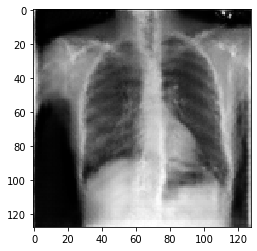

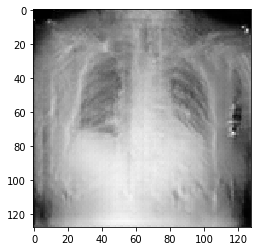

[48/51][100/236]	Loss_D: 0.4380	Loss_G: 2.3753	D(x): 0.6890	D(G(z)): 0.0437 / 0.1112
True


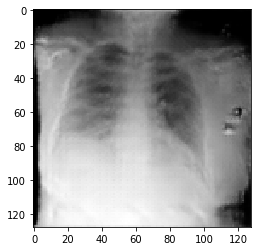

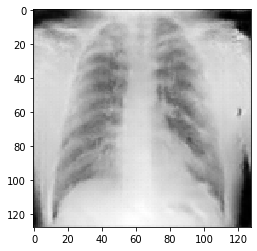

[48/51][120/236]	Loss_D: 2.3727	Loss_G: 0.8509	D(x): 0.1279	D(G(z)): 0.0695 / 0.4564
True


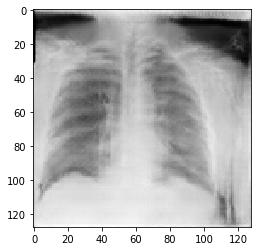

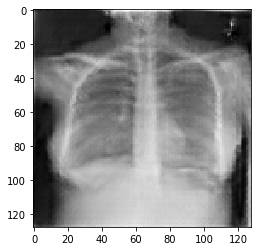

[48/51][140/236]	Loss_D: 1.2545	Loss_G: 1.5830	D(x): 0.3882	D(G(z)): 0.1732 / 0.2339
True


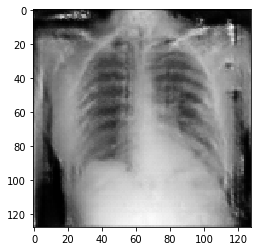

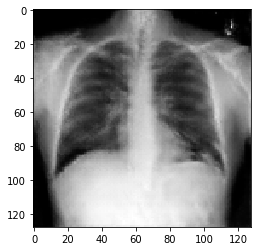

[48/51][160/236]	Loss_D: 1.9491	Loss_G: 2.5233	D(x): 0.9697	D(G(z)): 0.8228 / 0.0989
True


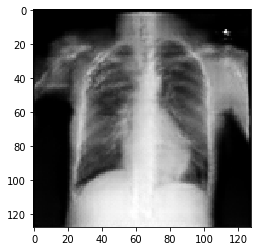

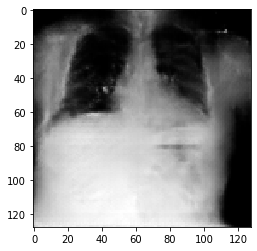

[48/51][180/236]	Loss_D: 0.9654	Loss_G: 2.7350	D(x): 0.7161	D(G(z)): 0.4406 / 0.0811
True


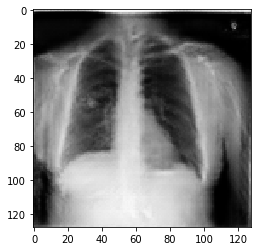

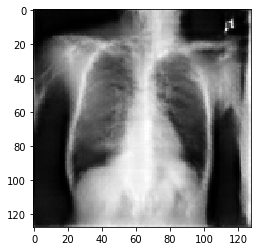

[48/51][200/236]	Loss_D: 0.4475	Loss_G: 1.9003	D(x): 0.7766	D(G(z)): 0.1620 / 0.1631
True


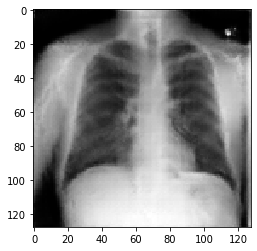

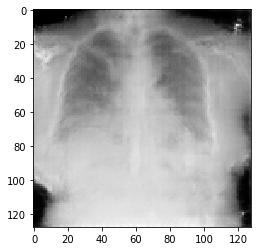

[48/51][220/236]	Loss_D: 1.3391	Loss_G: 2.0757	D(x): 0.8673	D(G(z)): 0.6641 / 0.1408



True


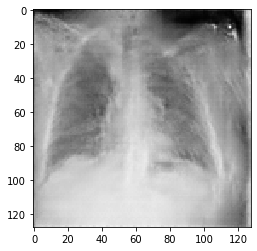

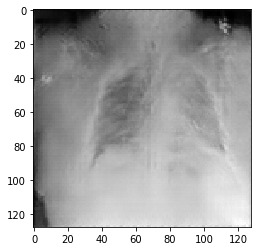

[49/51][0/236]	Loss_D: 0.9522	Loss_G: 1.9938	D(x): 0.4352	D(G(z)): 0.0504 / 0.1653
True


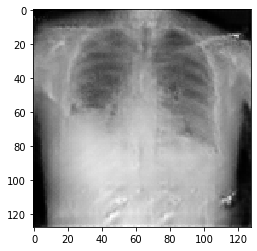

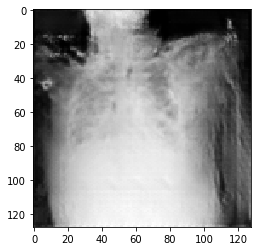

[49/51][20/236]	Loss_D: 0.7710	Loss_G: 1.3382	D(x): 0.5925	D(G(z)): 0.1791 / 0.2858
True


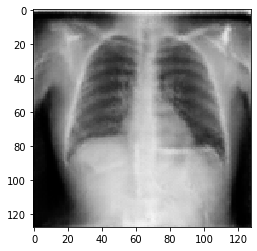

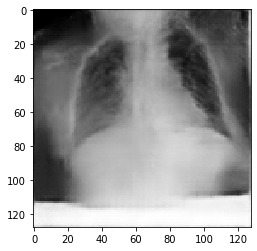

[49/51][40/236]	Loss_D: 1.6867	Loss_G: 1.8343	D(x): 0.2154	D(G(z)): 0.0056 / 0.1860
True


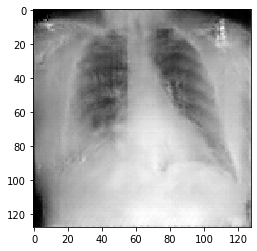

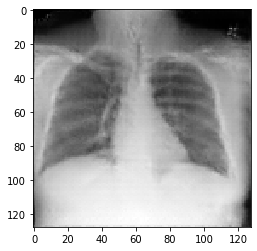

[49/51][60/236]	Loss_D: 1.3094	Loss_G: 3.3248	D(x): 0.9792	D(G(z)): 0.6917 / 0.0497
True


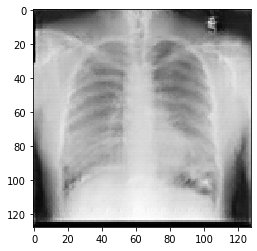

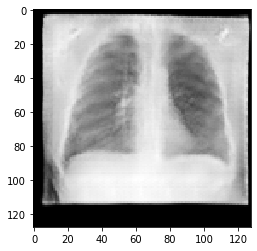

[49/51][80/236]	Loss_D: 0.8300	Loss_G: 2.4769	D(x): 0.8731	D(G(z)): 0.4773 / 0.0927
True


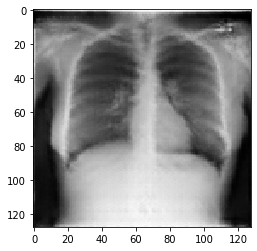

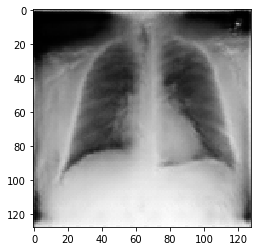

[49/51][100/236]	Loss_D: 0.7375	Loss_G: 2.4479	D(x): 0.8172	D(G(z)): 0.3936 / 0.1017
True


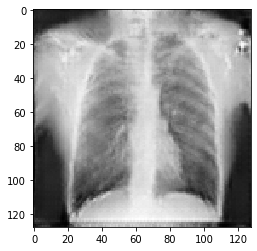

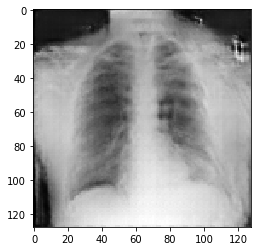

[49/51][120/236]	Loss_D: 1.0624	Loss_G: 1.3880	D(x): 0.3982	D(G(z)): 0.0742 / 0.2731
True


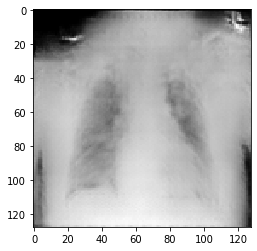

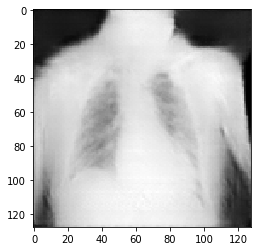

[49/51][140/236]	Loss_D: 0.8064	Loss_G: 2.9025	D(x): 0.9333	D(G(z)): 0.4940 / 0.0705
True


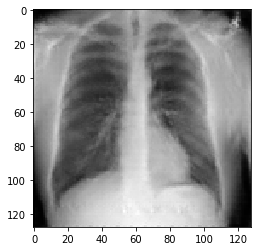

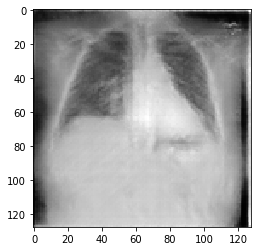

[49/51][160/236]	Loss_D: 1.2411	Loss_G: 1.6064	D(x): 0.5555	D(G(z)): 0.4419 / 0.2266
True


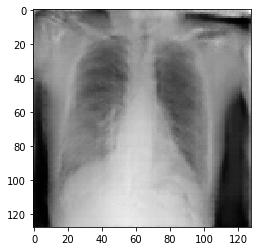

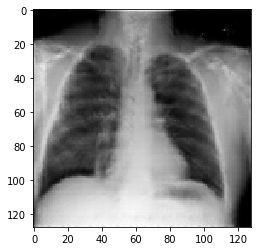

[49/51][180/236]	Loss_D: 0.2973	Loss_G: 2.5601	D(x): 0.8400	D(G(z)): 0.1065 / 0.0913
True


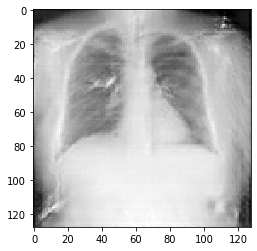

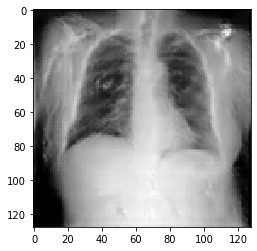

[49/51][200/236]	Loss_D: 0.8429	Loss_G: 2.3614	D(x): 0.9593	D(G(z)): 0.5144 / 0.1135
True


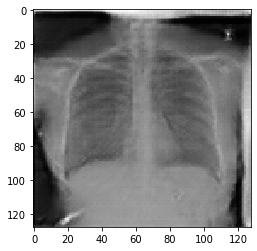

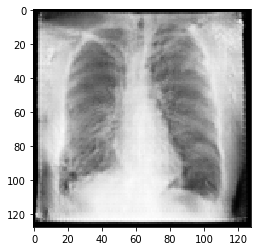

[49/51][220/236]	Loss_D: 0.8994	Loss_G: 2.4166	D(x): 0.8816	D(G(z)): 0.5086 / 0.1053



True


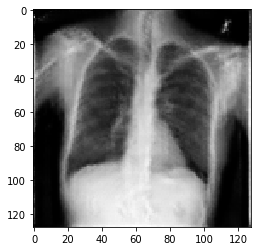

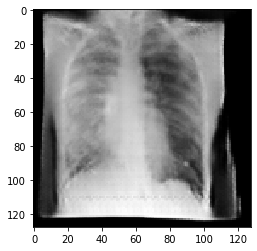

[50/51][0/236]	Loss_D: 0.4637	Loss_G: 2.4473	D(x): 0.8627	D(G(z)): 0.2596 / 0.1000
True


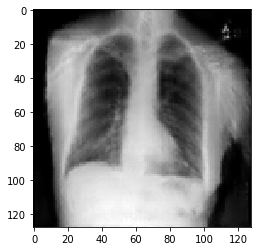

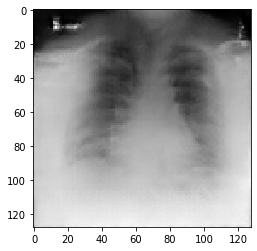

[50/51][20/236]	Loss_D: 0.5618	Loss_G: 1.9941	D(x): 0.6602	D(G(z)): 0.1132 / 0.1648
True


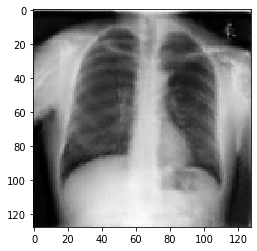

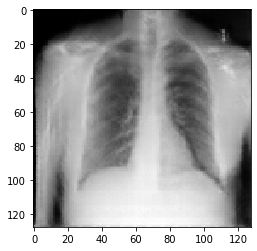

[50/51][40/236]	Loss_D: 0.3822	Loss_G: 3.0607	D(x): 0.7225	D(G(z)): 0.0391 / 0.0577
True


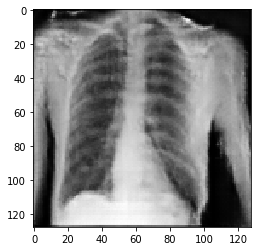

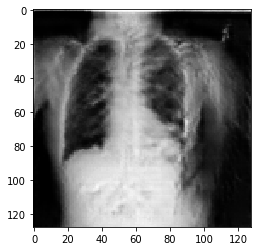

[50/51][60/236]	Loss_D: 0.4912	Loss_G: 1.9928	D(x): 0.7617	D(G(z)): 0.1830 / 0.1579
True


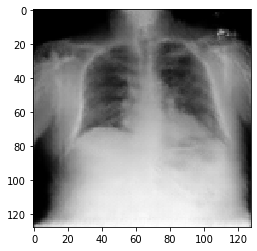

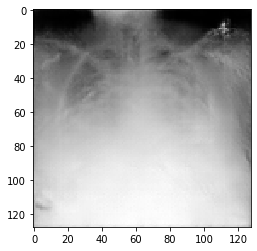

[50/51][80/236]	Loss_D: 1.0553	Loss_G: 1.1029	D(x): 0.4543	D(G(z)): 0.1790 / 0.3581
True


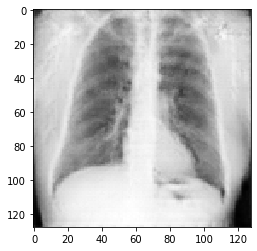

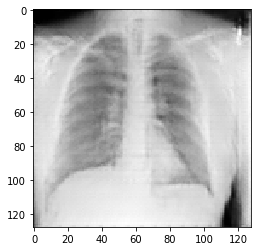

[50/51][100/236]	Loss_D: 0.2765	Loss_G: 2.3765	D(x): 0.9111	D(G(z)): 0.1631 / 0.1089
True


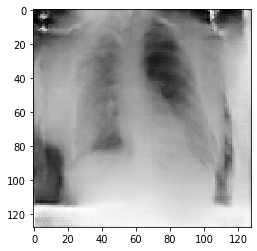

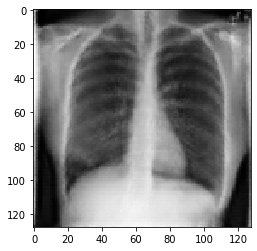

[50/51][120/236]	Loss_D: 1.0683	Loss_G: 1.5371	D(x): 0.4104	D(G(z)): 0.0952 / 0.2534
True


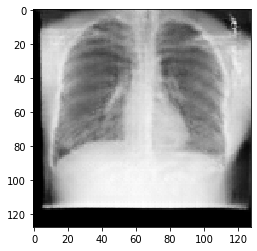

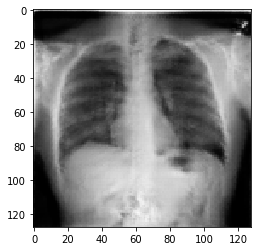

[50/51][140/236]	Loss_D: 0.6233	Loss_G: 1.6711	D(x): 0.7100	D(G(z)): 0.2153 / 0.2101
True


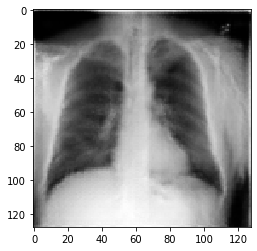

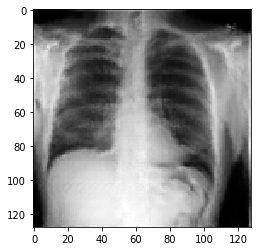

[50/51][160/236]	Loss_D: 0.8706	Loss_G: 2.2214	D(x): 0.6183	D(G(z)): 0.2853 / 0.1264
True


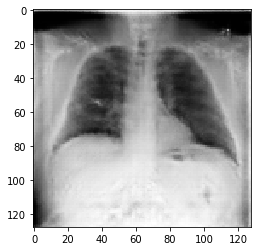

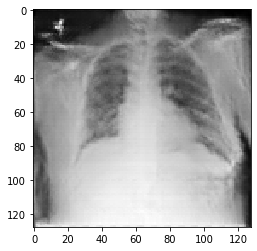

[50/51][180/236]	Loss_D: 0.5919	Loss_G: 1.7338	D(x): 0.7337	D(G(z)): 0.2310 / 0.1945
True


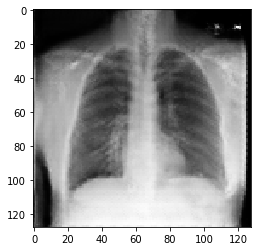

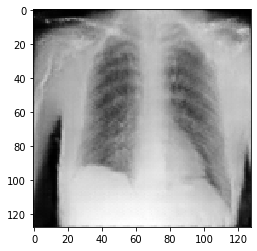

[50/51][200/236]	Loss_D: 0.5754	Loss_G: 1.7108	D(x): 0.7467	D(G(z)): 0.2174 / 0.2106
True


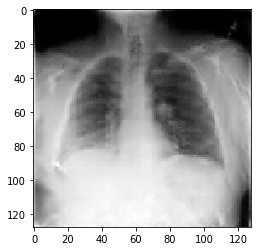

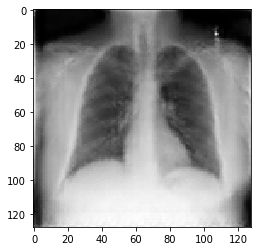

[50/51][220/236]	Loss_D: 0.4639	Loss_G: 2.3457	D(x): 0.8570	D(G(z)): 0.2356 / 0.1119



In [12]:
print("Starting Training Loop...")
print("-"*25)

for epoch in range(params['nepochs']):
    for i, data in tqdm(enumerate(dataloader, 0)):

        # Transfer data tensor to GPU/CPU (device)
        real_data = data.to(device)
        # Get batch size. Can be different from params['nbsize'] for last batch in epoch.
        b_size = real_data.size(0)
        
        # Make accumalated gradients of the discriminator zero.
        netD.zero_grad()
        # Create labels for the real data. (label=1)
        label = torch.full((b_size, ), real_label, device=device)
        output = netD(real_data)[0].view(-1)
        errD_real = criterion(output, label)
        # Calculate gradients for backpropagation.
        errD_real.backward()
        D_x = output.mean().item()
        
        # Sample random data from a unit normal distribution.
        noise = torch.randn(b_size, params['nz'], 1, 1, device=device)
        # Generate fake data (images).
        fake_data = netG(noise)
        # Create labels for fake data. (label=0)
        label.fill_(fake_label  )
        # Calculate the output of the discriminator of the fake data.
        # As no gradients w.r.t. the generator parameters are to be
        # calculated, detach() is used. Hence, only gradients w.r.t. the
        # discriminator parameters will be calculated.
        # This is done because the loss functions for the discriminator
        # and the generator are slightly different.
        output = netD(fake_data.detach())[0].view(-1)
        errD_fake = criterion(output, label)
        # Calculate gradients for backpropagation.
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        # Net discriminator loss.
        errD = errD_real + errD_fake
        # Update discriminator parameters.
        optimizerD.step()
        
        # Make accumalted gradients of the generator zero.
        netG.zero_grad()
        # We want the fake data to be classified as real. Hence
        # real_label are used. (label=1)
        label.fill_(real_label)
        # No detach() is used here as we want to calculate the gradients w.r.t.
        # the generator this time.
        output= netD(fake_data)[0].view(-1)
        errG = criterion(output, label)
        # Gradients for backpropagation are calculated.
        # Gradients w.r.t. both the generator and the discriminator
        # parameters are calculated, however, the generator's optimizer
        # will only update the parameters of the generator. The discriminator
        # gradients will be set to zero in the next iteration by netD.zero_grad()
        errG.backward()

        D_G_z2 = output.mean().item()
        # Update generator parameters.
        optimizerG.step()
        
        
        # Check progress of training.
        if i%20 == 0:
            print(torch.cuda.is_available())
            image_check(fake_data.cpu())
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, params['nepochs'], i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save the losses for plotting.
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on a fixed noise.
        if (iters % 100 == 0) or ((epoch == params['nepochs']-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake_data = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake_data, padding=2, normalize=True))

        iters += 1

    # Save the model.
    if epoch % params['save_epoch'] == 0:
        torch.save({
            'generator' : netG.state_dict(),
            'discriminator' : netD.state_dict(),
            'optimizerG' : optimizerG.state_dict(),
            'optimizerD' : optimizerD.state_dict(),
            'params' : params
            }, 'model/model.pth'.format(epoch))



# Inference

In [13]:

# load_model = torch.load('model/model.pth')
# netG.load_state_dict(load_model["generator"])
# netD.load_state_dict(load_model["discriminator"])
# optimizerG.load_state_dict(load_model["optimizerG"])
# optimizerD.load_state_dict(load_model["optimizerD"])

In [14]:
def Anomaly_score(x,G_z,Lambda=0.1):
    _,x_feature = netD(x)
    _,G_z_feature = netD(G_z)
    
    residual_loss = torch.sum(torch.abs(x-G_z))
    discrimination_loss = torch.sum(torch.abs(x_feature-G_z_feature))
    
    total_loss = (1-Lambda)*residual_loss + Lambda*discrimination_loss
    return total_loss

In [15]:

test_size = 1  #number of test samples

path_to_images = "/raid/urinbayev/yernur/XRay_Categories/Images/test_all/xrays/XR_CHEST"

dataset = dset.ImageFolder(root=path_to_images, transform=data_transforms)

In [16]:
test_data = torch.FloatTensor([dataset.__getitem__(i)[0].cpu().detach().numpy() for i in range(test_size)])

In [17]:
test_data, _ = dataset.__getitem__(21)
test_data = torch.FloatTensor([test_data.cpu().detach().numpy() for i in range(test_size)])

z = Variable(init.normal(torch.zeros(test_size,params['nz'], 1, 1),mean=0,std=0.1),requires_grad=True)
z_optimizer = torch.optim.Adam([z],lr=1e-4)
gen_fake = netG(z.cuda())
for i in tqdm(range(1000)):
    gen_fake = netG(z.cuda())
    loss = Anomaly_score(Variable(test_data).cuda(),gen_fake,Lambda=0.1)
    loss.backward()
    z_optimizer.step()

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.normal is now deprecated in favor of nn.init.normal_.
  after removing the cwd from sys.path.


3793.1552734375


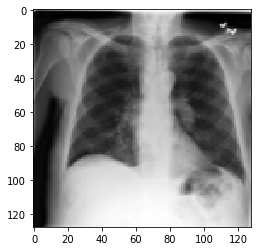

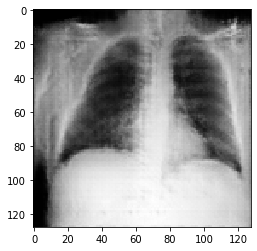

In [18]:
print(loss.item())

z_optimizer.zero_grad()
target = test_data[0,0,:,:].numpy()
plt.imshow(target,cmap="gray")
plt.show()

img=gen_fake.cpu().data[0,0,:,:].numpy()
plt.imshow(img,cmap='gray')
plt.show()